<a href="https://colab.research.google.com/github/Starlight0901/Adult-Census-Income-Prediction/blob/main/HCHO_Emission_Analysis_and_Prediction_using_Pandas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Load libraries and dataset**

In [ ]:
!pip install geopy

In [ ]:
from google.colab import drive
import pandas as pd
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Mount Google Drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Define the file paths
col_mat_nuw_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/col_mat_nuw_output.csv'
mon_kur_jaf_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/mon_kur_jaf_output.csv'
kan_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/kan_output.csv'

# Load the CSV files using Pandas
col_mat_nuw_df = pd.read_csv(col_mat_nuw_file)
mon_kur_jaf_df = pd.read_csv(mon_kur_jaf_file)
kan_df = pd.read_csv(kan_file)

# **1. Data Pre-Processing**

## **Descriptive Data Analysis**

In [ ]:
print('Rows: {} Columns: {}'.format(col_mat_nuw_df.shape[0], col_mat_nuw_df.shape[1]))
col_mat_nuw_df.head()

Rows: 5477 Columns: 4


,0.00019698343957810148,Colombo Proper,2019-01-01,2019-01-02
0,0.000263,Colombo Proper,2019-01-02,2019-01-03
1,0.000099,Colombo Proper,2019-01-03,2019-01-04
2,0.000210,Colombo Proper,2019-01-04,2019-01-05
3,0.000179,Colombo Proper,2019-01-05,2019-01-06
4,0.000108,Colombo Proper,2019-01-06,2019-01-07


In [ ]:
print('Rows: {} Columns: {}'.format(mon_kur_jaf_df.shape[0], mon_kur_jaf_df.shape[1]))
mon_kur_jaf_df.head()

Rows: 5477 Columns: 4


,Unnamed: 0,"Bibile, Monaragala",2019-01-01,2019-01-02
0,0.000019,"Bibile, Monaragala",2019-01-02,2019-01-03
1,0.000028,"Bibile, Monaragala",2019-01-03,2019-01-04
2,0.000037,"Bibile, Monaragala",2019-01-04,2019-01-05
3,-0.000018,"Bibile, Monaragala",2019-01-05,2019-01-06
4,0.000146,"Bibile, Monaragala",2019-01-06,2019-01-07


In [ ]:
print('Rows: {} Columns: {}'.format(kan_df.shape[0], kan_df.shape[1]))
kan_df.head()

Rows: 1825 Columns: 4


,0.00017607134598773356,Kandy Proper,2019-01-01,2019-01-02
0,0.000092,Kandy Proper,2019-01-02,2019-01-03
1,NaN,Kandy Proper,2019-01-03,2019-01-04
2,0.000191,Kandy Proper,2019-01-04,2019-01-05
3,0.000122,Kandy Proper,2019-01-05,2019-01-06
4,-0.000065,Kandy Proper,2019-01-06,2019-01-07


In [ ]:
print("Colombo, Matara, Nuwara Eliya areas data info \n")
col_mat_nuw_df.info()
print("\n Monaragala, Kurunegala, Jaffna areas data info \n")
mon_kur_jaf_df.info()
print("\n Kandy data info \n")
kan_df.info()

Colombo, Matara, Nuwara Eliya areas data info 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5477 entries, 0 to 5476
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   0.00019698343957810148  3058 non-null   float64
 1   Colombo Proper          5477 non-null   object 
 2   2019-01-01              5477 non-null   object 
 3   2019-01-02              5477 non-null   object 
dtypes: float64(1), object(3)
memory usage: 171.3+ KB

 Monaragala, Kurunegala, Jaffna areas data info 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5477 entries, 0 to 5476
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Unnamed: 0          3826 non-null   float64
 1   Bibile, Monaragala  5477 non-null   object 
 2   2019-01-01          5477 non-null   object 
 3   2019-01-02          5477 non-null   object 
dtypes: float64(1), obj

In [ ]:
col_mat_nuw_df.describe().T

,count,mean,std,min,25%,50%,75%,max
0.00019698343957810148,3058.0,0.00012,0.000101,-0.000259,0.000053,0.000111,0.000176,0.0009


In [ ]:
mon_kur_jaf_df.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,3826.0,0.000122,0.000087,-0.000352,0.000068,0.000114,0.000172,0.000584


In [ ]:
kan_df.describe().T

,count,mean,std,min,25%,50%,75%,max
0.00017607134598773356,1032.0,0.000106,0.000092,-0.0003,0.00005,0.000106,0.000161,0.000705


In [ ]:
# check for null values in the dataset that consist of colombo, matara, nuwara eliya.
null_counts_1 = col_mat_nuw_df.isnull().sum()
# check for null values in the dataset that consist of Monaragala, Kurunegala, Jaffna.
null_counts_2 = mon_kur_jaf_df.isnull().sum()
# check for null values in the dataset that consist of Kandy
null_counts_3 = kan_df.isnull().sum()

print(null_counts_1, "\n")
print(null_counts_2, "\n")
print(null_counts_3, "\n")

0.00019698343957810148    2419
Colombo Proper               0
2019-01-01                   0
2019-01-02                   0
dtype: int64 

Unnamed: 0            1651
Bibile, Monaragala       0
2019-01-01               0
2019-01-02               0
dtype: int64 

0.00017607134598773356    793
Kandy Proper                0
2019-01-01                  0
2019-01-02                  0
dtype: int64 



In [ ]:
# check for duplicates

duplicate_rows_col_mat_nuw = col_mat_nuw_df.duplicated()
duplicate_rows_mon_kur_jaf = mon_kur_jaf_df.duplicated()
duplicate_rows_kandy = kan_df.duplicated()

print("Duplicates in the dataset that consist of colombo, matara, nuwara eliya data: ", duplicate_rows_col_mat_nuw.sum())
print("Duplicates in the dataset that consist of monaragala, kurunegala, jaffna data: ", duplicate_rows_mon_kur_jaf.sum())
print("Duplicates in the dataset that consist of kandy data: ", duplicate_rows_kandy.sum())


Duplicates in the dataset that consist of colombo, matara, nuwara eliya data:  0
Duplicates in the dataset that consist of monaragala, kurunegala, jaffna data:  0
Duplicates in the dataset that consist of kandy data:  0


### **Observations**



*   Format inconsistencies were identified:
        -- Columns are not named
        -- Date should be checked if all are in the same format and changed to datetime datatype
        -- 3 different dataframes need to merged into one dataframe for the ease of analysis accross the entire dataset

*   All 3 datasets contain null values

*   No duplicates were identified





### Handling format inconsistencies

Add column names

In [ ]:
# Define the new column names
column_names = ["HCHO reading", "Location", "Current Date", "Next Date"]

# Set the column names of the DataFrame
col_mat_nuw_df.columns = column_names
mon_kur_jaf_df.columns = column_names
kan_df.columns = column_names

In [ ]:
print("\n Colombo, Matara, Nuwara eliya: ")
print(col_mat_nuw_df.head())

print("\n Monaragala, Kurunegala, Jaffna: ")
print(mon_kur_jaf_df.head())

print("\n Kandy:")
print(kan_df.head())


 Colombo, Matara, Nuwara eliya: 
   HCHO reading        Location Current Date   Next Date
0      0.000263  Colombo Proper   2019-01-02  2019-01-03
1      0.000099  Colombo Proper   2019-01-03  2019-01-04
2      0.000210  Colombo Proper   2019-01-04  2019-01-05
3      0.000179  Colombo Proper   2019-01-05  2019-01-06
4      0.000108  Colombo Proper   2019-01-06  2019-01-07

 Monaragala, Kurunegala, Jaffna: 
   HCHO reading            Location Current Date   Next Date
0      0.000019  Bibile, Monaragala   2019-01-02  2019-01-03
1      0.000028  Bibile, Monaragala   2019-01-03  2019-01-04
2      0.000037  Bibile, Monaragala   2019-01-04  2019-01-05
3     -0.000018  Bibile, Monaragala   2019-01-05  2019-01-06
4      0.000146  Bibile, Monaragala   2019-01-06  2019-01-07

 Kandy:
   HCHO reading      Location Current Date   Next Date
0      0.000092  Kandy Proper   2019-01-02  2019-01-03
1           NaN  Kandy Proper   2019-01-03  2019-01-04
2      0.000191  Kandy Proper   2019-01-04  2019-

Change the date into datetime format

In [ ]:
# Convert the column to datetime
col_mat_nuw_df["Current Date"] = pd.to_datetime(col_mat_nuw_df["Current Date"], errors='coerce')
col_mat_nuw_df["Next Date"] = pd.to_datetime(col_mat_nuw_df["Next Date"], errors='coerce')

# Check for Null values in the converted column
if col_mat_nuw_df["Current Date"].isnull().any() | col_mat_nuw_df["Next Date"].isnull().any():
    print("Inconsistent date formats found.")
else:
    print("All dates are in the same format.")

col_mat_nuw_df.head()

All dates are in the same format.


,HCHO reading,Location,Current Date,Next Date
0,0.000263,Colombo Proper,2019-01-02,2019-01-03
1,0.000099,Colombo Proper,2019-01-03,2019-01-04
2,0.000210,Colombo Proper,2019-01-04,2019-01-05
3,0.000179,Colombo Proper,2019-01-05,2019-01-06
4,0.000108,Colombo Proper,2019-01-06,2019-01-07


In [ ]:
# Convert the column to datetime
mon_kur_jaf_df["Current Date"] = pd.to_datetime(mon_kur_jaf_df["Current Date"], errors='coerce')
mon_kur_jaf_df["Next Date"] = pd.to_datetime(mon_kur_jaf_df["Next Date"], errors='coerce')

# Check for Null values in the converted column
if mon_kur_jaf_df["Current Date"].isnull().any() | mon_kur_jaf_df["Next Date"].isnull().any():
    print("Inconsistent date formats found.")
else:
    print("All dates are in the same format.")

mon_kur_jaf_df.head()

All dates are in the same format.


,HCHO reading,Location,Current Date,Next Date
0,0.000019,"Bibile, Monaragala",2019-01-02,2019-01-03
1,0.000028,"Bibile, Monaragala",2019-01-03,2019-01-04
2,0.000037,"Bibile, Monaragala",2019-01-04,2019-01-05
3,-0.000018,"Bibile, Monaragala",2019-01-05,2019-01-06
4,0.000146,"Bibile, Monaragala",2019-01-06,2019-01-07


In [ ]:
# Convert the column to datetime
kan_df["Current Date"] = pd.to_datetime(kan_df["Current Date"], errors='coerce')
kan_df["Next Date"] = pd.to_datetime(kan_df["Next Date"], errors='coerce')

# Check for Null values in the converted column
if kan_df["Current Date"].isnull().any() | kan_df["Next Date"].isnull().any():
    print("Inconsistent date formats found.")
else:
    print("All dates are in the same format.")

kan_df.head()

All dates are in the same format.


,HCHO reading,Location,Current Date,Next Date
0,0.000092,Kandy Proper,2019-01-02,2019-01-03
1,NaN,Kandy Proper,2019-01-03,2019-01-04
2,0.000191,Kandy Proper,2019-01-04,2019-01-05
3,0.000122,Kandy Proper,2019-01-05,2019-01-06
4,-0.000065,Kandy Proper,2019-01-06,2019-01-07


Merge the 3 datasets into one dataframe for the ease of statistical and exploratory data analysis

In [ ]:
combined_df = pd.concat([col_mat_nuw_df, mon_kur_jaf_df, kan_df], axis=0)

print('Rows: {} Columns: {}'.format(combined_df.shape[0], combined_df.shape[1]))
combined_df.head()

Rows: 12779 Columns: 4


,HCHO reading,Location,Current Date,Next Date
0,0.000263,Colombo Proper,2019-01-02,2019-01-03
1,0.000099,Colombo Proper,2019-01-03,2019-01-04
2,0.000210,Colombo Proper,2019-01-04,2019-01-05
3,0.000179,Colombo Proper,2019-01-05,2019-01-06
4,0.000108,Colombo Proper,2019-01-06,2019-01-07


### Handling Null values

In [ ]:
# check for null values in the dataset
null_counts = combined_df.isnull().sum()

print(null_counts)

HCHO reading    4863
Location           0
Current Date       0
Next Date          0
dtype: int64


In [ ]:
combined_df['HCHO reading'] = combined_df.groupby('Location')['HCHO reading'].transform(lambda x: x.interpolate(method='linear'))
combined_df.head()

,HCHO reading,Location,Current Date,Next Date
0,0.000263,Colombo Proper,2019-01-02,2019-01-03
1,0.000099,Colombo Proper,2019-01-03,2019-01-04
2,0.000210,Colombo Proper,2019-01-04,2019-01-05
3,0.000179,Colombo Proper,2019-01-05,2019-01-06
4,0.000108,Colombo Proper,2019-01-06,2019-01-07


In [ ]:
# check for null values in the dataset
new_null_rows = combined_df.isnull().any(axis=1)
print("Remaining missing values: ", new_null_rows.sum())

combined_df[new_null_rows]

Remaining missing values:  3


,HCHO reading,Location,Current Date,Next Date
1825,NaN,"Deniyaya, Matara",2019-01-01,2019-01-02
3651,NaN,Nuwara Eliya Proper,2019-01-01,2019-01-02
3652,NaN,Nuwara Eliya Proper,2019-01-02,2019-01-03


In [ ]:
combined_df['HCHO reading'] = combined_df.groupby('Location')['HCHO reading'].transform(lambda x: x.ffill().bfill())
# check for null values in the dataset
null_rows = combined_df.isnull()
print(null_rows.sum())

HCHO reading    0
Location        0
Current Date    0
Next Date       0
dtype: int64


## **Statistical Data Analysis**

In [ ]:
# summary statistics on the whole dataset

combined_df["HCHO reading"].describe()

count    12779.000000
mean         0.000111
std          0.000088
min         -0.000352
25%          0.000056
50%          0.000103
75%          0.000161
max          0.000900
Name: HCHO reading, dtype: float64

In [ ]:
print("Median: ", combined_df["HCHO reading"].median())

Median:  0.0001033480740311


Summary statistics for each city seperately

In [ ]:
summary_statistics = combined_df.groupby("Location")["HCHO reading"].describe()
print("Summary statistics for each city:")
summary_statistics

Summary statistics for each city:


,count,mean,std,min,25%,50%,75%,max
Location,,,,,,,,
"Bibile, Monaragala",1825.0,0.000120,0.000089,-0.000239,0.000061,0.000116,0.000176,0.000535
Colombo Proper,1825.0,0.000154,0.000095,-0.000229,0.000092,0.000144,0.000212,0.000650
"Deniyaya, Matara",1826.0,0.000093,0.000091,-0.000259,0.000037,0.000082,0.000137,0.000900
Jaffna Proper,1826.0,0.000107,0.000077,-0.000352,0.000061,0.000099,0.000144,0.000584
Kandy Proper,1825.0,0.000099,0.000086,-0.000300,0.000047,0.000095,0.000148,0.000705
Kurunegala Proper,1826.0,0.000124,0.000083,-0.000157,0.000071,0.000115,0.000173,0.000503
Nuwara Eliya Proper,1826.0,0.000082,0.000075,-0.000179,0.000034,0.000076,0.000127,0.000419


In [ ]:
# range of HCHO in the whole dataset
print("Range: ", combined_df["HCHO reading"].max() - combined_df["HCHO reading"].min())

Range:  0.001252183208101


In [ ]:
# range of HCHO readings in each city
range = combined_df.groupby("Location")["HCHO reading"].max() - combined_df.groupby("Location")["HCHO reading"].min()
print("range of HCHO readings in each city:")
range

range of HCHO readings in each city:


Location
Bibile, Monaragala     0.000774
Colombo Proper         0.000879
Deniyaya, Matara       0.001159
Jaffna Proper          0.000936
Kandy Proper           0.001005
Kurunegala Proper      0.000660
Nuwara Eliya Proper    0.000598
Name: HCHO reading, dtype: float64

In [ ]:
df_copy = combined_df.copy()

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Apply label encoding to the 'Location' column in the copy of the dataframe
df_copy['Location'] = label_encoder.fit_transform(df_copy['Location'])

In [ ]:
# covariance matrix on seperate cities
def calculate_covariance(x):
    return x['HCHO reading'].cov()

covariance_matrix_city = df_copy.groupby('Location').cov()

# Extract the covariance matrix for the 'HCHO reading' column
hcho_covariance = covariance_matrix_city.loc[:, ('HCHO reading', 'HCHO reading')]

hcho_covariance

HCHO reading  HCHO reading
Location                                         
0        HCHO reading  7.994401e-09  7.994401e-09
         Current Date  1.019428e+11  1.019428e+11
         Next Date     1.019428e+11  1.019428e+11
1        HCHO reading  8.930708e-09  8.930708e-09
         Current Date -3.086813e+11 -3.086813e+11
         Next Date    -3.086813e+11 -3.086813e+11
2        HCHO reading  8.305440e-09  8.305440e-09
         Current Date -1.755598e+11 -1.755598e+11
         Next Date    -1.755598e+11 -1.755598e+11
3        HCHO reading  5.980765e-09  5.980765e-09
         Current Date -8.566097e+10 -8.566097e+10
         Next Date    -8.566097e+10 -8.566097e+10
4        HCHO reading  7.456766e-09  7.456766e-09
         Current Date -2.371097e+11 -2.371097e+11
         Next Date    -2.371097e+11 -2.371097e+11
5        HCHO reading  6.848213e-09  6.848213e-09
         Current Date -2.829021e+11 -2.829021e+11
         Next Date    -2.829021e+11 -2.829021e+11
6        HCHO reading  5.554540e-09  5.554540e-09
         Current Date -1.156073e+11 -1.156073e+11
         Next Date    -1.156073e+11 -1.156073e+11

### **Observations**

- **"HCHO reading" Summary:**
    - Mean and median are similar, indicating a roughly symmetrical data distribution.
    - Small range around zero (-0.000352 to 0.000900) suggests limited data spread.
    - Moderate variability in the data with a standard deviation of 0.000088.
    - Data is clustered around the median, as shown by the narrow interquartile range.

- **Location based "HCHO reading" Summary:**
    - Mean HCHO readings vary across locations, suggesting different levels of air quality in each city.
    - Standard deviation varies by location, reflecting different degrees of data spread.
    - Minimum and maximum values show ranges of both negative and positive HCHO readings in each city.
    - Quartile ranges indicate varying data distribution and spread within each city.

- **Range of HCHO readings in cities:**
    - Higher ranges in cities like Deniyaya, Matara, and Kandy Proper suggest fluctuations in air quality.
    - Lower ranges in cities like Nuwara Eliya Proper imply more stable air quality.

- **Covariance Matrix:**
    - Low variance in 'HCHO reading' values across different locations.
    - High covariance between 'Current Date' and 'Next Date' with 'HCHO reading' suggests a strong linear relationship.

## **Exploratory Data Analysis**

### **Analysis on the entire dataset**

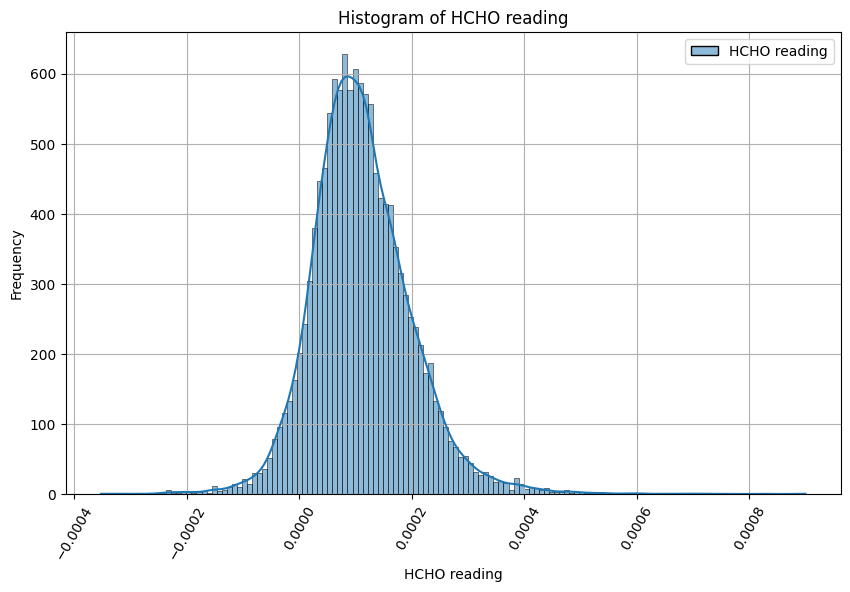

In [ ]:
# @title Histogram for HCHO Levels

plt.figure(figsize=(10, 6))
sns.histplot(data=combined_df, kde=True)
#df[column].hist()
plt.title('Histogram of HCHO reading')
plt.xlabel('HCHO reading')
plt.ylabel('Frequency')
plt.xticks(rotation=60)
plt.grid(True)
plt.show()

### **Analysis on each location in the dataset**

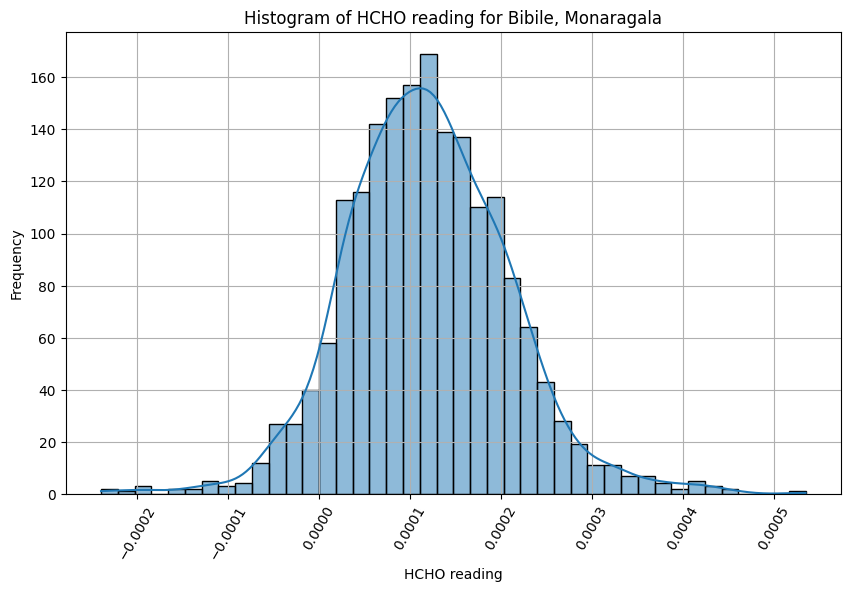

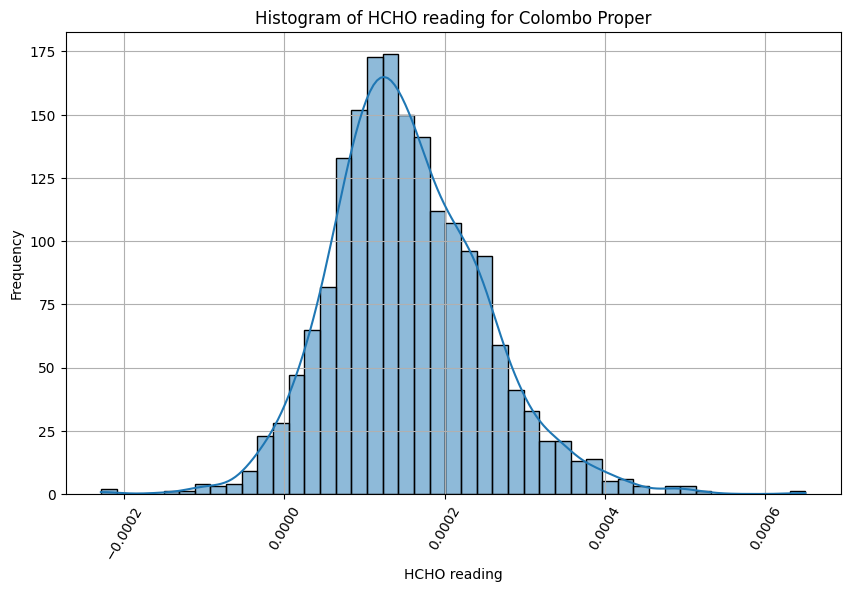

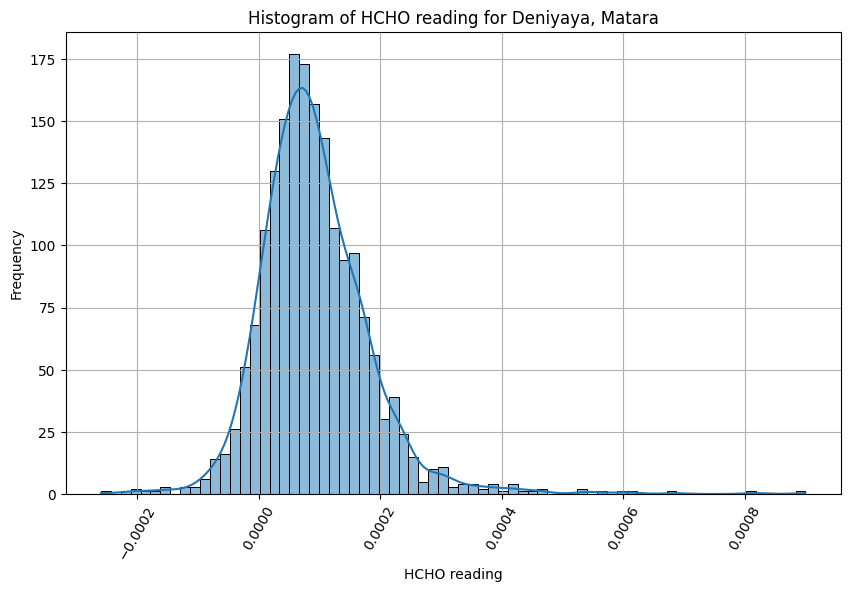

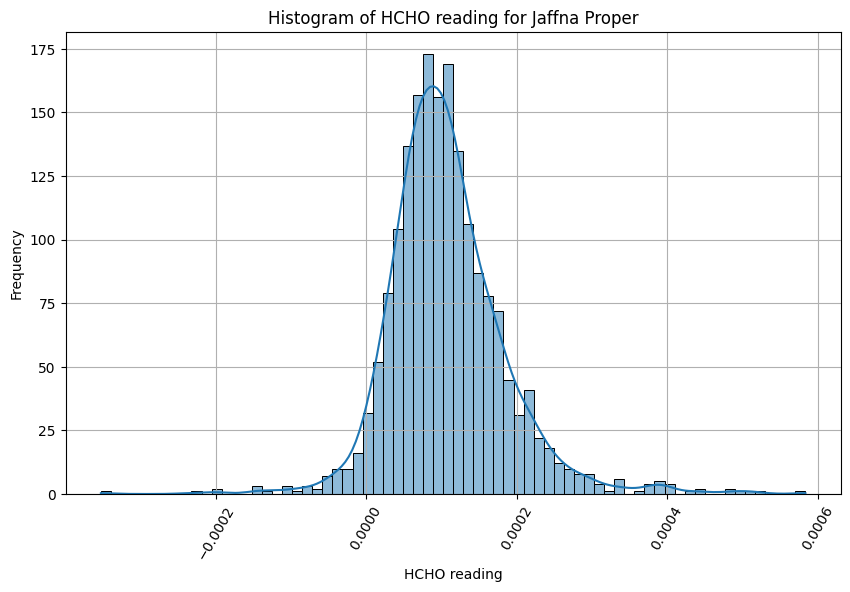

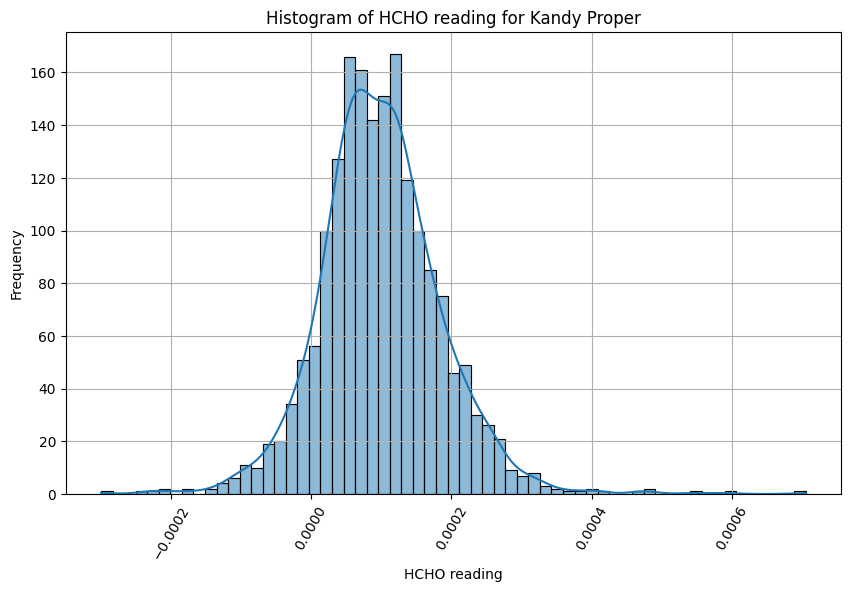

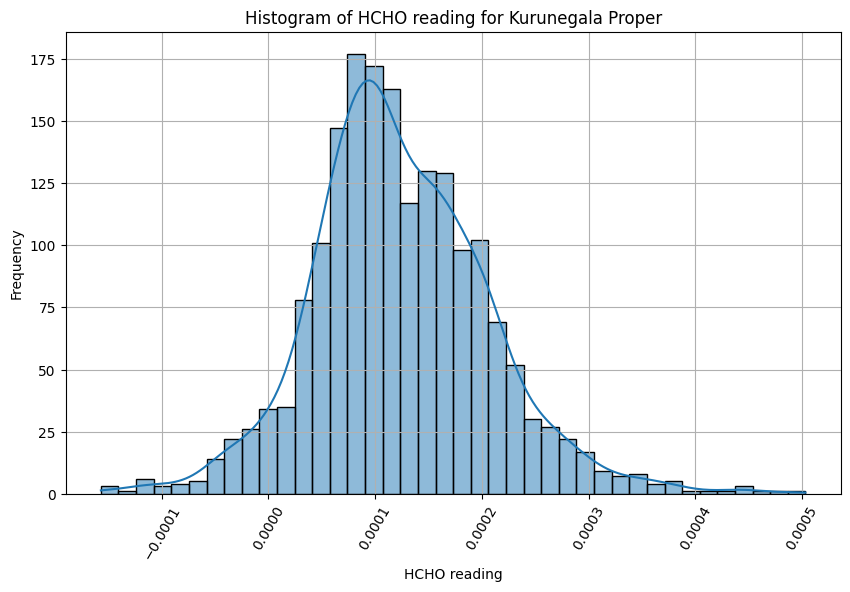

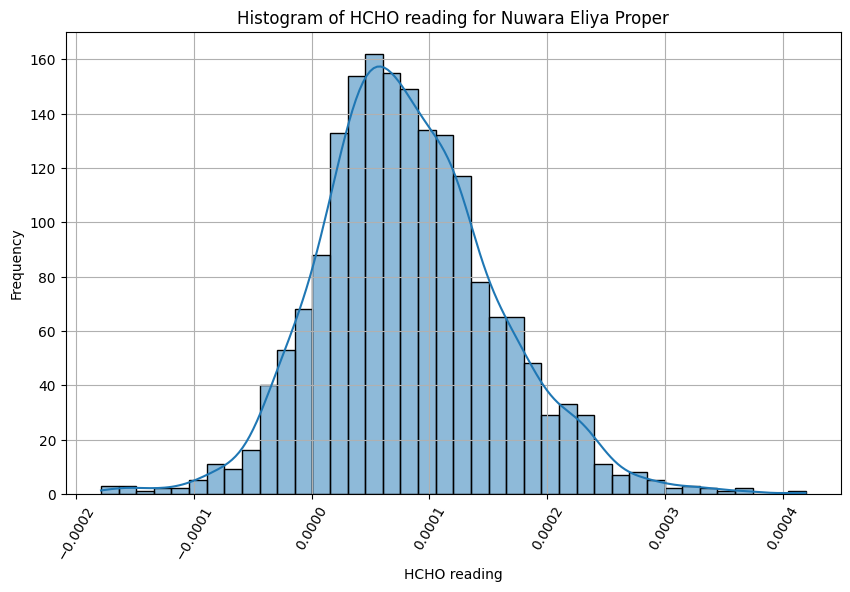

In [ ]:
# @title Histogram for HCHO Levels for each location
combined_df = combined_df.reset_index(drop=True)
grouped = combined_df.groupby('Location')

for location, group_data in grouped:
    plt.figure(figsize=(10, 6))
    sns.histplot(data=group_data, x='HCHO reading', kde=True)
    #df[column].hist()
    plt.title(f'Histogram of HCHO reading for {location}')
    plt.xlabel('HCHO reading')
    plt.ylabel('Frequency')
    plt.xticks(rotation=60)
    plt.grid(True)
    plt.show()

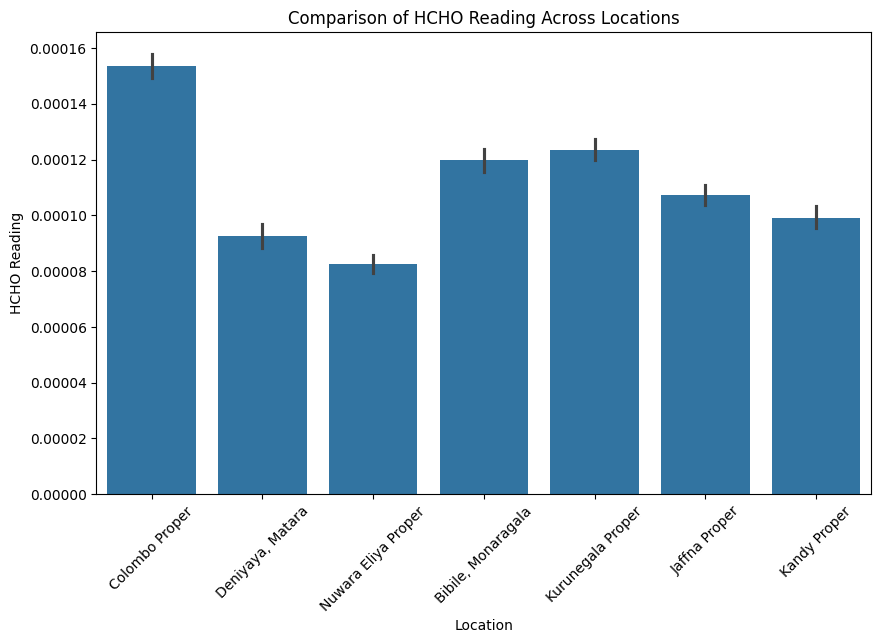

In [ ]:
# A bar chart comparing HCHO readings across locations
plt.figure(figsize=(10, 6))
sns.barplot(x='Location', y='HCHO reading', data = combined_df)
plt.title('Comparison of HCHO Reading Across Locations')
plt.xlabel('Location')
plt.ylabel('HCHO Reading')
plt.xticks(rotation=45)
plt.show()

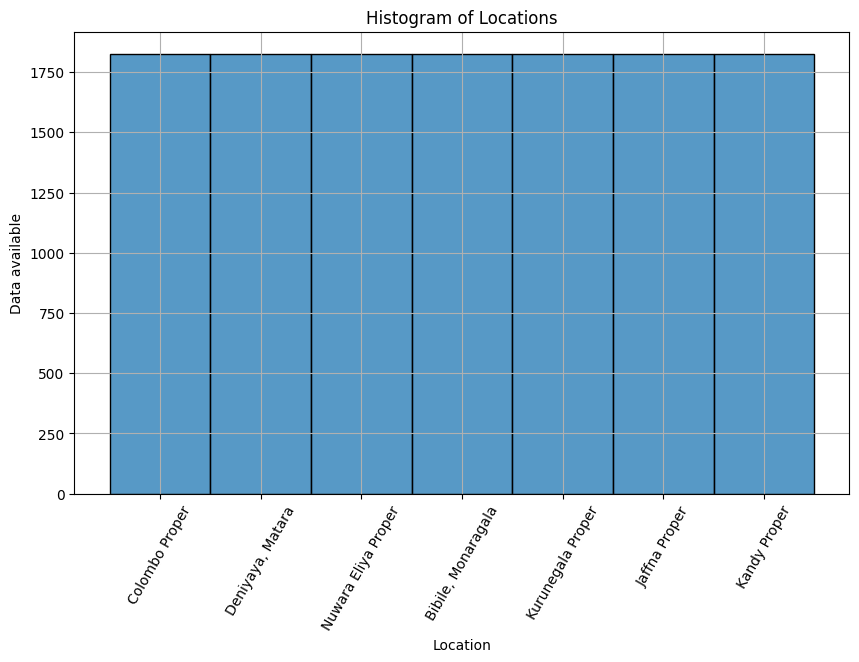

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(data=combined_df, x='Location')
plt.title(f'Histogram of Locations')
plt.xlabel('Location')
plt.ylabel('Data available')
plt.xticks(rotation=60)
plt.grid(True)
plt.show()

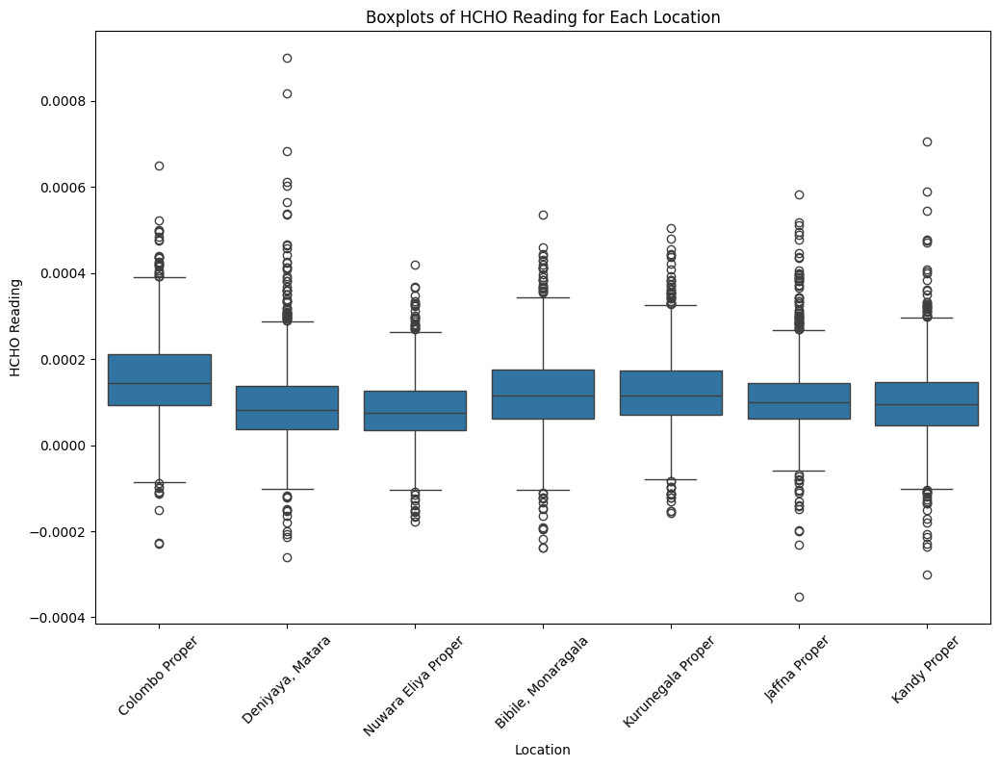

In [ ]:
# Create a boxplot for each location
plt.figure(figsize=(12, 8))
sns.boxplot(x='Location', y='HCHO reading', data=combined_df)
plt.title('Boxplots of HCHO Reading for Each Location')
plt.xlabel('Location')
plt.ylabel('HCHO Reading')
plt.xticks(rotation=45)
plt.show()

### **Observations:**

**Histogram across the whole dataset**
*   The graph exhibits a bell-shaped curve (similar to a gaussian distribution), which suggests that most of the HCHO readings are concentrated around a central value.
The HCHO readings appear to be clustered around 0.0001 on the x-axis, with a tail extending towards lower and higher readings. This depicts that most of the readings fall around 0.0001



**Histograms on specific locations**
*   The histograms show a bell-shaped curve, indicating that most HCHO readings are concentrated around a central value of approximately 0.0001.
*   The distributions are slightly skewed to the right, with a longer tail towards higher readings and a shorter tail towards lower readings.
*   The majority of readings cluster around 0.0001 and 0.0002, suggesting that a significant portion of the data falls within this range.
*   Overall, the histograms suggest a relatively normal distribution of HCHO readings, with a tendency for more frequent lower readings and fewer higher readings.

**Boxplots**
*   Outliers were identified

**Histogram on locations**
*   No class imbalances were found


### **Handling Outliers**

In [ ]:
def trim_outliers(group):
  # Calculate Q1 (25th percentile) and Q3 (75th percentile)
  q1 = group['HCHO reading'].quantile(0.25)
  q3 = group['HCHO reading'].quantile(0.75)

  # Calculate IQR
  iqr = q3 - q1

  # Calculate lower and upper bounds
  lower_bound = q1 - 1.5 * iqr
  upper_bound = q3 + 1.5 * iqr

  # Trim values outside the bounds
  group['HCHO reading'] = group['HCHO reading'].clip(lower=lower_bound, upper=upper_bound)

  return group

# Apply the function to each location separately
combined_df = combined_df.groupby('Location').apply(trim_outliers).reset_index(drop=True)

combined_df

,HCHO reading,Location,Current Date,Next Date
0,0.000019,"Bibile, Monaragala",2019-01-02,2019-01-03
1,0.000028,"Bibile, Monaragala",2019-01-03,2019-01-04
2,0.000037,"Bibile, Monaragala",2019-01-04,2019-01-05
3,-0.000018,"Bibile, Monaragala",2019-01-05,2019-01-06
4,0.000146,"Bibile, Monaragala",2019-01-06,2019-01-07
...,...,...,...,...
12774,0.000237,Nuwara Eliya Proper,2023-12-27,2023-12-28
12775,0.000237,Nuwara Eliya Proper,2023-12-28,2023-12-29
12776,0.000237,Nuwara Eliya Proper,2023-12-29,2023-12-30
12777,0.000237,Nuwara Eliya Proper,2023-12-30,2023-12-31


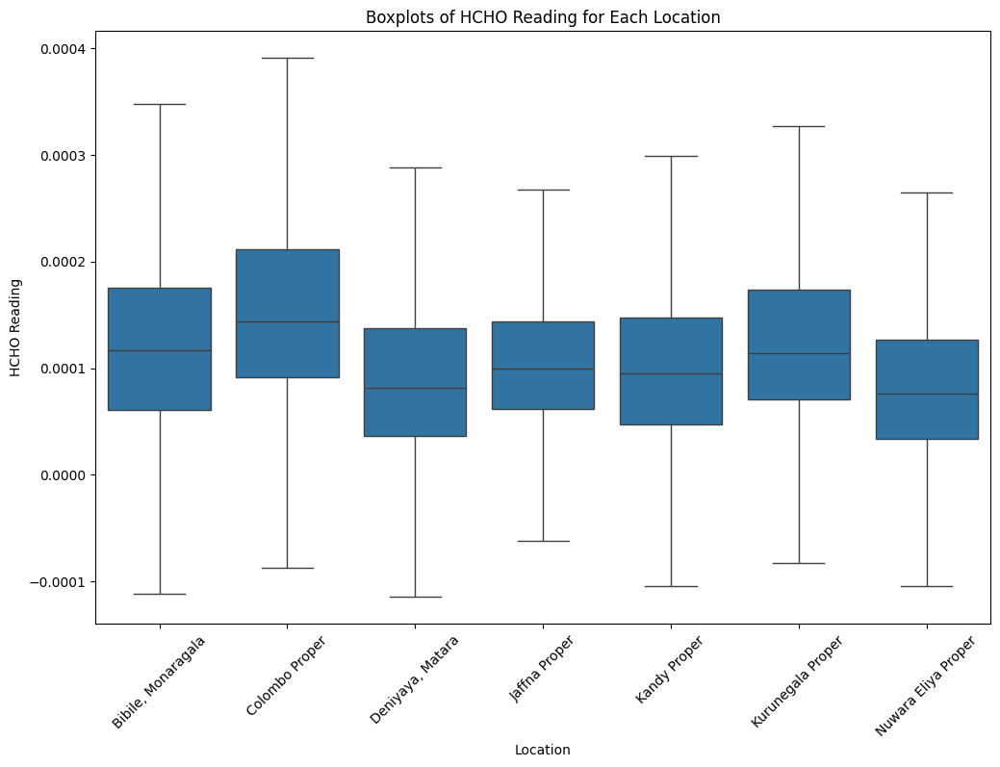

In [ ]:
# Recheck the boxplot for each location again for outliers
plt.figure(figsize=(12, 8))
sns.boxplot(x='Location', y='HCHO reading', data=combined_df)
plt.title('Boxplots of HCHO Reading for Each Location')
plt.xlabel('Location')
plt.ylabel('HCHO Reading')
plt.xticks(rotation=45)
plt.show()

# **2. Spatio-Temporal Analysis**

## **Analyse trends over time:**

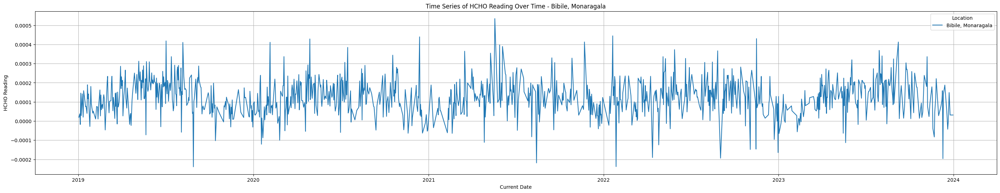

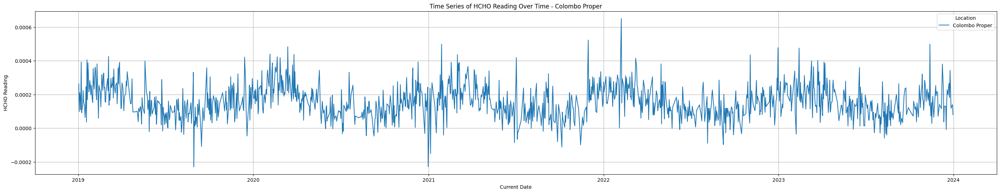

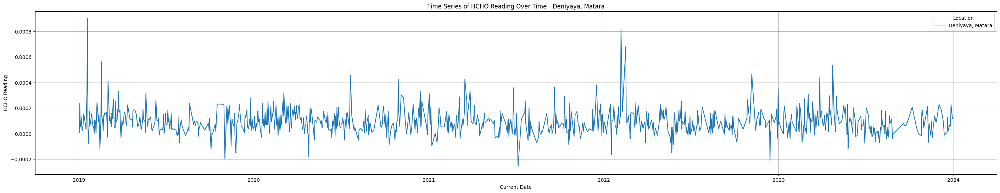

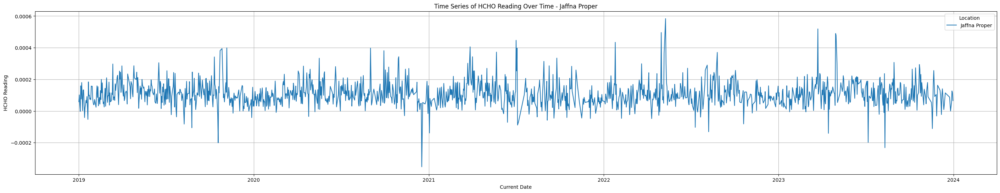

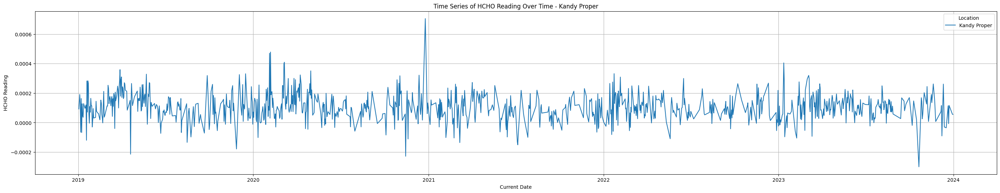

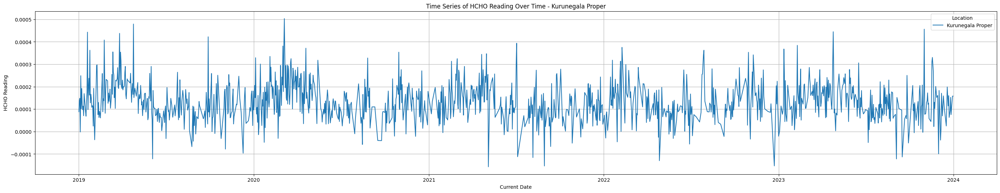

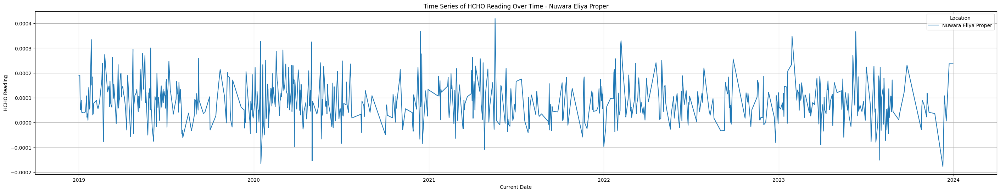

In [ ]:
# Plot time series for each location from 2019 to 2024

for location, group_data in grouped:
    plt.figure(figsize=(35, 6))
    plt.plot(group_data['Current Date'], group_data['HCHO reading'], label=location)
    plt.title(f'Time Series of HCHO Reading Over Time - {location}')
    plt.xlabel('Current Date')
    plt.ylabel('HCHO Reading')
    plt.legend(title='Location')
    plt.grid(True)
    plt.show()

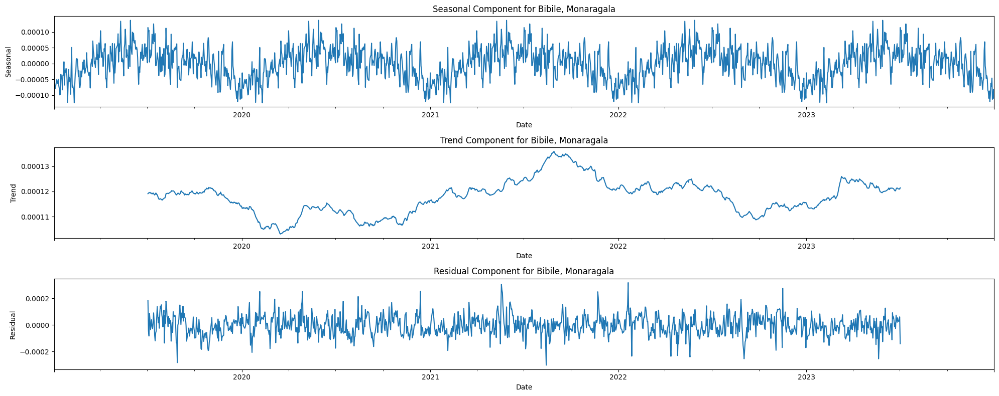

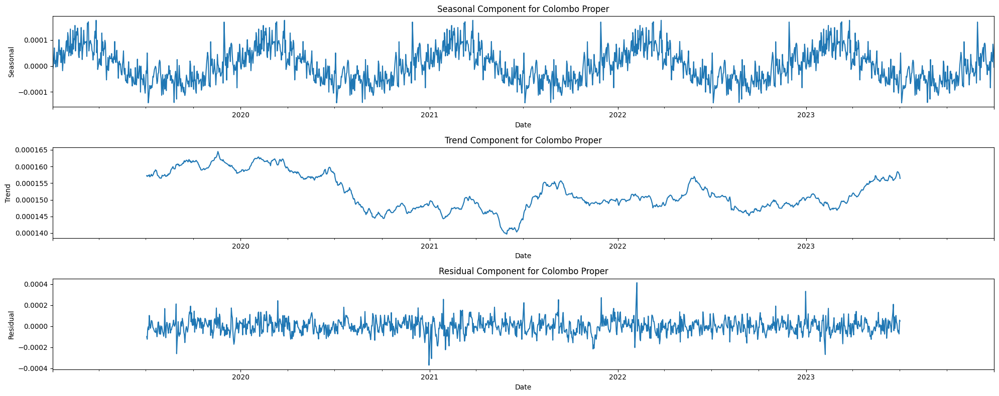

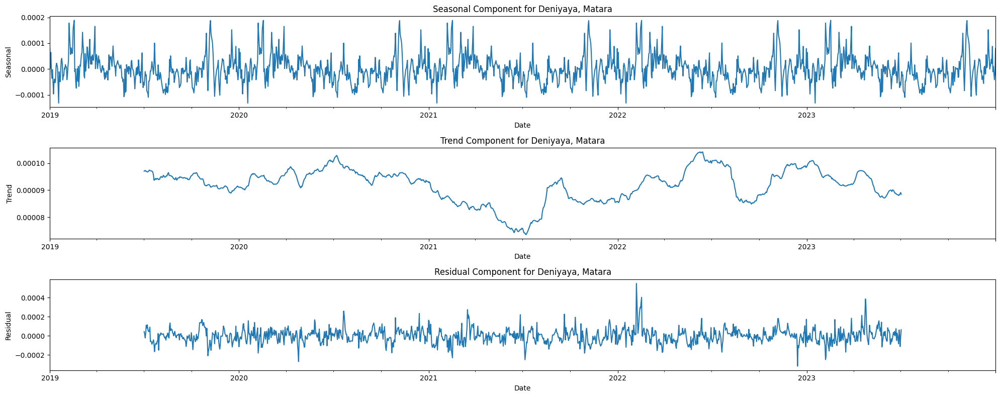

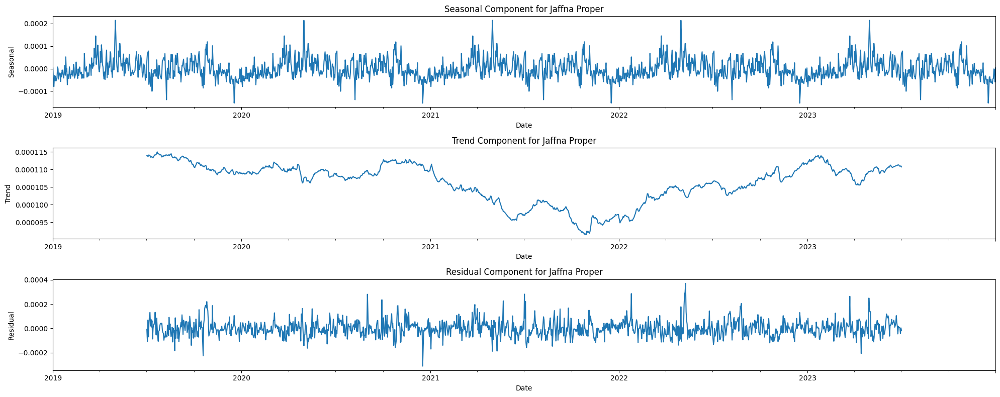

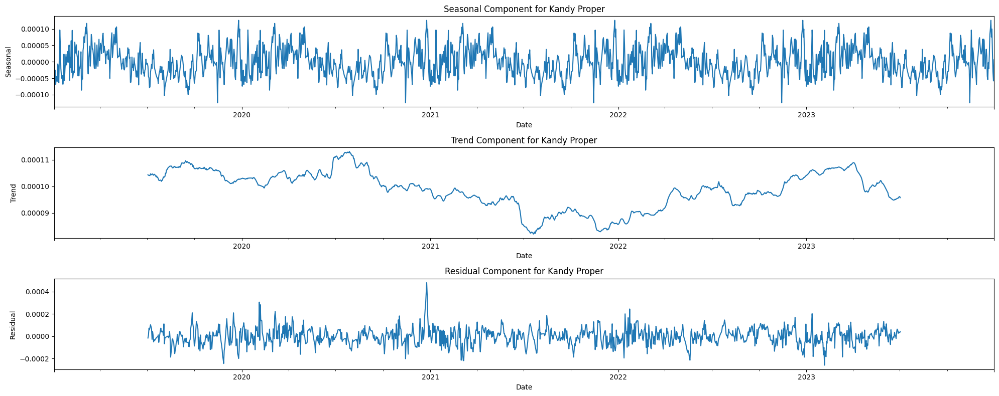

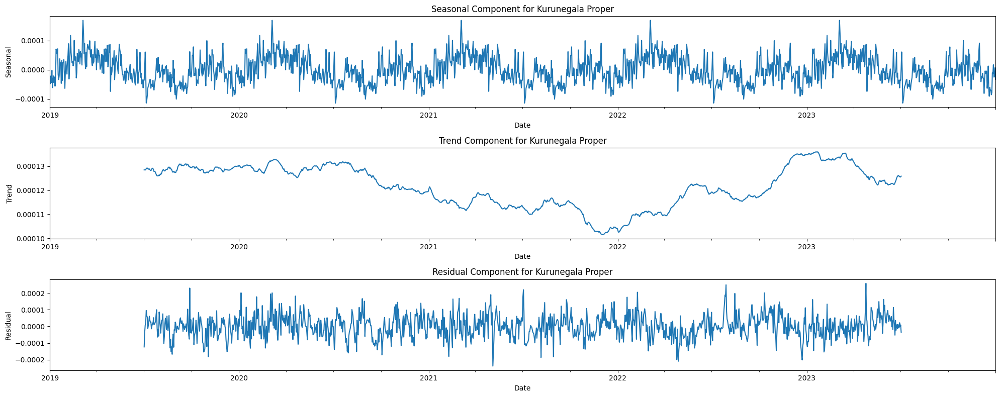

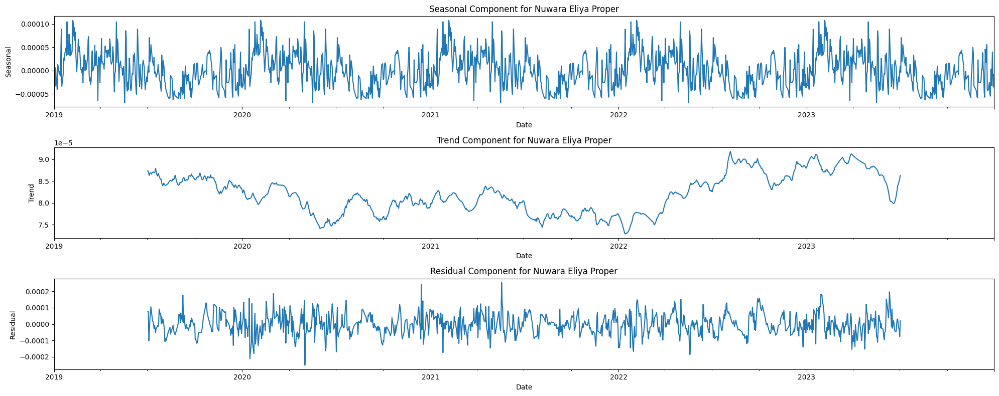

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Iterate through each group and perform seasonal decomposition
for location, group_data in grouped:
    # Set 'Current Date' as the index for the group data
    group_data.set_index('Current Date', inplace=True)

    # Perform seasonal decomposition using the additive model
    decomposition = seasonal_decompose(group_data['HCHO reading'], model='additive', period=365)

    # Plot the decomposition results
    plt.figure(figsize=(20, 8))

    # Plot the seasonal component
    plt.subplot(3, 1, 1)
    decomposition.seasonal.plot()
    plt.title(f'Seasonal Component for {location}')
    plt.xlabel('Date')
    plt.ylabel('Seasonal')

    # Plot the trend component
    plt.subplot(3, 1, 2)
    decomposition.trend.plot()
    plt.title(f'Trend Component for {location}')
    plt.xlabel('Date')
    plt.ylabel('Trend')

    # Plot the residual component
    plt.subplot(3, 1, 3)
    decomposition.resid.plot()
    plt.title(f'Residual Component for {location}')
    plt.xlabel('Date')
    plt.ylabel('Residual')

    # Show the plot
    plt.tight_layout()
    plt.show()

    # Reset the index of the group data
    group_data.reset_index(inplace=True)


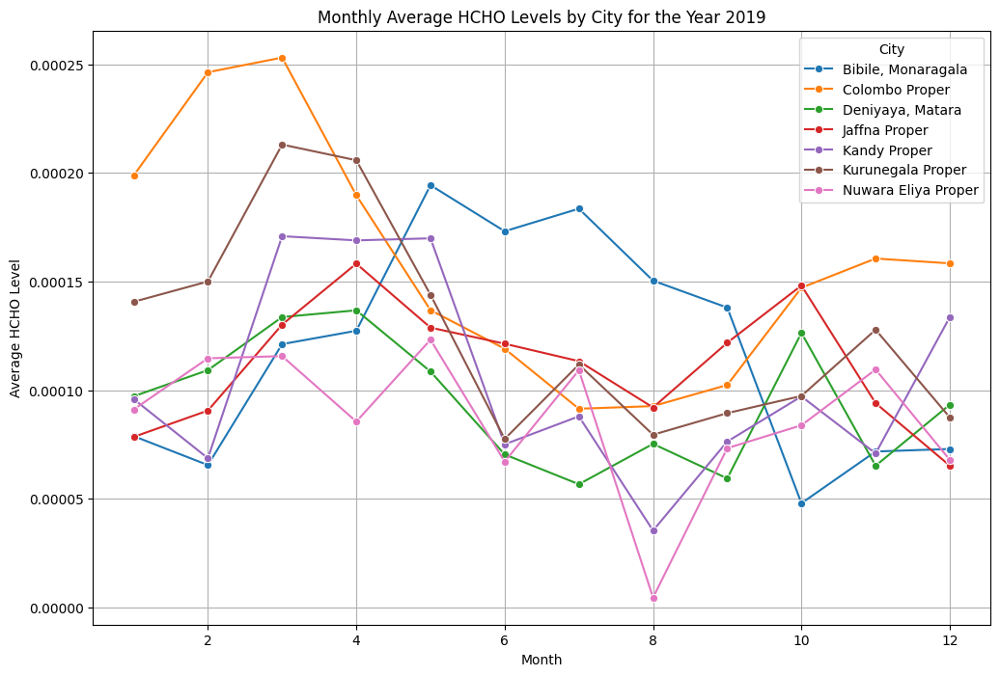

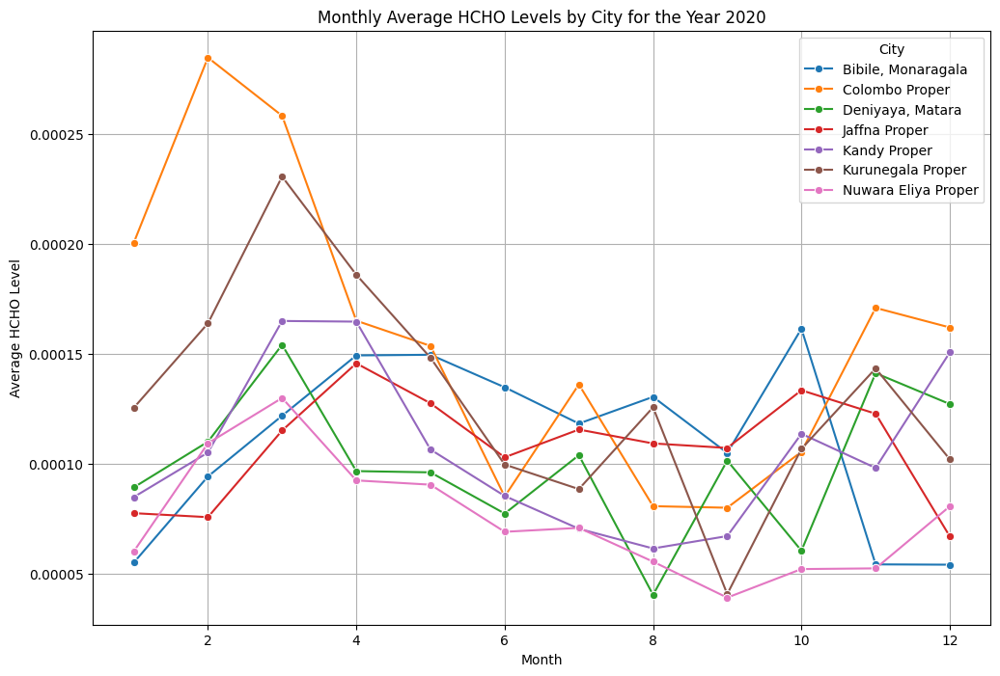

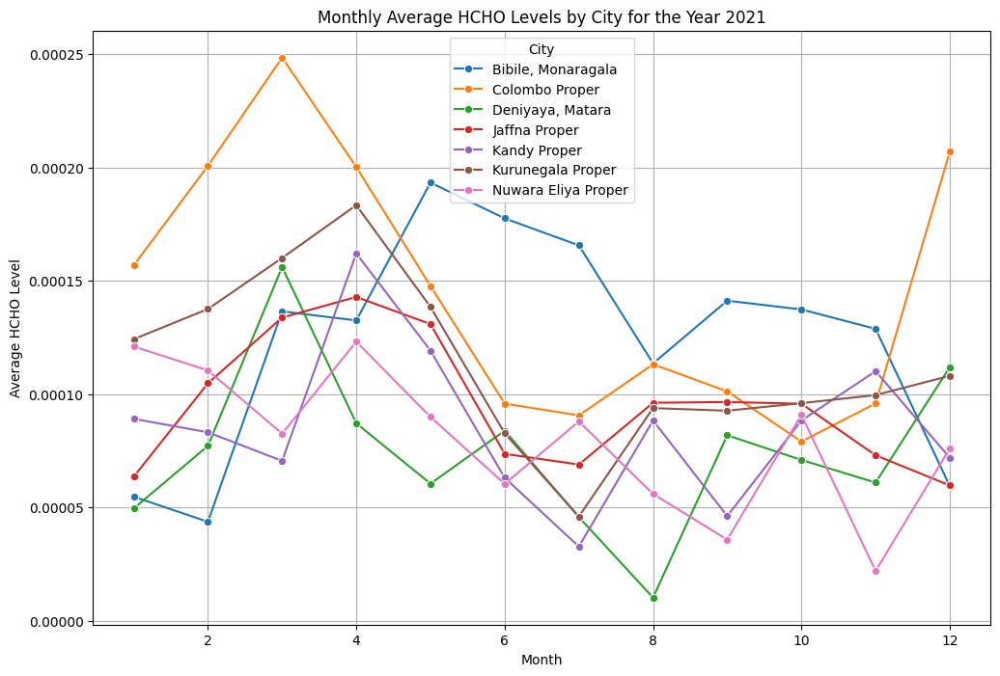

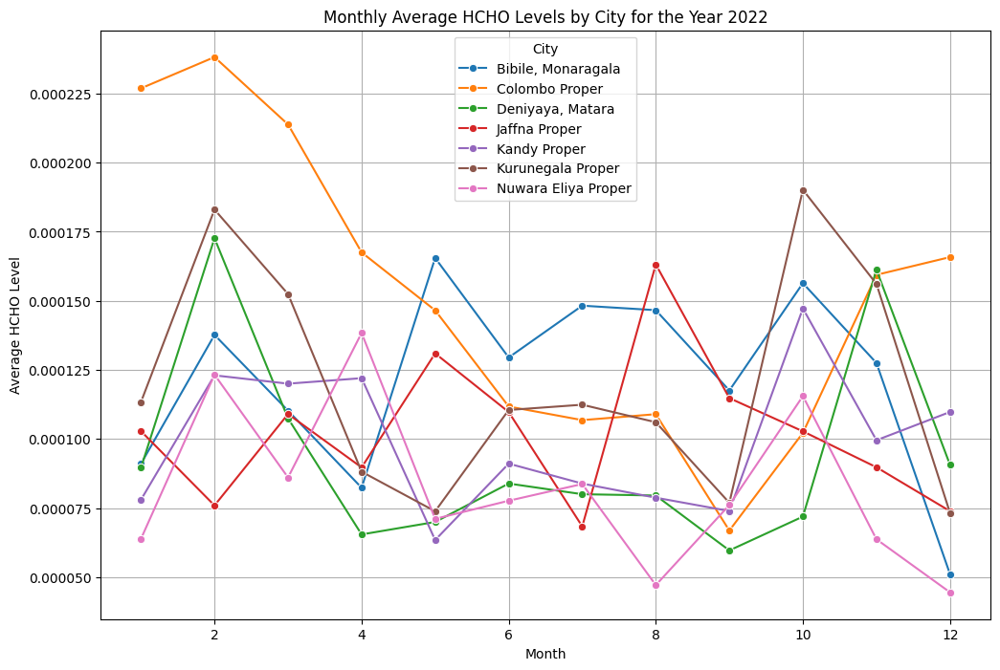

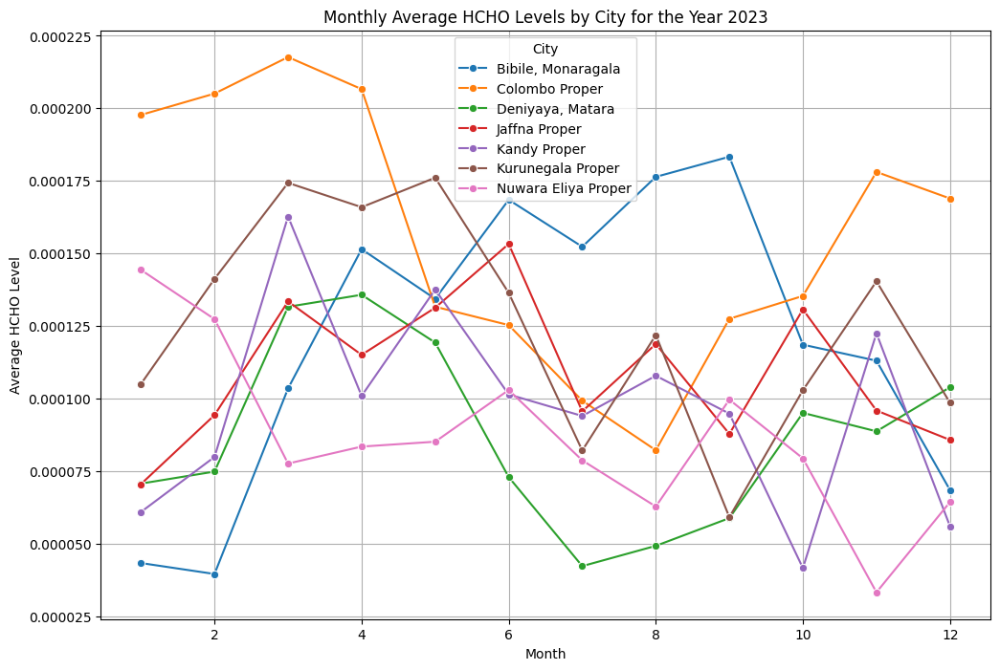

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

new_combined_df = combined_df.copy()
new_combined_df['Year'] = new_combined_df['Current Date'].dt.year
new_combined_df['Month'] = new_combined_df['Current Date'].dt.month


# Calculate monthly average HCHO levels for each city and year
monthly_avg = new_combined_df.groupby(['Location', 'Year', 'Month'])['HCHO reading'].mean().reset_index()

# Get the list of years in the dataset
years = monthly_avg['Year'].unique()

# Loop through each year and plot the monthly average HCHO levels by city
for year in years:
    # Filter the data for the current year
    data_for_year = monthly_avg[monthly_avg['Year'] == year]

    # Create a new figure for each year's data
    plt.figure(figsize=(12, 8))

    # Plot the data
    sns.lineplot(data=data_for_year, x='Month', y='HCHO reading', hue='Location', marker='o')

    # Add title and labels
    plt.title(f'Monthly Average HCHO Levels by City for the Year {year}')
    plt.xlabel('Month')
    plt.ylabel('Average HCHO Level')
    plt.legend(title='City')

    # Add grid
    plt.grid(True)

    # Show the plot
    plt.show()


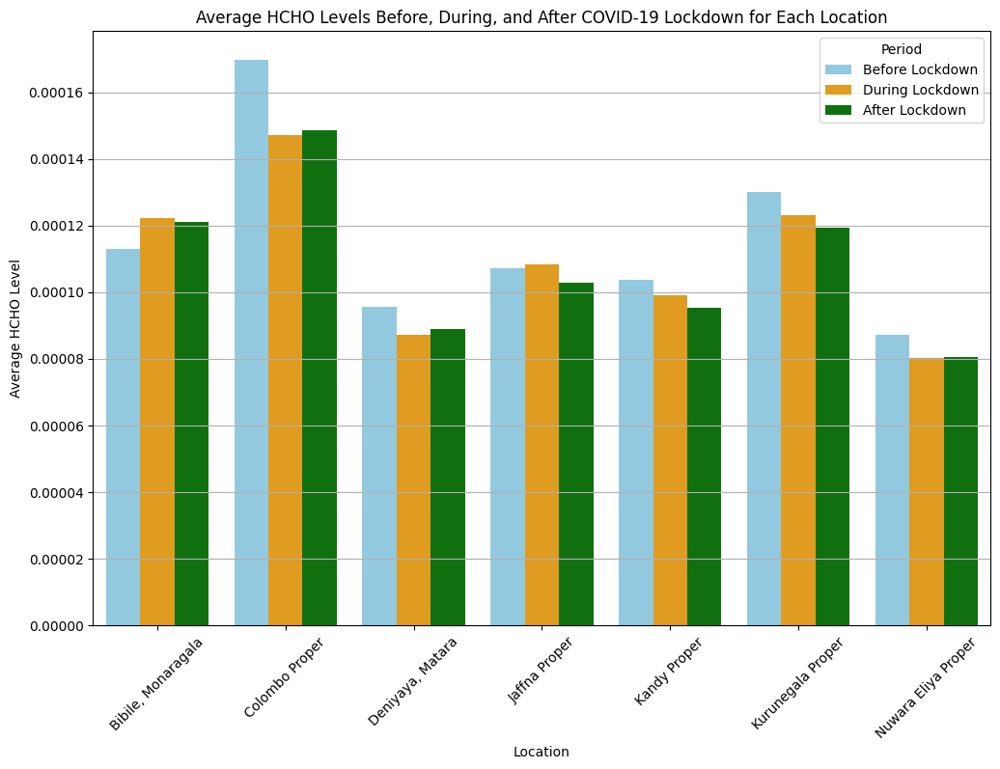

In [ ]:
before_lockdown_period = combined_df[(combined_df['Current Date'] <= '2020-03-03')]
lockdown_period = combined_df[(combined_df['Current Date'] >= '2020-03-03') & (combined_df['Current Date'] <= '2021-09-06')]
after_lockdown_period = combined_df[(combined_df['Current Date'] >= '2021-09-06')]

# Calculate average HCHO levels before, during and after the lockdown period for each city
before_lockdown_avg = before_lockdown_period.groupby('Location')['HCHO reading'].mean()
lockdown_avg = lockdown_period.groupby('Location')['HCHO reading'].mean()
after_lockdown_avg = after_lockdown_period.groupby('Location')['HCHO reading'].mean()

# Combine the average HCHO levels for each period into a single DataFrame
data = pd.DataFrame({
    'Location': before_lockdown_avg.index,
    'Before Lockdown': before_lockdown_avg.values,
    'During Lockdown': lockdown_avg.values,
    'After Lockdown': after_lockdown_avg.values
})

# Melt the DataFrame so that the average HCHO levels for each period are in the same column
melted_data = pd.melt(data, id_vars='Location', value_vars=['Before Lockdown', 'During Lockdown', 'After Lockdown'],
                      var_name='Period', value_name='Average HCHO Level')

# Plot the combined data using sns.barplot
plt.figure(figsize=(12, 8))
sns.barplot(x='Location', y='Average HCHO Level', hue='Period', data=melted_data,
            palette={'Before Lockdown': 'skyblue', 'During Lockdown': 'orange', 'After Lockdown': 'green'})

plt.title('Average HCHO Levels Before, During, and After COVID-19 Lockdown for Each Location')
plt.xlabel('Location')
plt.ylabel('Average HCHO Level')
plt.xticks(rotation=45)
plt.legend(title='Period')
plt.grid(axis='y')
plt.show()


<Figure size 1200x600 with 0 Axes>

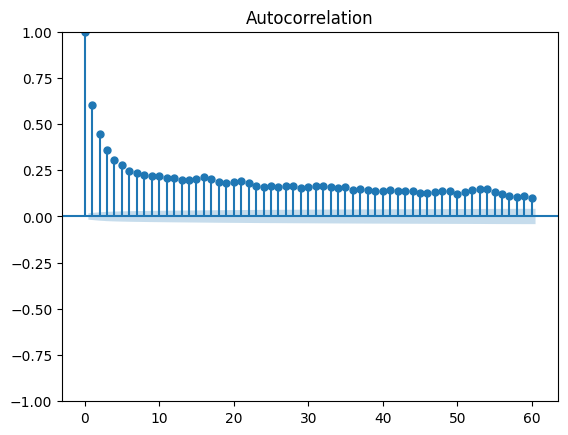

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf

new_df = combined_df.copy()
new_df.set_index('Current Date', inplace=True)

grouped = new_df.groupby('Location')

# Calculate and plot the Autocorrelation Function (ACF)
plt.figure(figsize=(12, 6))
plot_acf(new_df['HCHO reading'], lags=60)  # lags can be adjusted as needed

# Show the plot
plt.show()

Determine the total number of months in your dataset:

Your data covers a period from 2019 to the end of 2023.

Calculate the total number of months as (end year - start year + 1) * 12.

(2023 - 2019 + 1) * 12 = 5 * 12 = 60 months.

Choose the maximum number of lags:

You may want to use lags up to around half of the total number of months (e.g., around 30 lags) to observe the autocorrelation over time.
This allows you to see patterns up to roughly 2.5 years' worth of data.


The ACF represents the correlation between a time series and its own lagged values.

> The ACF represents the correlation between a time series and its own lagged values.
It quantifies how much the current value of a series depends on its past values at different lags.

> Each bar in the ACF plot corresponds to a specific lag and shows the correlation magnitude and direction.

> Interpreting the ACF Plot:
> Lag 0 (k = 0): The ACF at lag 0 is always 1, as it measures the correlation of the series with itself (perfect positive correlation).
> Other Lags (k > 0):
> If a bar extends significantly above or below the red line, it indicates a statistically significant correlation.
> Bars above the line represent positive correlations, while bars below the line represent negative correlations.


> It quantifies how much the current value of a series depends on its past values at different lags.

> Each bar in the ACF plot corresponds to a specific lag and shows the correlation magnitude and direction.

> Interpreting the ACF Plot:
> Lag 0 (k = 0): The ACF at lag 0 is always 1, as it measures the correlation of the series with itself (perfect positive correlation).
> Other Lags (k > 0):
> If a bar extends significantly above or below the red line, it indicates a statistically significant correlation.
> Bars above the line represent positive correlations, while bars below the line represent negative correlations.

## **Correlate HCHO levels with external factors:**

In [ ]:
# Define the file paths for the external datasets
colombo_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/External Data/ExternalData_colombo.csv'
nuwaraeliya_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/External Data/ExternalData_nuwara-eliya.csv'
kurunegala_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/External Data/ExternalData_kurunegala.csv'
weather_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/External Data/SriLanka_Weather_Dataset.csv'

# Load the CSV files using Pandas
colombo_external_df = pd.read_csv(colombo_file)
nuwaraeliya_external_df = pd.read_csv(nuwaraeliya_file)
kurunegala_external_df = pd.read_csv(kurunegala_file)
weather_external_df = pd.read_csv(weather_file)

**Analysing the external data**

In [ ]:
print("External Colombo Weather data info:")
colombo_external_df.info()
print("\n External Nuwara Eliya Weather data info:")
nuwaraeliya_external_df.info()
print("\n External Kurunegala Weather data info:")
kurunegala_external_df.info()
print("\n External Weather data info:")
weather_external_df.info()

External Colombo Weather data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1765 entries, 0 to 1764
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   STATION  1765 non-null   object 
 1   NAME     1765 non-null   object 
 2   DATE     1765 non-null   object 
 3   PRCP     1756 non-null   float64
 4   TAVG     1765 non-null   int64  
 5   TMAX     1556 non-null   float64
 6   TMIN     1448 non-null   float64
dtypes: float64(3), int64(1), object(3)
memory usage: 96.6+ KB

 External Nuwara Eliya Weather data info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1773 entries, 0 to 1772
Data columns (total 10 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   STATION    1773 non-null   object 
 1   NAME       1773 non-null   object 
 2   LATITUDE   1773 non-null   float64
 3   LONGITUDE  1773 non-null   float64
 4   ELEVATION  1773 non-null   float64
 5   DATE       1773 no

In [ ]:
# @title Change column names
nuwaraeliya_external_df.rename(columns={'NAME': 'Location'}, inplace=True)
colombo_external_df.rename(columns={'NAME': 'Location'}, inplace=True)
kurunegala_external_df.rename(columns={'NAME': 'Location'}, inplace=True)
weather_external_df.rename(columns={'city': 'Location', 'time': 'DATE'}, inplace=True)

In [ ]:
nuwaraeliya_external_df.head()

,STATION,Location,LATITUDE,LONGITUDE,ELEVATION,DATE,PRCP,TAVG,TMAX,TMIN
0,CE000434730,"NUWARA ELIYA, CE",6.967,80.767,1880.0,2019-01-01,0.0,61,71.0,49.0
1,CE000434730,"NUWARA ELIYA, CE",6.967,80.767,1880.0,2019-01-02,0.0,59,NaN,49.0
2,CE000434730,"NUWARA ELIYA, CE",6.967,80.767,1880.0,2019-01-03,0.0,59,71.0,49.0
3,CE000434730,"NUWARA ELIYA, CE",6.967,80.767,1880.0,2019-01-04,0.0,59,72.0,47.0
4,CE000434730,"NUWARA ELIYA, CE",6.967,80.767,1880.0,2019-01-05,0.0,55,68.0,NaN


In [ ]:
colombo_external_df.head()

,STATION,Location,DATE,PRCP,TAVG,TMAX,TMIN
0,CEM00043466,"COLOMBO, CE",2019-01-01,0.0,81,89.0,74.0
1,CEM00043466,"COLOMBO, CE",2019-01-02,0.0,78,NaN,74.0
2,CEM00043466,"COLOMBO, CE",2019-01-03,0.0,81,90.0,74.0
3,CEM00043466,"COLOMBO, CE",2019-01-04,0.0,81,91.0,72.0
4,CEM00043466,"COLOMBO, CE",2019-01-05,0.0,81,90.0,74.0


In [ ]:
kurunegala_external_df.head()

,STATION,Location,DATE,PRCP,TAVG,TMAX,TMIN
0,CEM00043441,"KURUNEGALA, CE",1/2/2019,0.0,78.0,NaN,72.0
1,CEM00043441,"KURUNEGALA, CE",1/3/2019,0.0,81.0,87.0,71.0
2,CEM00043441,"KURUNEGALA, CE",1/4/2019,0.0,83.0,88.0,69.0
3,CEM00043441,"KURUNEGALA, CE",1/5/2019,0.0,84.0,90.0,65.0
4,CEM00043441,"KURUNEGALA, CE",1/6/2019,0.0,82.0,88.0,71.0


In [ ]:
weather_external_df.head()

,DATE,weathercode,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,apparent_temperature_mean,sunrise,sunset,...,precipitation_hours,windspeed_10m_max,windgusts_10m_max,winddirection_10m_dominant,et0_fao_evapotranspiration,latitude,longitude,elevation,country,Location
0,2010-01-01,2,30.0,22.7,26.1,34.4,25.2,29.2,2010-01-01T00:52,2010-01-01T12:35,...,0.0,11.7,27.4,20,4.58,7.0,79.899994,16.0,Sri Lanka,Colombo
1,2010-01-02,51,29.9,23.5,26.2,33.8,26.2,29.8,2010-01-02T00:52,2010-01-02T12:36,...,1.0,13.0,27.0,24,3.84,7.0,79.899994,16.0,Sri Lanka,Colombo
2,2010-01-03,51,29.5,23.2,26.0,34.3,26.3,29.9,2010-01-03T00:53,2010-01-03T12:36,...,3.0,12.3,27.4,16,3.65,7.0,79.899994,16.0,Sri Lanka,Colombo
3,2010-01-04,2,28.9,21.9,25.3,31.6,23.4,27.8,2010-01-04T00:53,2010-01-04T12:37,...,0.0,17.0,34.6,356,3.79,7.0,79.899994,16.0,Sri Lanka,Colombo
4,2010-01-05,1,28.1,21.3,24.5,30.1,23.1,26.1,2010-01-05T00:53,2010-01-05T12:37,...,0.0,18.7,37.1,355,4.97,7.0,79.899994,16.0,Sri Lanka,Colombo


In [ ]:
#@title Check the unique values

print("Nuwara Eliya External Data")
for column in nuwaraeliya_external_df.columns:
    print(column, nuwaraeliya_external_df[column].unique(), "\n")

print("Colombo External Data")
for column in colombo_external_df.columns:
    print(column, colombo_external_df[column].unique(), "\n")

print("Kurunegala External Data")
for column in kurunegala_external_df.columns:
    print(column, kurunegala_external_df[column].unique(), "\n")

print("Weather External Data")
for column in weather_external_df.columns:
    print(column, weather_external_df[column].unique(), "\n")

Nuwara Eliya External Data
STATION ['CE000434730'] 

Location ['NUWARA ELIYA, CE'] 

LATITUDE [6.967] 

LONGITUDE [80.767] 

ELEVATION [1880.] 

DATE ['2019-01-01' '2019-01-02' '2019-01-03' ... '2024-01-13' '2024-01-14'
 '2024-01-15'] 

PRCP [0.   0.07 2.03 0.08 0.3  0.02 0.09 0.99 0.01 0.04 0.17 0.2  0.16 0.21
  nan 0.47 0.65 0.14 1.93 0.13 0.11 0.28 0.27 0.26 0.15 0.06 0.59 0.18
 0.48 0.73 0.84 4.25 1.42 1.41 0.5  0.19 0.56 1.14 1.77 1.13 0.22 0.46
 0.1  1.02 0.12 0.05 0.91 0.24 0.53 1.46 1.31 0.58 0.03 0.38 1.9  0.35
 0.67 1.05 1.01 0.36 0.44 0.82 1.81 0.25 0.85 0.37 2.37 1.7  0.41 1.23
 3.93 0.42 0.8  1.61 0.43 0.93 1.19 2.16 0.68 0.31 0.45 0.34 0.51 0.97
 0.75 0.39 2.35 0.74 1.55 1.06 0.69 0.57 0.23 0.54 0.86 0.29 1.68 2.13
 1.33 1.04 0.71 0.63 2.14 1.29 0.92 1.3  1.85 0.32 0.81 1.21 0.4  0.72
 0.64 1.28 0.61 2.54 1.18 1.6  0.77 1.   3.71 0.52 0.33 0.78 1.99 1.69
 0.62 2.59 1.56 3.27 1.37 1.2  0.96 1.11 0.49 0.76 1.09 1.16 0.83 1.27
 2.5  2.34 1.54 0.7  1.38 2.39 1.82 1.87 1.26 4.

In [ ]:
#@title summary statistics
print("summary statistics of Nuwara Eliya")
print(nuwaraeliya_external_df.describe().T)
print("summary statistics of Colombo")
print(colombo_external_df.describe().T)
print("summary statistics of Kurunegala")
print(kurunegala_external_df.describe().T)
print("summary statistics of the Weather dataset")
print(weather_external_df.describe().T)

summary statistics of Nuwara Eliya
            count         mean           std       min       25%       50%  \
LATITUDE   1773.0     6.967000  8.884290e-16     6.967     6.967     6.967   
LONGITUDE  1773.0    80.767000  2.842973e-14    80.767    80.767    80.767   
ELEVATION  1773.0  1880.000000  0.000000e+00  1880.000  1880.000  1880.000   
PRCP       1767.0     0.206870  4.313356e-01     0.000     0.000     0.010   
TAVG       1773.0    60.954879  1.938733e+00    51.000    60.000    61.000   
TMAX       1559.0    68.676074  3.683866e+00    56.000    66.000    69.000   
TMIN       1427.0    54.126139  3.890083e+00    37.000    52.000    55.000   

                75%       max  
LATITUDE      6.967     6.967  
LONGITUDE    80.767    80.767  
ELEVATION  1880.000  1880.000  
PRCP          0.200     4.250  
TAVG         62.000    68.000  
TMAX         71.000    92.000  
TMIN         57.000    61.000  
summary statistics of Colombo
       count       mean       std   min   25%    50%  

In [ ]:
#@title check for null values
print("\n Null values in Nuwara Eliya external dataframe")
print(nuwaraeliya_external_df.isnull().sum())
print("\n Null values in Colombo external dataframe")
print(colombo_external_df.isnull().sum())
print("\n Null values in Kurunegala external dataframe")
print(kurunegala_external_df.isnull().sum())
print("\n Null values in Weather external dataframe")
print(weather_external_df.isnull().sum())


 Null values in Nuwara Eliya external dataframe
STATION        0
Location       0
LATITUDE       0
LONGITUDE      0
ELEVATION      0
DATE           0
PRCP           6
TAVG           0
TMAX         214
TMIN         346
dtype: int64

 Null values in Colombo external dataframe
STATION       0
Location      0
DATE          0
PRCP          9
TAVG          0
TMAX        209
TMIN        317
dtype: int64

 Null values in Kurunegala external dataframe
STATION      34
Location     34
DATE         34
PRCP         37
TAVG         34
TMAX        194
TMIN        299
dtype: int64

 Null values in Weather external dataframe
DATE                          0
weathercode                   0
temperature_2m_max            0
temperature_2m_min            0
temperature_2m_mean           0
apparent_temperature_max      0
apparent_temperature_min      0
apparent_temperature_mean     0
sunrise                       0
sunset                        0
shortwave_radiation_sum       0
precipitation_sum             0

In [ ]:
#@title Check for duplicates
print("Duplicate values in Nuwara Eliya external dataframe: ", nuwaraeliya_external_df.duplicated().sum())
print("Duplicate values in Colombo external dataframe:", colombo_external_df.duplicated().sum())
print("Duplicate values in Kurunegala external dataframe:", kurunegala_external_df.duplicated().sum())
print("Duplicate values in Weather external dataframe:",weather_external_df.duplicated().sum())

Duplicate values in Nuwara Eliya external dataframe:  0
Duplicate values in Colombo external dataframe: 0
Duplicate values in Kurunegala external dataframe: 33
Duplicate values in Weather external dataframe: 0


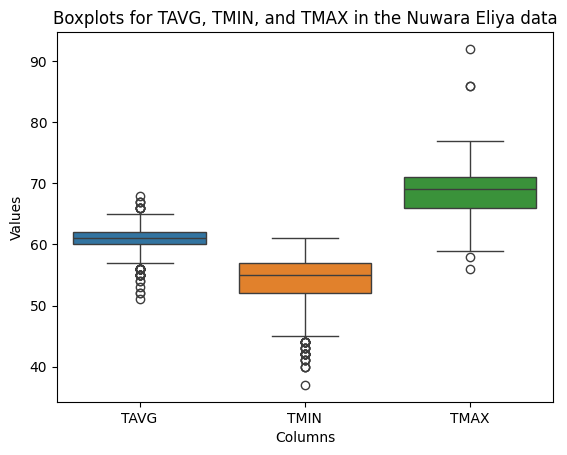

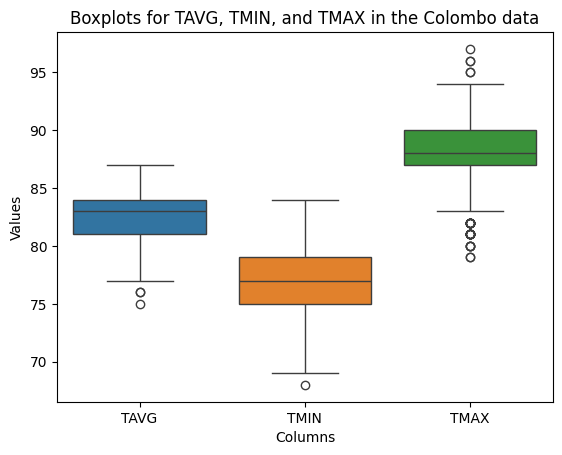

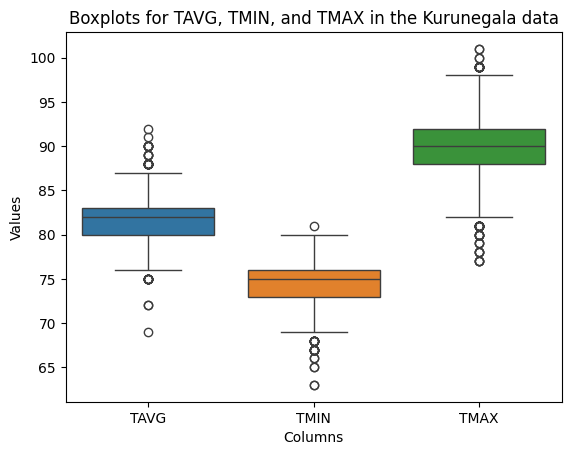

In [ ]:
# @title Check for outliers

# Plot boxplots for the columns TAVG, TMIN, and TMAX
sns.boxplot(data=nuwaraeliya_external_df[['TAVG', 'TMIN', 'TMAX']])
plt.title('Boxplots for TAVG, TMIN, and TMAX in the Nuwara Eliya data')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.show()

sns.boxplot(data=colombo_external_df[['TAVG', 'TMIN', 'TMAX']])
plt.title('Boxplots for TAVG, TMIN, and TMAX in the Colombo data')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.show()

sns.boxplot(data=kurunegala_external_df[['TAVG', 'TMIN', 'TMAX']])
plt.title('Boxplots for TAVG, TMIN, and TMAX in the Kurunegala data')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.show()

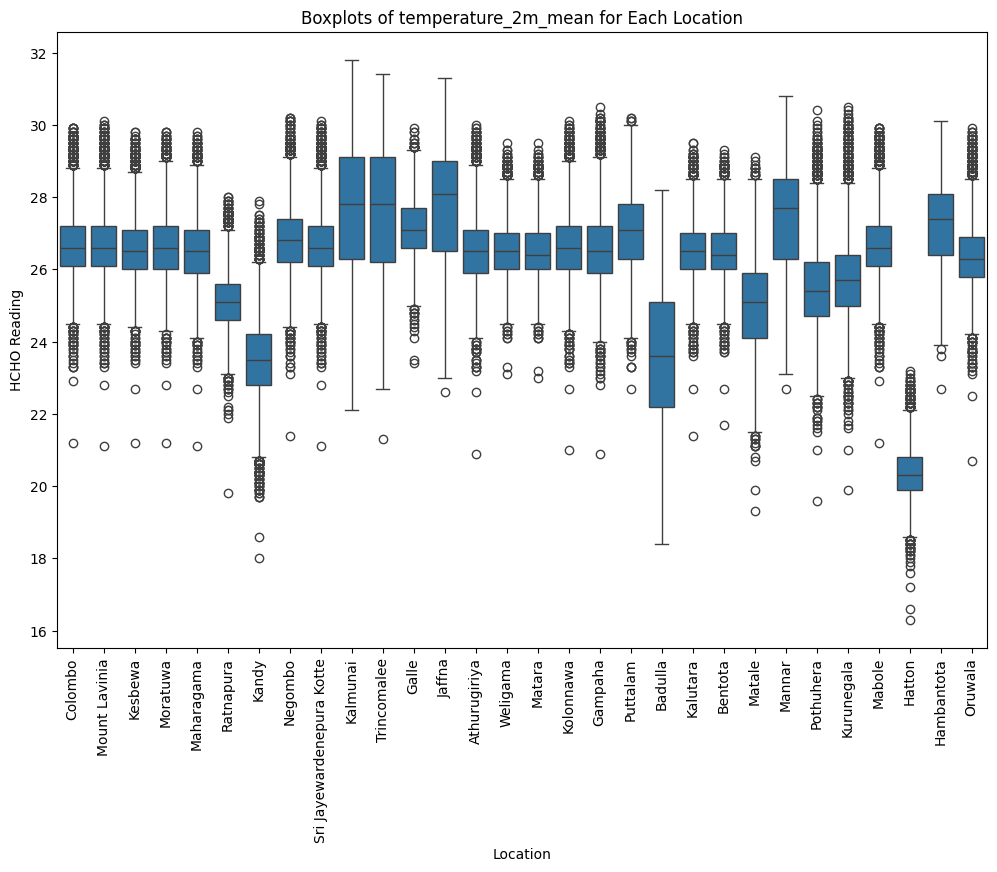

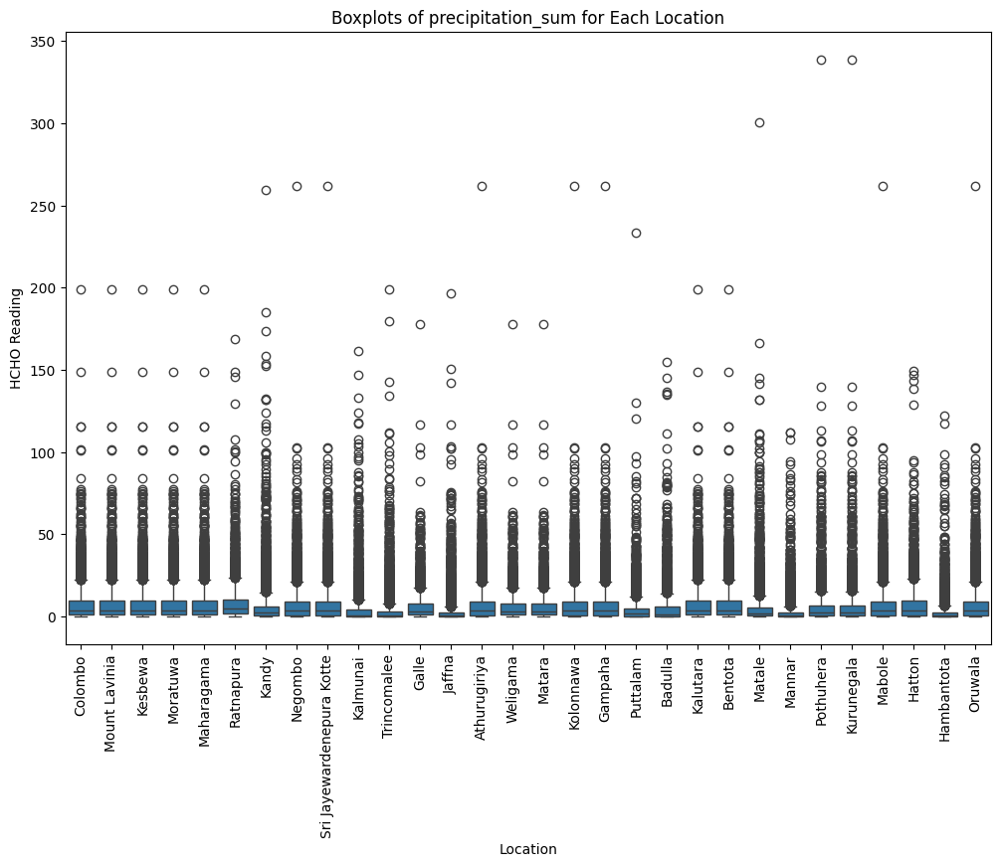

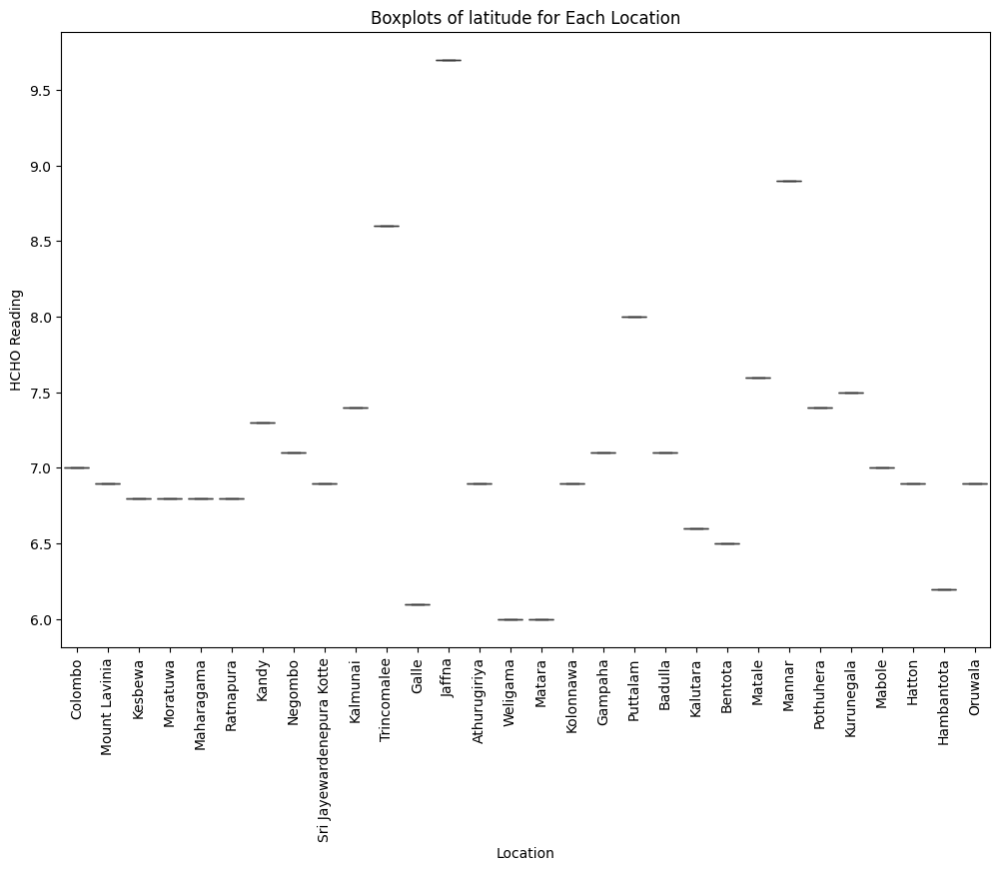

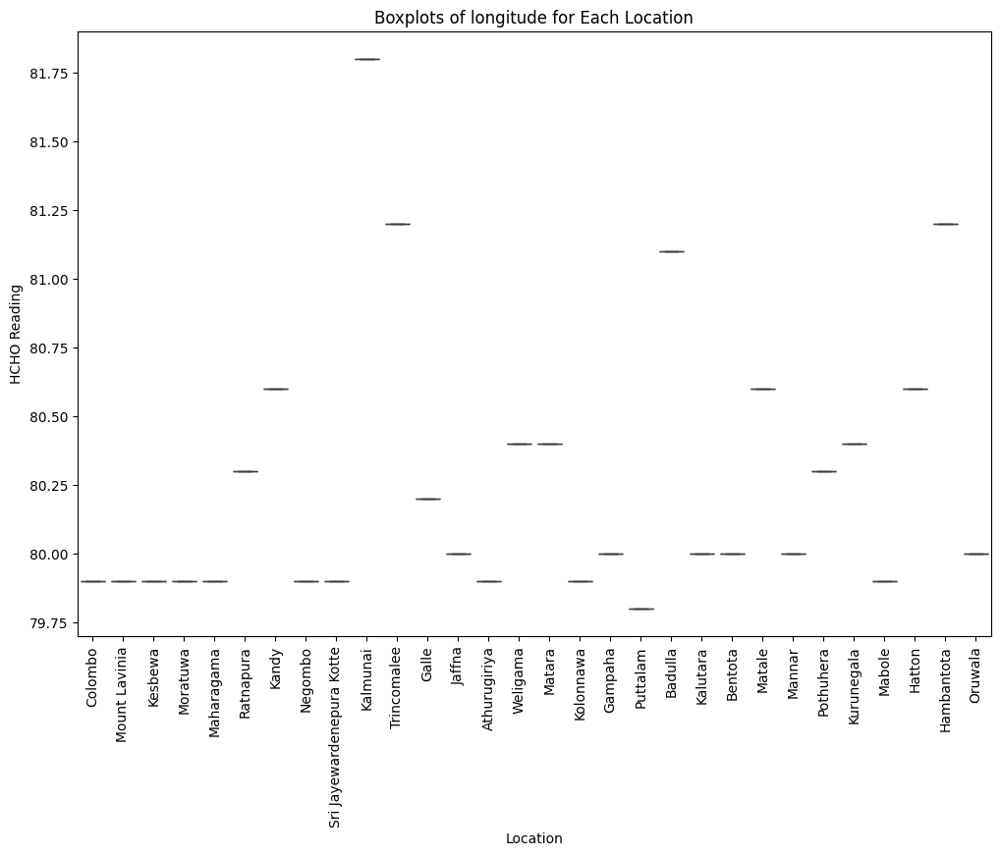

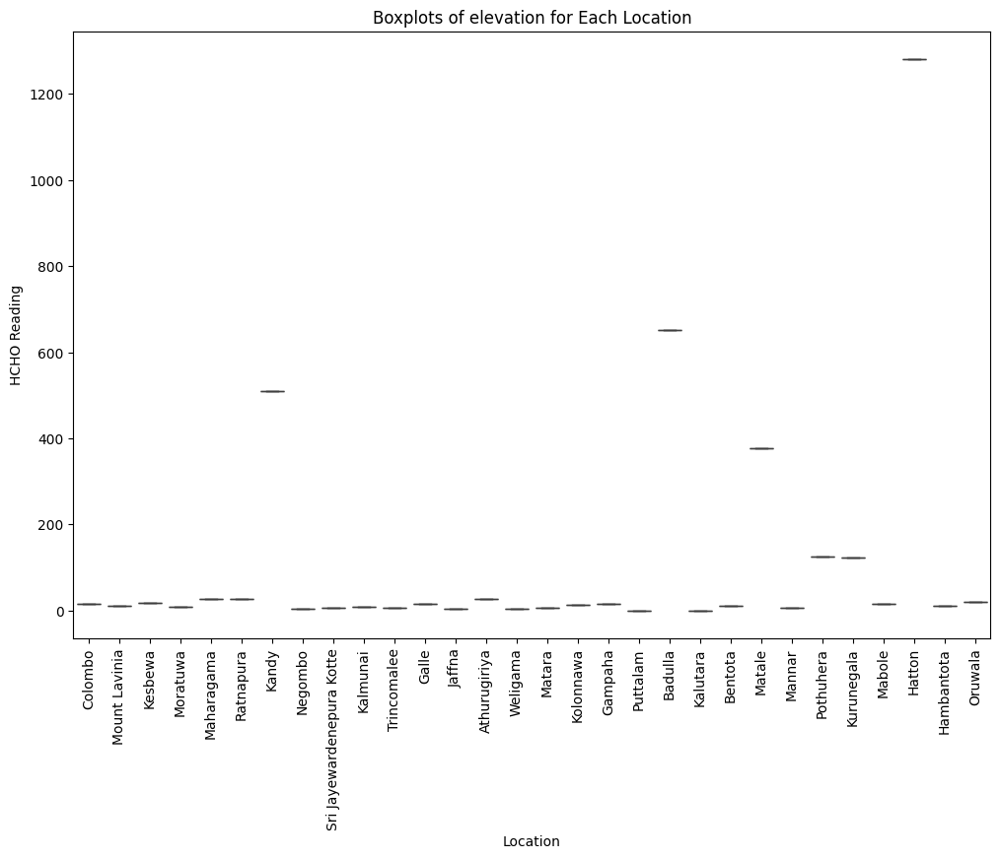

In [ ]:
weather_df_copy = weather_external_df.copy()
grouped_by_location = weather_df_copy.groupby('Location')

#selecting data that is considered for the research
data_columns = ['temperature_2m_mean', 'precipitation_sum', 'latitude', 'longitude', 'elevation']

# Recheck the boxplot for each location again for outliers
for column in weather_external_df.columns:
  if column in(data_columns):
    plt.figure(figsize=(12, 8))
    sns.boxplot(x='Location', y=column, data=weather_external_df)
    plt.title(f'Boxplots of {column} for Each Location')
    plt.xlabel('Location')
    plt.ylabel('HCHO Reading')
    plt.xticks(rotation=90)
    plt.show()

Observations:

- Null values were identified in the external datasets of Colombo, Nuwara Eliya and Kurunegala. No null values were identified in the weather dataset

- Duplicate values were identified in the external Kurunegala datasets.

- Outliers - In ther external datasets of Colombo, Kurunegala, and Muwara Eliya, outliers were identified in the minimum, maximum and average temperature columns.

- min temperature and max temperature columns can be removed since the average temperature is available.

- Some data columns from the weather dataset needs to be added to the colombo and kurunegala datasets (longitudinal data, latitudinal data, Elevation)

- Drop the data before 2019 time period in the weather dataset and drop the data for the locations that are not considered in this research

> Handling several datasets is inefficient. Therefore all the data need to be merged into one.





### **Data Preprocessing**

In [ ]:
#@title Drop Duplicates
kurunegala_external_df.drop_duplicates(inplace=True)
print(kurunegala_external_df.duplicated().sum())

0


In [ ]:
#@title convert date column datatype to datetime
weather_external_df['DATE'] = pd.to_datetime(weather_external_df['DATE'])
colombo_external_df['DATE'] = pd.to_datetime(colombo_external_df['DATE'])
kurunegala_external_df['DATE'] = pd.to_datetime(kurunegala_external_df['DATE'])
nuwaraeliya_external_df['DATE'] = pd.to_datetime(nuwaraeliya_external_df['DATE'])

print("\n Weather Dataset info")
weather_external_df.info()
print("\n Colombo Dataset info")
colombo_external_df.info()
print("\n Kurunegala Dataset info")
kurunegala_external_df.info()
print("\n Nuwara Eliya Dataset info")
nuwaraeliya_external_df.info()


 Weather Dataset info
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147480 entries, 0 to 147479
Data columns (total 24 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   DATE                        147480 non-null  datetime64[ns]
 1   weathercode                 147480 non-null  int64         
 2   temperature_2m_max          147480 non-null  float64       
 3   temperature_2m_min          147480 non-null  float64       
 4   temperature_2m_mean         147480 non-null  float64       
 5   apparent_temperature_max    147480 non-null  float64       
 6   apparent_temperature_min    147480 non-null  float64       
 7   apparent_temperature_mean   147480 non-null  float64       
 8   sunrise                     147480 non-null  object        
 9   sunset                      147480 non-null  object        
 10  shortwave_radiation_sum     147480 non-null  float64       
 11  precipitation_su

In [ ]:
# @title Drop unnecesary data columns

# drop min and max temperature in each dataset except the weather dataset
colombo_external_df.drop(columns=['STATION', 'TMIN', 'TMAX'], axis=1, inplace=True)
nuwaraeliya_external_df.drop(columns=['STATION', 'TMIN', 'TMAX'], axis=1, inplace=True)
kurunegala_external_df.drop(columns=['STATION', 'TMIN', 'TMAX'], axis=1, inplace=True)

print("Colombo:")
print(colombo_external_df.head())

print("Nuwara Eliya:")
print(nuwaraeliya_external_df.head())

print("Kurunegala:")
print(kurunegala_external_df.head())

Colombo:
      Location       DATE  PRCP  TAVG
0  COLOMBO, CE 2019-01-01   0.0    81
1  COLOMBO, CE 2019-01-02   0.0    78
2  COLOMBO, CE 2019-01-03   0.0    81
3  COLOMBO, CE 2019-01-04   0.0    81
4  COLOMBO, CE 2019-01-05   0.0    81
Nuwara Eliya:
           Location  LATITUDE  LONGITUDE  ELEVATION       DATE  PRCP  TAVG
0  NUWARA ELIYA, CE     6.967     80.767     1880.0 2019-01-01   0.0    61
1  NUWARA ELIYA, CE     6.967     80.767     1880.0 2019-01-02   0.0    59
2  NUWARA ELIYA, CE     6.967     80.767     1880.0 2019-01-03   0.0    59
3  NUWARA ELIYA, CE     6.967     80.767     1880.0 2019-01-04   0.0    59
4  NUWARA ELIYA, CE     6.967     80.767     1880.0 2019-01-05   0.0    55
Kurunegala:
         Location       DATE  PRCP  TAVG
0  KURUNEGALA, CE 2019-01-02   0.0  78.0
1  KURUNEGALA, CE 2019-01-03   0.0  81.0
2  KURUNEGALA, CE 2019-01-04   0.0  83.0
3  KURUNEGALA, CE 2019-01-05   0.0  84.0
4  KURUNEGALA, CE 2019-01-06   0.0  82.0


In [ ]:
weather_external_df.drop(columns=['weathercode', 'temperature_2m_max', 'temperature_2m_min', 'apparent_temperature_max', 'apparent_temperature_min', 'apparent_temperature_mean', 'sunrise', 'sunset', 'shortwave_radiation_sum', 'snowfall_sum', 'rain_sum', 'precipitation_hours', 'windspeed_10m_max', 'windgusts_10m_max', 'winddirection_10m_dominant','et0_fao_evapotranspiration', 'country'], axis=1, inplace=True)
weather_external_df.head()

,DATE,temperature_2m_mean,precipitation_sum,latitude,longitude,elevation,Location
0,2010-01-01,26.1,0.0,7.0,79.899994,16.0,Colombo
1,2010-01-02,26.2,0.1,7.0,79.899994,16.0,Colombo
2,2010-01-03,26.0,0.6,7.0,79.899994,16.0,Colombo
3,2010-01-04,25.3,0.0,7.0,79.899994,16.0,Colombo
4,2010-01-05,24.5,0.0,7.0,79.899994,16.0,Colombo


In [ ]:
# @title Drop outscope data (Date)

# Define the date range (January 1, 2019 to December 31, 2023)
start_date = pd.to_datetime('2019-01-01')
end_date = pd.to_datetime('2023-12-31')

# Filter the DataFrame based on the date range
colombo_external_df = colombo_external_df[(colombo_external_df['DATE'] >= start_date) & (colombo_external_df['DATE'] <= end_date)]
nuwaraeliya_external_df = nuwaraeliya_external_df[(nuwaraeliya_external_df['DATE'] >= start_date) & (nuwaraeliya_external_df['DATE'] <= end_date)]
kurunegala_external_df = kurunegala_external_df[(kurunegala_external_df['DATE'] >= start_date) & (kurunegala_external_df['DATE'] <= end_date)]
weather_external_df = weather_external_df[(weather_external_df['DATE'] >= start_date) & (weather_external_df['DATE'] <= end_date)]

data = [colombo_external_df, nuwaraeliya_external_df, kurunegala_external_df, weather_external_df]
for df in data:
  min_date = df['DATE'].min()
  max_date = df['DATE'].max()
  print(f"\nFiltered dates range from {min_date} to {max_date}")
  # Check if the dates are within the desired range
  if min_date >= start_date and max_date <= end_date:
    print("Dates are correctly filtered within the specified range.")
  else:
    print("Dates are not within the specified range.")


Filtered dates range from 2019-01-01 00:00:00 to 2023-12-31 00:00:00
Dates are correctly filtered within the specified range.

Filtered dates range from 2019-01-01 00:00:00 to 2023-12-31 00:00:00
Dates are correctly filtered within the specified range.

Filtered dates range from 2019-01-02 00:00:00 to 2023-12-29 00:00:00
Dates are correctly filtered within the specified range.

Filtered dates range from 2019-01-01 00:00:00 to 2023-06-17 00:00:00
Dates are correctly filtered within the specified range.


In [ ]:
# @title Drop outscope data (Locations in the weather dataset)

locations = ['Kandy', 'Jaffna', 'Matara', 'Badulla']
new_weather_external_df = weather_external_df[(weather_external_df['Location'].isin(locations))]

new_weather_external_df['Location'] = new_weather_external_df['Location'].replace('Badulla', 'Monaragala')
print(new_weather_external_df['Location'].unique(), '\n')

['Kandy' 'Jaffna' 'Matara' 'Monaragala'] 



<ipython-input-144-65f595a29b29>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_weather_external_df['Location'] = new_weather_external_df['Location'].replace('Badulla', 'Monaragala')


In [ ]:
#@title Handle null values

for df in data:

  df.interpolate(method='linear', limit_direction='both', inplace=True)
  remaining_null_values = df.isnull().sum().sum()

  if remaining_null_values > 0:
    # Fill remaining null values using backward fill
    df.fillna(method='ffill', inplace=True)

print('colombo dataset null values', colombo_external_df.isnull().sum().sum())
print('kurunegala dataset null values',kurunegala_external_df.isnull().sum().sum())
print('nuwara eliya dataset null values', nuwaraeliya_external_df.isnull().sum().sum())

colombo dataset null values 0
kurunegala dataset null values 0
nuwara eliya dataset null values 0


In [ ]:
# @title Change column values to the values in the original dataset
nuwaraeliya_external_df['Location'] = nuwaraeliya_external_df['Location'].replace("NUWARA ELIYA, CE", "Nuwara Eliya Proper")
print("Nuwara Eliya")
print(nuwaraeliya_external_df.head())

colombo_external_df['Location'] = colombo_external_df['Location'].replace("COLOMBO, CE", "Colombo Proper")
print("\n Colombo")
print(colombo_external_df.head())

kurunegala_external_df['Location'] = kurunegala_external_df['Location'].replace("KURUNEGALA, CE", "Kurunegala Proper")
print("\n Kurunegala")
print(kurunegala_external_df.head())

new_weather_external_df['Location'] = new_weather_external_df['Location'].replace("Kandy", "Kandy Proper")
new_weather_external_df['Location'] = new_weather_external_df['Location'].replace("Jaffna", "Jaffna Proper")
new_weather_external_df['Location'] = new_weather_external_df['Location'].replace("Matara", "Deniyaya, Matara")
new_weather_external_df['Location'] = new_weather_external_df['Location'].replace("Badulla, CE", "Bibile, Monaragala")
print("\n Weather")
print(new_weather_external_df.head())
print("\n Unique Values in weather dataset locations: ", new_weather_external_df['Location'].unique())

Nuwara Eliya
              Location  LATITUDE  LONGITUDE  ELEVATION       DATE  PRCP  TAVG
0  Nuwara Eliya Proper     6.967     80.767     1880.0 2019-01-01   0.0    61
1  Nuwara Eliya Proper     6.967     80.767     1880.0 2019-01-02   0.0    59
2  Nuwara Eliya Proper     6.967     80.767     1880.0 2019-01-03   0.0    59
3  Nuwara Eliya Proper     6.967     80.767     1880.0 2019-01-04   0.0    59
4  Nuwara Eliya Proper     6.967     80.767     1880.0 2019-01-05   0.0    55

 Colombo
         Location       DATE  PRCP  TAVG
0  Colombo Proper 2019-01-01   0.0    81
1  Colombo Proper 2019-01-02   0.0    78
2  Colombo Proper 2019-01-03   0.0    81
3  Colombo Proper 2019-01-04   0.0    81
4  Colombo Proper 2019-01-05   0.0    81

 Kurunegala
            Location       DATE  PRCP  TAVG
0  Kurunegala Proper 2019-01-02   0.0  78.0
1  Kurunegala Proper 2019-01-03   0.0  81.0
2  Kurunegala Proper 2019-01-04   0.0  83.0
3  Kurunegala Proper 2019-01-05   0.0  84.0
4  Kurunegala Proper 2019-01-0

<ipython-input-146-64e4df42e02c>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_weather_external_df['Location'] = new_weather_external_df['Location'].replace("Kandy", "Kandy Proper")
<ipython-input-146-64e4df42e02c>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_weather_external_df['Location'] = new_weather_external_df['Location'].replace("Jaffna", "Jaffna Proper")
<ipython-input-146-64e4df42e02c>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
T

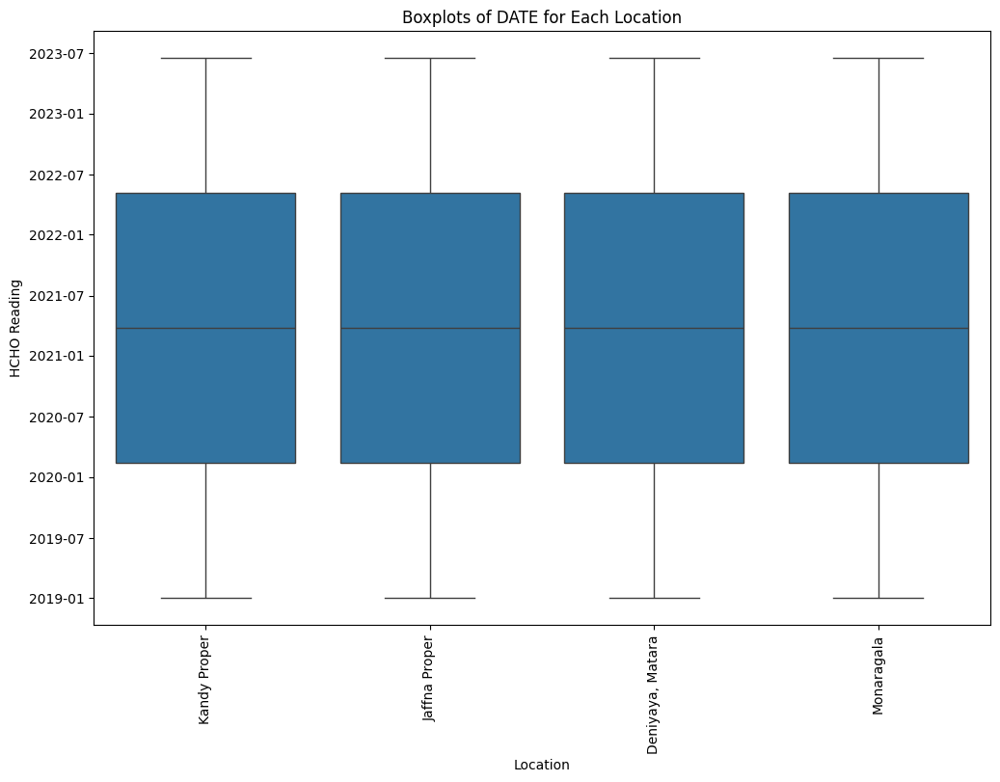

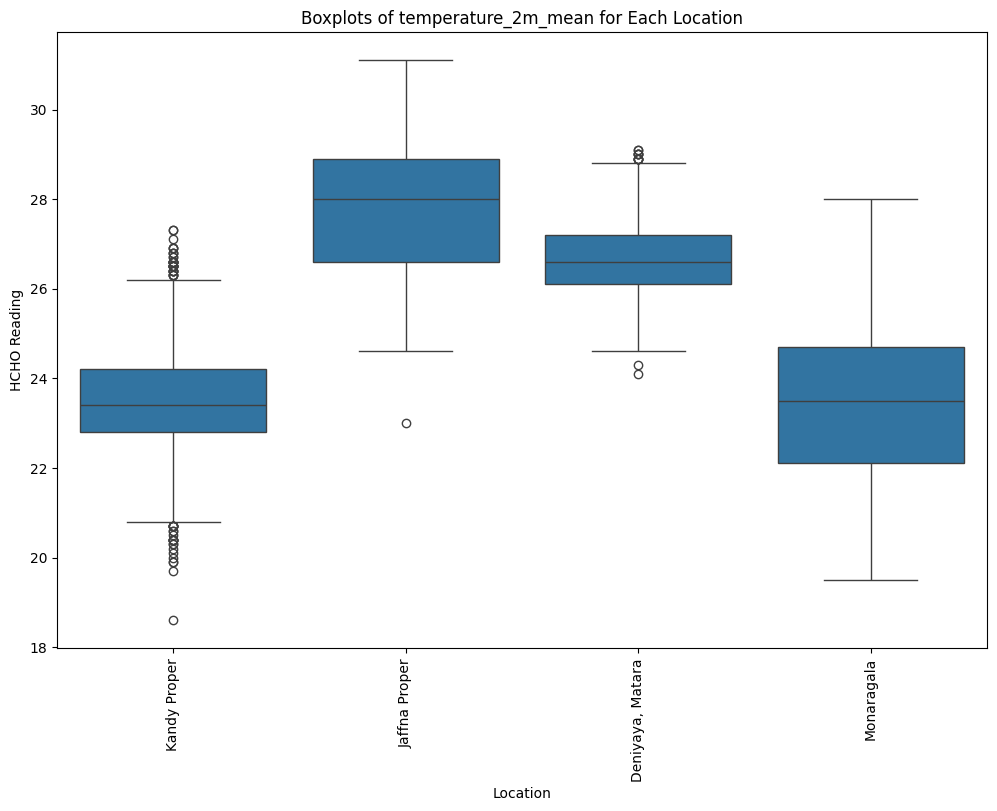

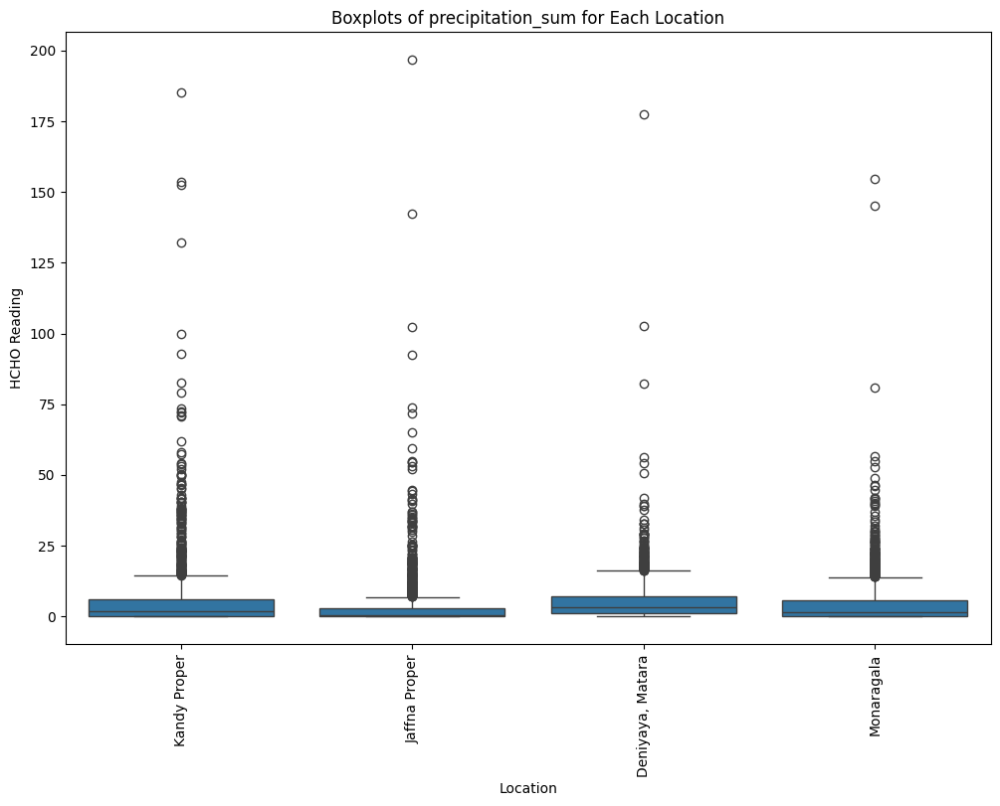

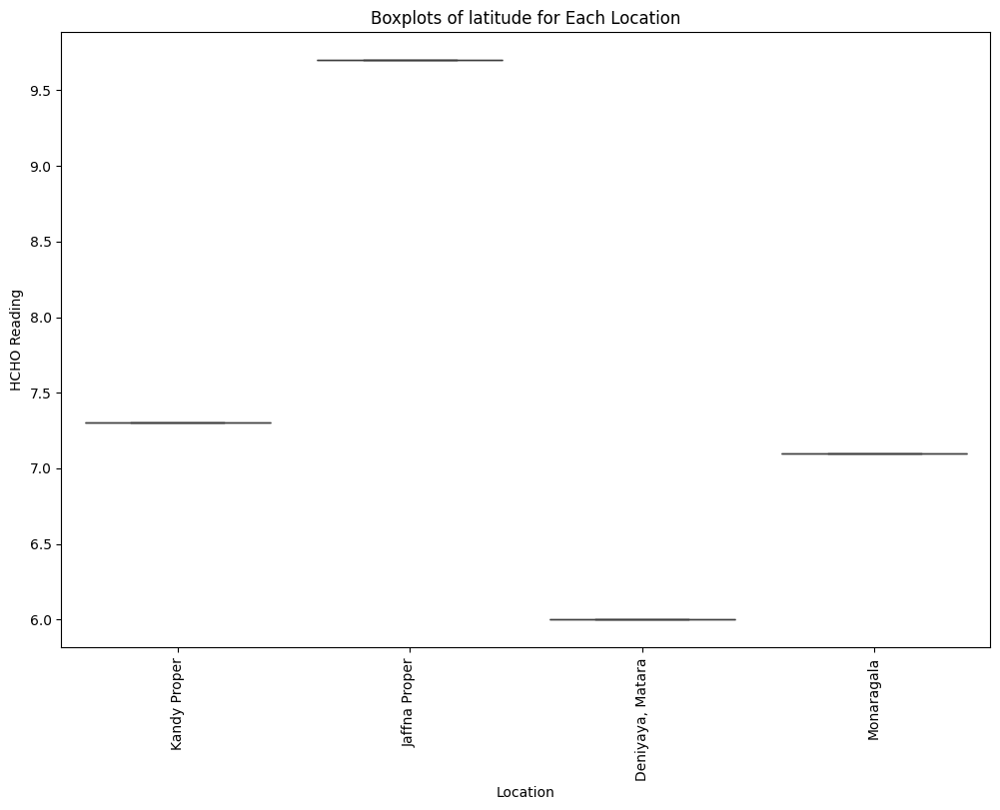

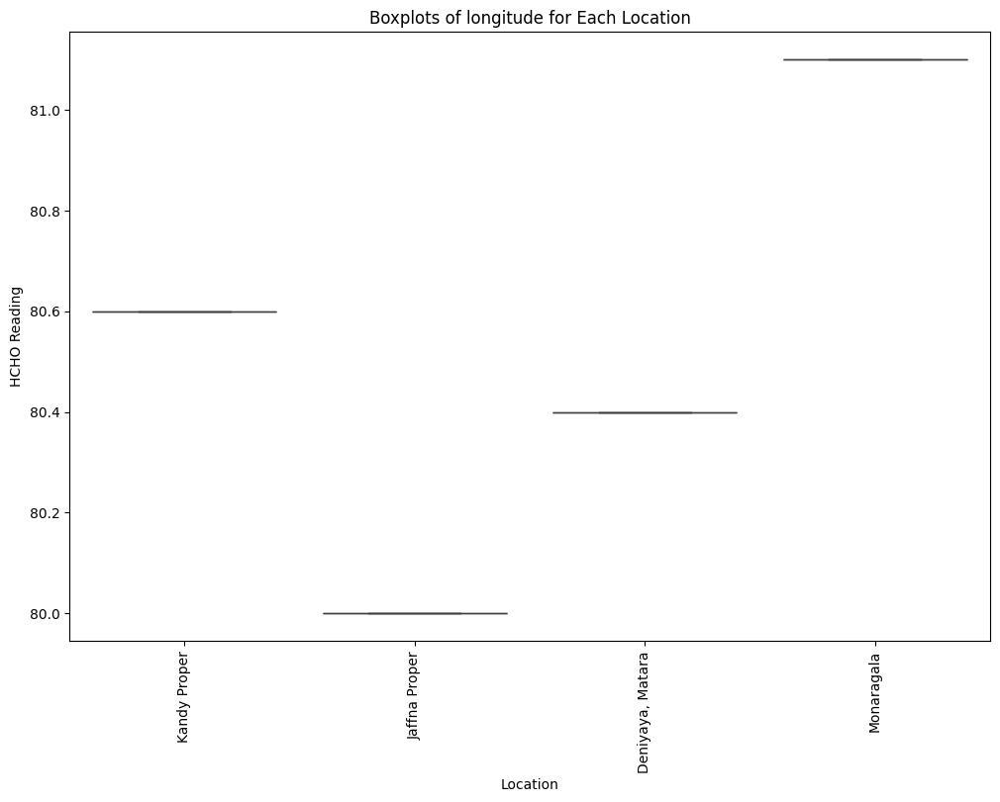

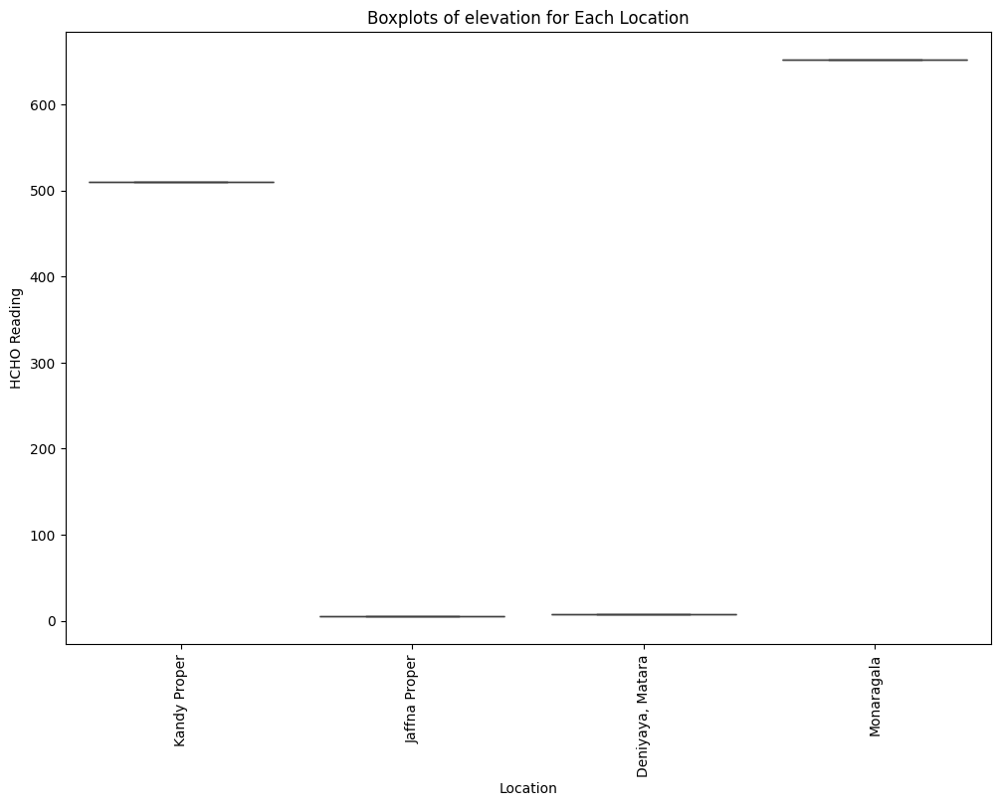

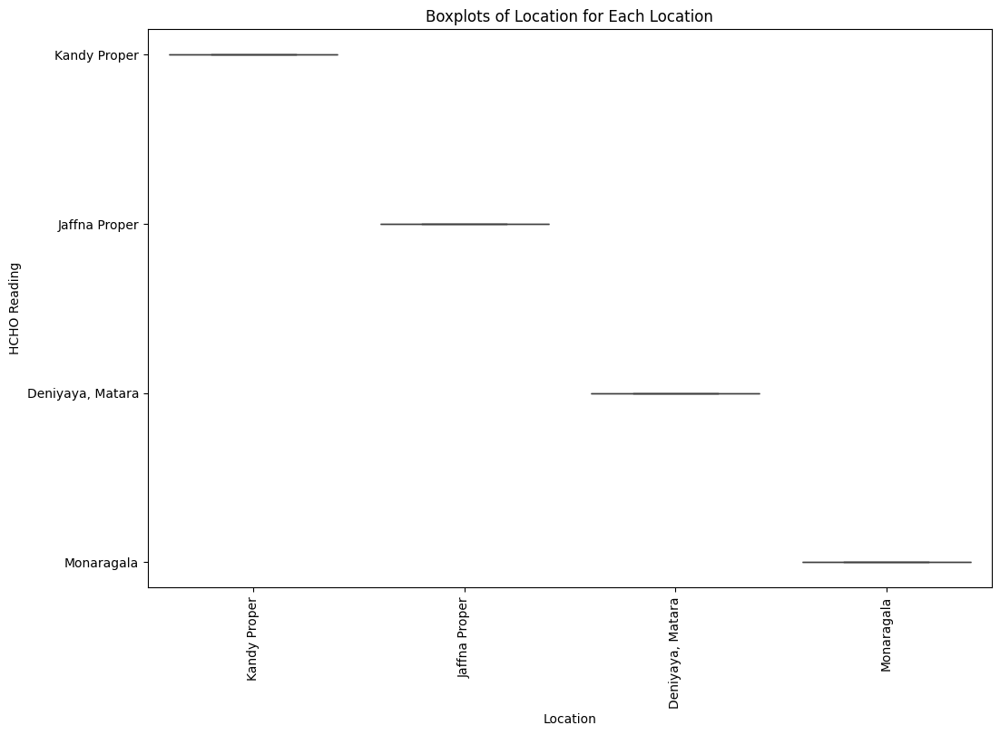

In [ ]:
#@title Handle Outliers in the weather dataset

#selecting data that is considered for the research
data_columns = ['temperature_2m_mean', 'precipitation_sum', 'latitude', 'longitude', 'elevation']

# Recheck the boxplot for each location again for outliers
for column in new_weather_external_df.columns:
    plt.figure(figsize=(12, 8))
    sns.boxplot(x='Location', y=column, data=new_weather_external_df)
    plt.title(f'Boxplots of {column} for Each Location')
    plt.xlabel('Location')
    plt.ylabel('HCHO Reading')
    plt.xticks(rotation=90)
    plt.show()

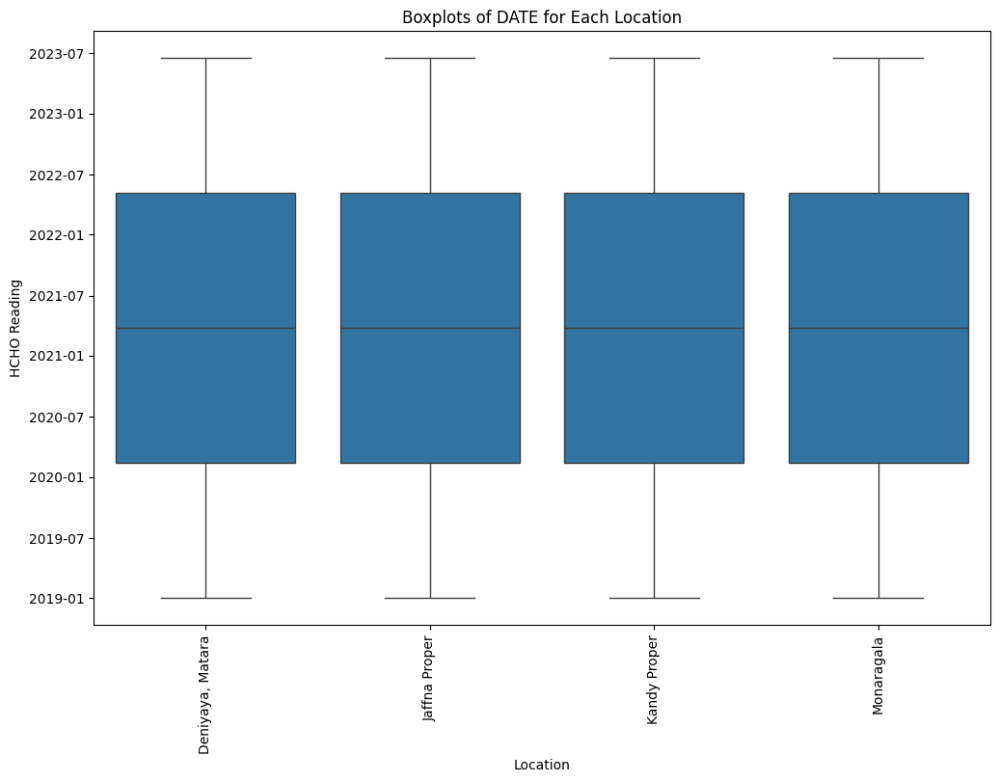

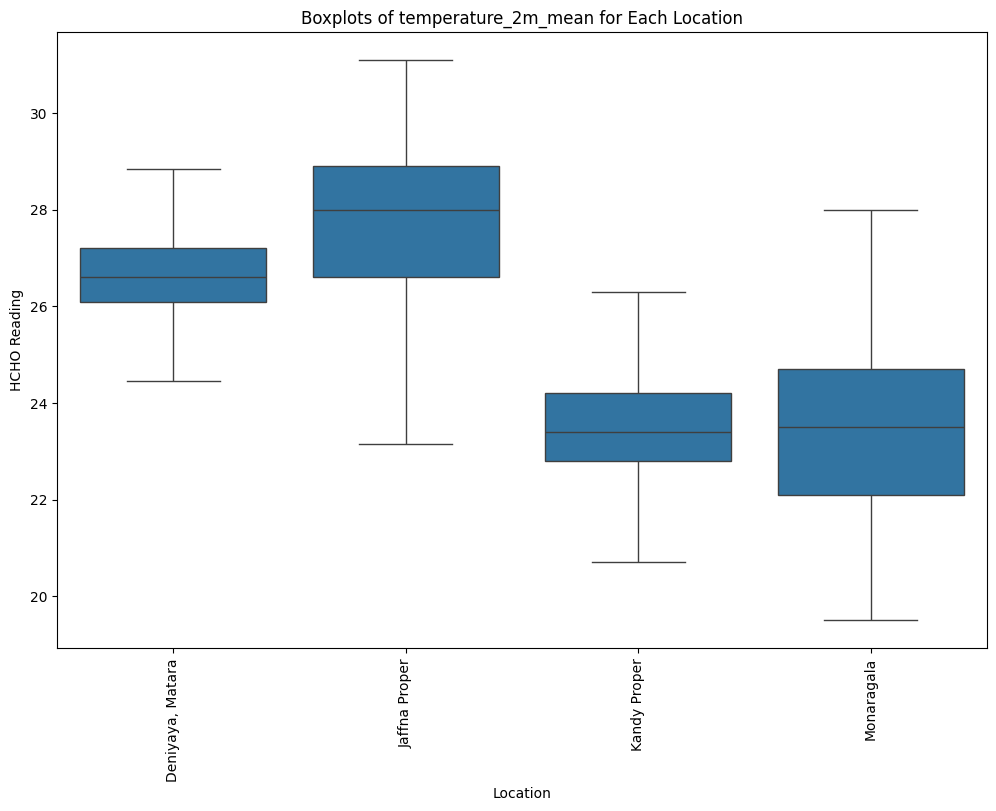

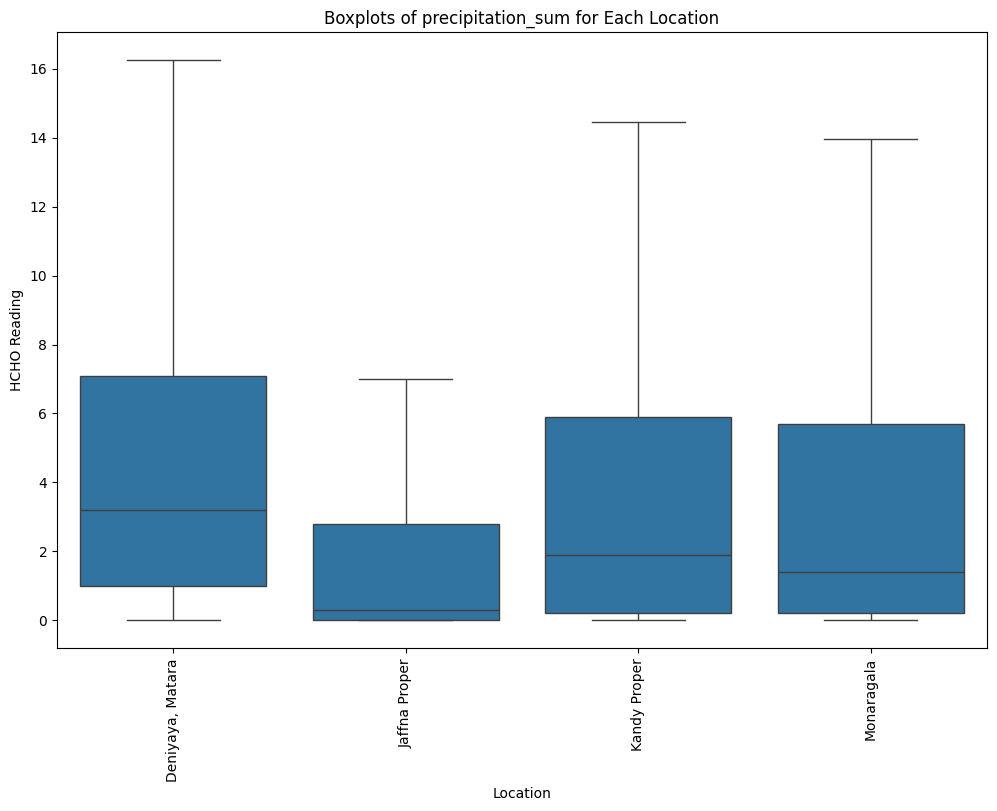

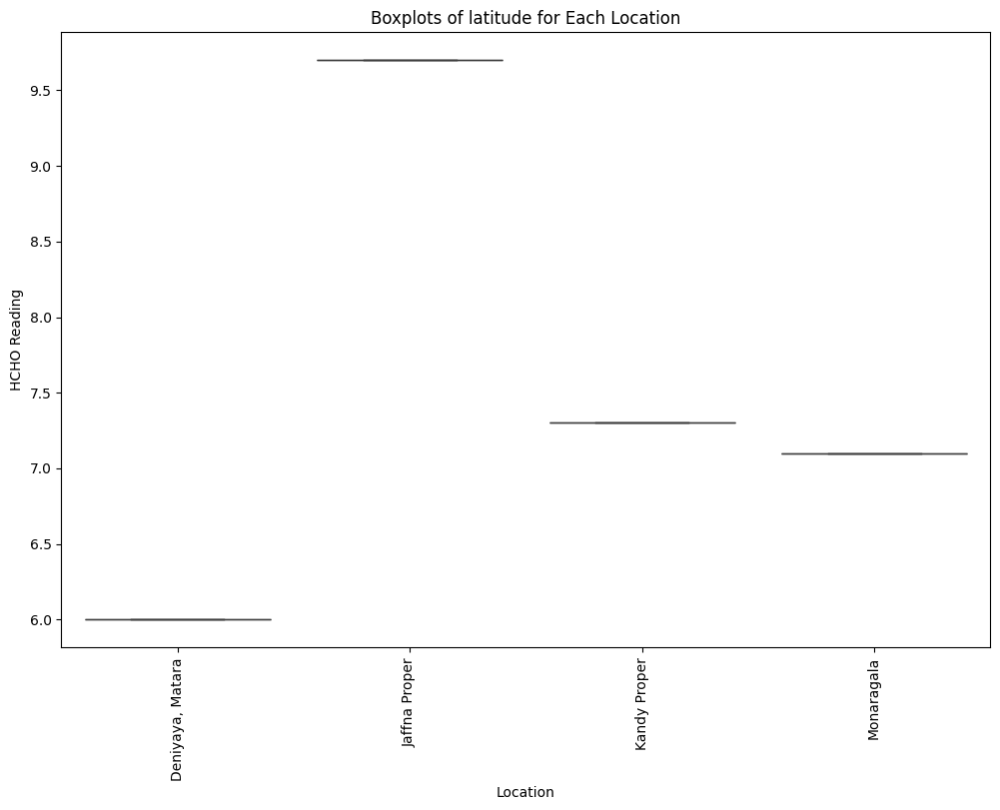

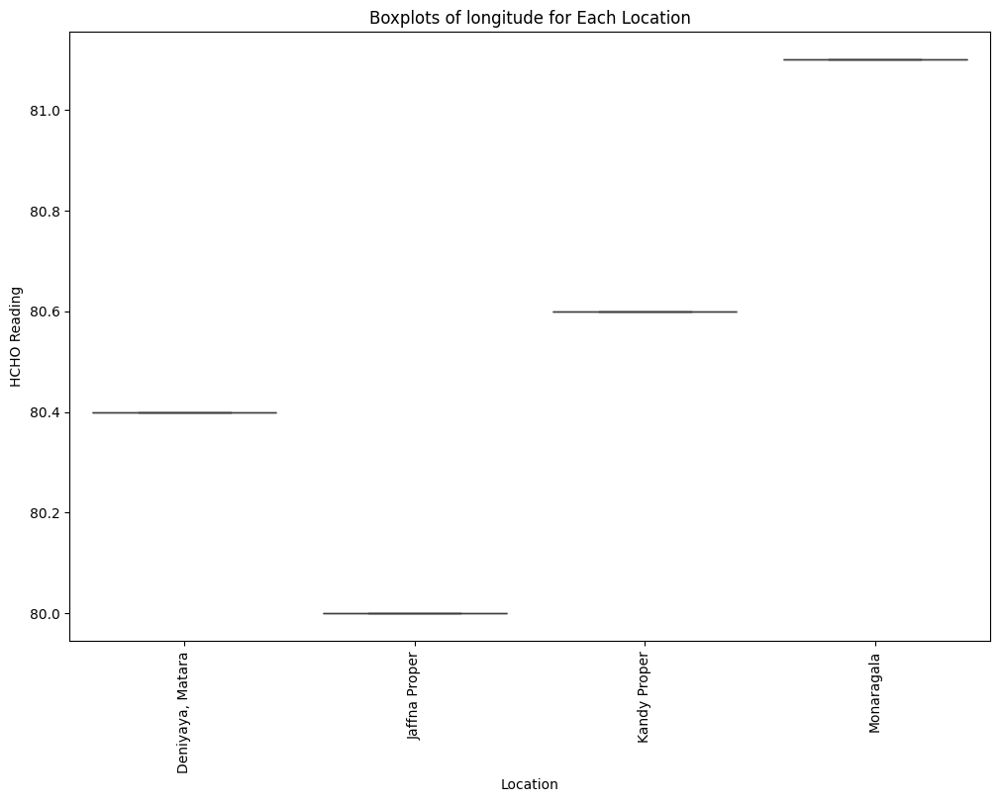

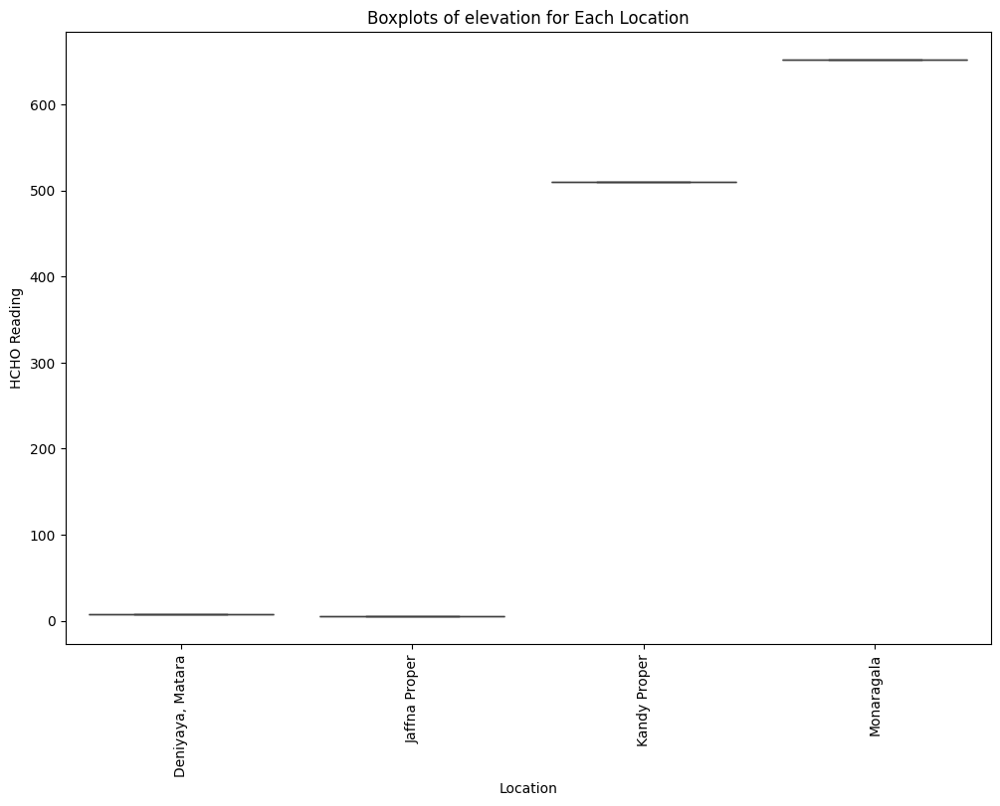

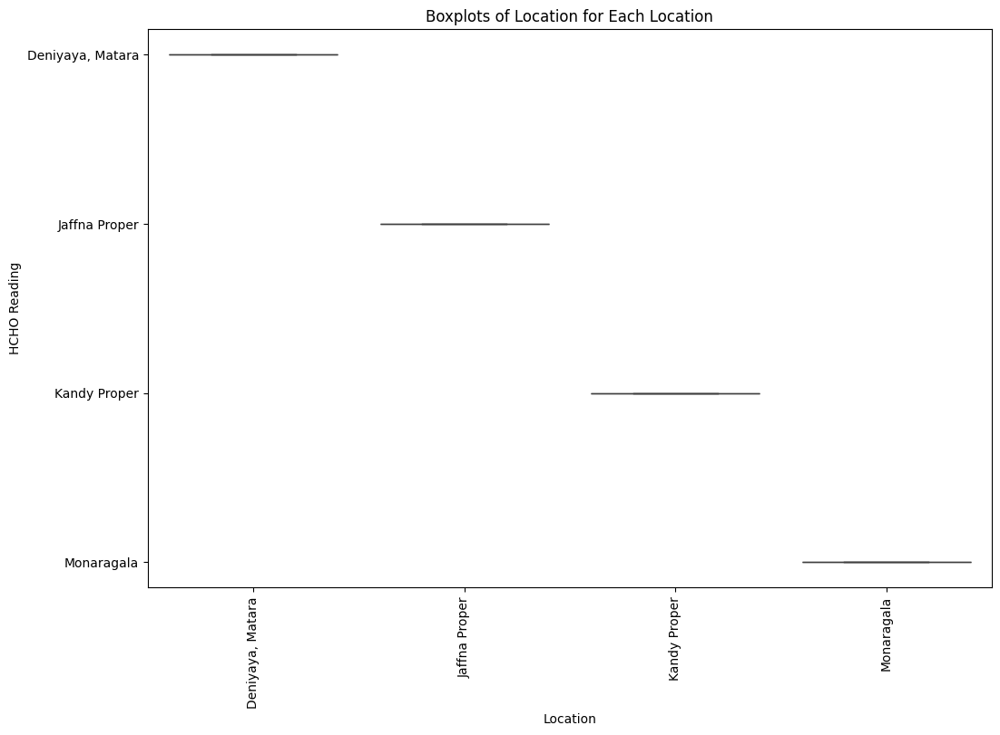

In [ ]:
def trim_outliers(group, column):
  # Calculate Q1 (25th percentile) and Q3 (75th percentile)
  q1 = group[column].quantile(0.25)
  q3 = group[column].quantile(0.75)

  # Calculate IQR
  iqr = q3 - q1

  # Calculate lower and upper bounds
  lower_bound = q1 - 1.5 * iqr
  upper_bound = q3 + 1.5 * iqr

  # Trim values outside the bounds
  group[column] = group[column].clip(lower=lower_bound, upper=upper_bound)

  return group

# Apply the function to each location separately
columns_to_trim = ['temperature_2m_mean', 'precipitation_sum']

for column in columns_to_trim:
    new_weather_external_df = new_weather_external_df.groupby('Location').apply(trim_outliers, column=column).reset_index(drop=True)

for column in new_weather_external_df.columns:
    plt.figure(figsize=(12, 8))
    sns.boxplot(x='Location', y=column, data=new_weather_external_df)
    plt.title(f'Boxplots of {column} for Each Location')
    plt.xlabel('Location')
    plt.ylabel('HCHO Reading')
    plt.xticks(rotation=90)
    plt.show()

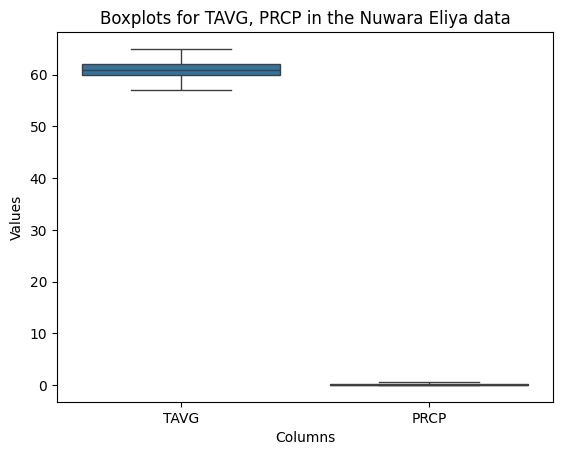

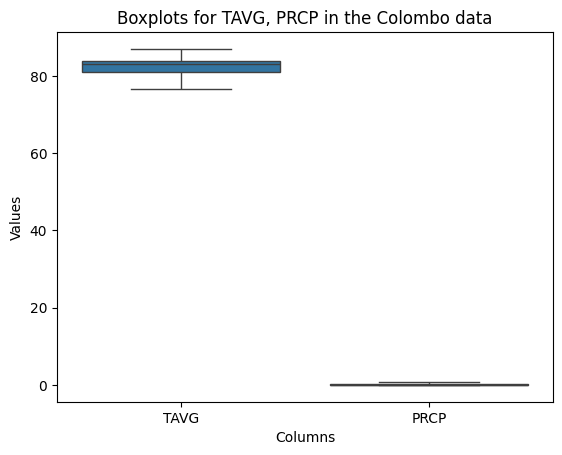

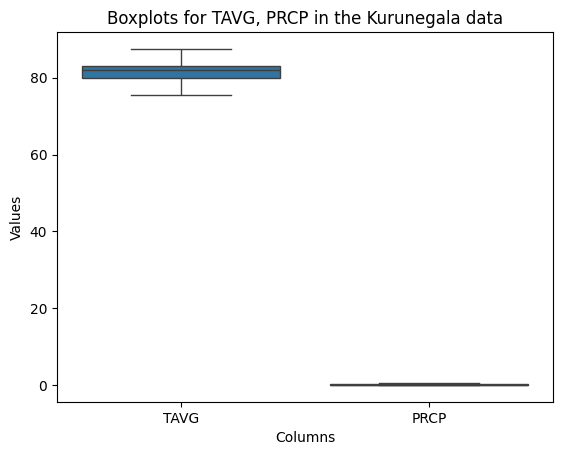

In [ ]:
# @title Handle Outliers in colombo, kurunegala, nuwara eliya datasets
data = [colombo_external_df, kurunegala_external_df, nuwaraeliya_external_df]
columns_to_trim = ['TAVG', 'PRCP']

# Loop through each DataFrame
for df in data:
    # Apply the trim_outliers function to each column in the DataFrame
    for column in columns_to_trim:
        df = trim_outliers(df, column)

# Plot boxplots for the columns TAVG
sns.boxplot(data=nuwaraeliya_external_df[['TAVG', 'PRCP']])
plt.title('Boxplots for TAVG, PRCP in the Nuwara Eliya data')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.show()

sns.boxplot(data=colombo_external_df[['TAVG', 'PRCP']])
plt.title('Boxplots for TAVG, PRCP in the Colombo data')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.show()

sns.boxplot(data=kurunegala_external_df[['TAVG', 'PRCP']])
plt.title('Boxplots for TAVG, PRCP in the Kurunegala data')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.show()

In [ ]:
# @title Add the needed data columns from the weather dataset (longitudinal data, latitudinal data, Elevation)

colombo_data = weather_external_df[weather_external_df['Location'] == 'Colombo'].iloc[0]
kurunegala_data = weather_external_df[weather_external_df['Location'] == 'Kurunegala'].iloc[0]

longitude_c = colombo_data['longitude']
latitude_c = colombo_data['latitude']
elevation_c = colombo_data['elevation']

longitude_k = kurunegala_data['longitude']
latitude_k = kurunegala_data['latitude']
elevation_k = kurunegala_data['elevation']

longitude_nuw = 80.7829
latitude_nuw = 6.97078
elevation_nuw = 1868

colombo_external_df["LONGITUDE"] = longitude_c
colombo_external_df["LATITUDE"] = latitude_c
colombo_external_df["ELEVATION"] = elevation_c

kurunegala_external_df["LONGITUDE"] = longitude_k
kurunegala_external_df["LATITUDE"] = latitude_k
kurunegala_external_df["ELEVATION"] = elevation_k

nuwaraeliya_external_df["LONGITUDE"] = longitude_nuw
nuwaraeliya_external_df["LATITUDE"] = latitude_nuw
nuwaraeliya_external_df["ELEVATION"] = elevation_nuw

In [ ]:
new_weather_external_df.rename(columns={'temperature_2m_mean': 'TAVG', 'precipitation_sum': 'PRCP', 'latitude': 'LATITUDE', 'longitude': 'LONGITUDE', 'elevation': 'ELEVATION'}, inplace=True)
new_weather_external_df

,DATE,TAVG,PRCP,LATITUDE,LONGITUDE,ELEVATION,Location
0,2019-01-01,26.2,0.4,6.000000,80.399994,7.0,"Deniyaya, Matara"
1,2019-01-02,26.1,0.3,6.000000,80.399994,7.0,"Deniyaya, Matara"
2,2019-01-03,26.3,0.1,6.000000,80.399994,7.0,"Deniyaya, Matara"
3,2019-01-04,26.0,0.9,6.000000,80.399994,7.0,"Deniyaya, Matara"
4,2019-01-05,26.2,1.2,6.000000,80.399994,7.0,"Deniyaya, Matara"
...,...,...,...,...,...,...,...
6511,2023-06-13,25.9,2.1,7.099998,81.100006,652.0,Monaragala
6512,2023-06-14,26.5,2.6,7.099998,81.100006,652.0,Monaragala
6513,2023-06-15,26.4,2.6,7.099998,81.100006,652.0,Monaragala
6514,2023-06-16,26.7,0.4,7.099998,81.100006,652.0,Monaragala


In [ ]:
#@title Merge into one dataset
combined_external_df = pd.concat([colombo_external_df, kurunegala_external_df, nuwaraeliya_external_df, new_weather_external_df], axis=0)

print('Rows: {} Columns: {}'.format(combined_external_df.shape[0], combined_external_df.shape[1]))
combined_external_df.head()

Rows: 11746 Columns: 7


,Location,DATE,PRCP,TAVG,LONGITUDE,LATITUDE,ELEVATION
0,Colombo Proper,2019-01-01,0.0,81.0,79.899994,7.0,16.0
1,Colombo Proper,2019-01-02,0.0,78.0,79.899994,7.0,16.0
2,Colombo Proper,2019-01-03,0.0,81.0,79.899994,7.0,16.0
3,Colombo Proper,2019-01-04,0.0,81.0,79.899994,7.0,16.0
4,Colombo Proper,2019-01-05,0.0,81.0,79.899994,7.0,16.0


In [ ]:
# @title Merge into the original dataset
combined_external_df.rename(columns={'DATE': 'Current Date'}, inplace=True)

combined_df_1 = combined_df.copy()
combined_df_1['Location'] = combined_df_1['Location'].replace('Bibile, Monaragala', 'Monaragala')

merged_df = pd.merge(combined_df_1, combined_external_df, on=['Current Date', 'Location'], how='inner')
merged_df

,HCHO reading,Location,Current Date,Next Date,PRCP,TAVG,LONGITUDE,LATITUDE,ELEVATION
0,0.000019,Monaragala,2019-01-02,2019-01-03,0.10,20.1,81.100006,7.099998,652.0
1,0.000028,Monaragala,2019-01-03,2019-01-04,0.00,20.6,81.100006,7.099998,652.0
2,0.000037,Monaragala,2019-01-04,2019-01-05,0.00,20.4,81.100006,7.099998,652.0
3,-0.000018,Monaragala,2019-01-05,2019-01-06,0.00,21.1,81.100006,7.099998,652.0
4,0.000146,Monaragala,2019-01-06,2019-01-07,0.00,20.5,81.100006,7.099998,652.0
...,...,...,...,...,...,...,...,...,...
11738,0.000237,Nuwara Eliya Proper,2023-12-27,2023-12-28,0.35,61.0,80.782900,6.970780,1868.0
11739,0.000237,Nuwara Eliya Proper,2023-12-28,2023-12-29,0.50,61.0,80.782900,6.970780,1868.0
11740,0.000237,Nuwara Eliya Proper,2023-12-29,2023-12-30,0.50,60.0,80.782900,6.970780,1868.0
11741,0.000237,Nuwara Eliya Proper,2023-12-30,2023-12-31,0.21,60.0,80.782900,6.970780,1868.0


In [ ]:
merged_df.isnull().sum()

HCHO reading    0
Location        0
Current Date    0
Next Date       0
PRCP            0
TAVG            0
LONGITUDE       0
LATITUDE        0
ELEVATION       0
dtype: int64

**Population Data**

In [ ]:
# Define the file paths for the population datasets
population_file = '/content/drive/My Drive/Yr_2/Sem_2/Data_Engineering /Course_Work/Dataset/External Data/population_data.csv'

# Load the CSV files using Pandas
population_df = pd.read_csv(population_file)
population_df

,city,country,pop2024,latitude,longitude
0,Colombo,Sri Lanka,648034,6.93194,79.8478
1,Dehiwala-Mount Lavinia,Sri Lanka,219827,6.84019,79.8712
2,Moratuwa,Sri Lanka,185031,6.77300,79.8816
3,Jaffna,Sri Lanka,169102,9.66845,80.0074
4,Negombo,Sri Lanka,137223,7.20830,79.8358
...,...,...,...,...,...
60,Horana South,Sri Lanka,8982,6.71590,80.0626
61,Wattegama,Sri Lanka,8000,6.79890,81.4808
62,Minuwangoda,Sri Lanka,7772,7.16630,79.9533
63,Horawala Junction,Sri Lanka,7500,6.48088,80.1271


In [ ]:
population_df.info()
print("\n")
population_df.describe().T

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65 entries, 0 to 64
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   city       65 non-null     object 
 1   country    65 non-null     object 
 2   pop2024    65 non-null     int64  
 3   latitude   65 non-null     float64
 4   longitude  65 non-null     float64
dtypes: float64(2), int64(1), object(2)
memory usage: 2.7+ KB




,count,mean,std,min,25%,50%,75%,max
pop2024,65.0,60835.553846,86477.593114,6877.00000,21000.0000,34664.00000,75633.0000,648034.00000
latitude,65.0,7.206149,0.862673,5.92825,6.7989,6.97078,7.4688,9.81667
longitude,65.0,80.366177,0.573380,79.79530,79.9071,80.08520,80.6217,81.83470


In [ ]:
population_df.isnull().sum()

city         0
country      0
pop2024      0
latitude     0
longitude    0
dtype: int64

In [ ]:
col = ['latitude', 'longitude', 'country']
population_df.drop(columns = col, inplace=True)
population_df.head()

,city,pop2024
0,Colombo,648034
1,Dehiwala-Mount Lavinia,219827
2,Moratuwa,185031
3,Jaffna,169102
4,Negombo,137223


In [ ]:
population_df = population_df.rename(columns={'pop2024': 'population_2024'})
population_df.head()

,city,population_2024
0,Colombo,648034
1,Dehiwala-Mount Lavinia,219827
2,Moratuwa,185031
3,Jaffna,169102
4,Negombo,137223


In [ ]:
population_df['city'].unique()

array(['Colombo', 'Dehiwala-Mount Lavinia', 'Moratuwa', 'Jaffna',
       'Negombo', 'Pita Kotte', 'Sri Jayewardenepura Kotte', 'Kandy',
       'Trincomalee', 'Kalmunai', 'Galle', 'Point Pedro', 'Batticaloa',
       'Katunayaka', 'Valvedditturai', 'Matara', 'Battaramulla South',
       'Dambulla', 'Maharagama', 'Kotikawatta', 'Anuradhapura',
       'Vavuniya', 'Kolonnawa', 'Hendala', 'Ratnapura', 'Badulla',
       'Puttalam', 'Devinuwara', 'Welisara', 'Kalutara', 'Bentota',
       'Matale', 'Homagama', 'Beruwala', 'Panadura', 'Mulleriyawa',
       'Kandana', 'Ja Ela', 'Wattala', 'Peliyagoda', 'Kelaniya',
       'Kurunegala', 'Nuwara Eliya', 'Gampola', 'Chilaw', 'Eravur Town',
       'Hanwella Ihala', 'Weligama', 'Vakarai', 'Kataragama',
       'Ambalangoda', 'Ampara', 'Kegalle', 'Hatton', 'Polonnaruwa',
       'Kilinochchi', 'Tangalle', 'Monaragala', 'Wellawaya', 'Gampaha',
       'Horana South', 'Wattegama', 'Minuwangoda', 'Horawala Junction',
       'Kuliyapitiya'], dtype=object)

In [ ]:
locations_needed = ['Colombo', 'Jaffna', 'Kurunegala', 'Nuwara Eliya', 'Matara', 'Kandy', 'Monaragala']

population_df = population_df[population_df['city'].isin(locations_needed)]
population_df = population_df.rename(columns={'city': 'Location'})
population_df['Location'].unique()

array(['Colombo', 'Jaffna', 'Kandy', 'Matara', 'Kurunegala',
       'Nuwara Eliya', 'Monaragala'], dtype=object)

In [ ]:
location_replacements = {
    'Jaffna': 'Jaffna Proper',
    'Colombo': 'Colombo Proper',
    'Kurunegala': 'Kurunegala Proper',
    'Kandy': 'Kandy Proper',
    'Matara': 'Deniyaya, Matara',
    'Nuwara Eliya': 'Nuwara Eliya Proper'
}
population_df['Location'] = population_df['Location'].replace(location_replacements)
population_df['Location'].unique()

array(['Colombo Proper', 'Jaffna Proper', 'Kandy Proper',
       'Deniyaya, Matara', 'Kurunegala Proper', 'Nuwara Eliya Proper',
       'Monaragala'], dtype=object)

In [ ]:
merged_df = pd.merge(merged_df, population_df, on=['Location'], how='inner')
merged_df

,HCHO reading,Location,Current Date,Next Date,PRCP,TAVG,LONGITUDE,LATITUDE,ELEVATION,population_2024
0,0.000019,Monaragala,2019-01-02,2019-01-03,0.10,20.1,81.100006,7.099998,652.0,10236
1,0.000028,Monaragala,2019-01-03,2019-01-04,0.00,20.6,81.100006,7.099998,652.0,10236
2,0.000037,Monaragala,2019-01-04,2019-01-05,0.00,20.4,81.100006,7.099998,652.0,10236
3,-0.000018,Monaragala,2019-01-05,2019-01-06,0.00,21.1,81.100006,7.099998,652.0,10236
4,0.000146,Monaragala,2019-01-06,2019-01-07,0.00,20.5,81.100006,7.099998,652.0,10236
...,...,...,...,...,...,...,...,...,...,...
11738,0.000237,Nuwara Eliya Proper,2023-12-27,2023-12-28,0.35,61.0,80.782900,6.970780,1868.0,25775
11739,0.000237,Nuwara Eliya Proper,2023-12-28,2023-12-29,0.50,61.0,80.782900,6.970780,1868.0,25775
11740,0.000237,Nuwara Eliya Proper,2023-12-29,2023-12-30,0.50,60.0,80.782900,6.970780,1868.0,25775
11741,0.000237,Nuwara Eliya Proper,2023-12-30,2023-12-31,0.21,60.0,80.782900,6.970780,1868.0,25775


In [ ]:
from google.colab import files

merged_df.to_csv('Final_Dataset.csv', index=False)
files.download('Final_Dataset.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### **Check for correlation**

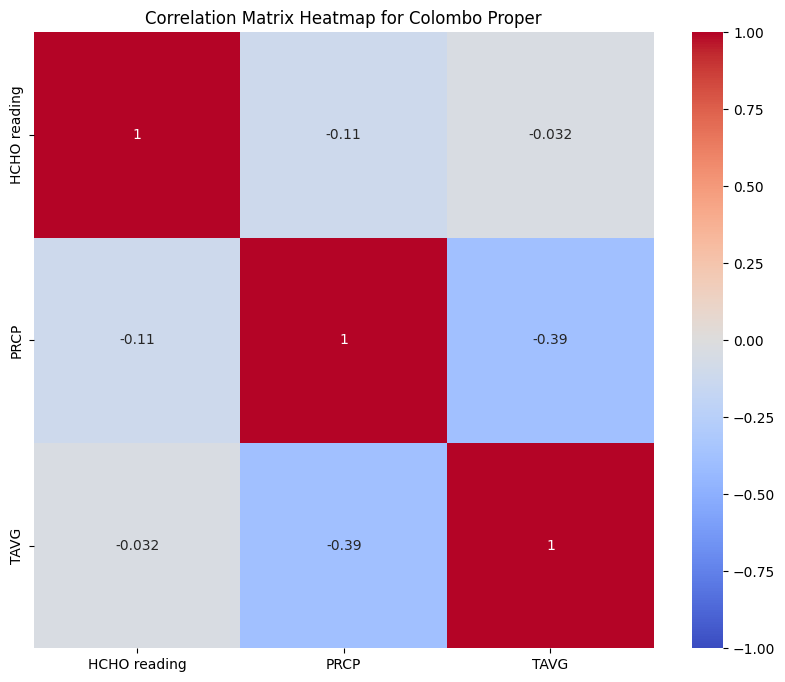

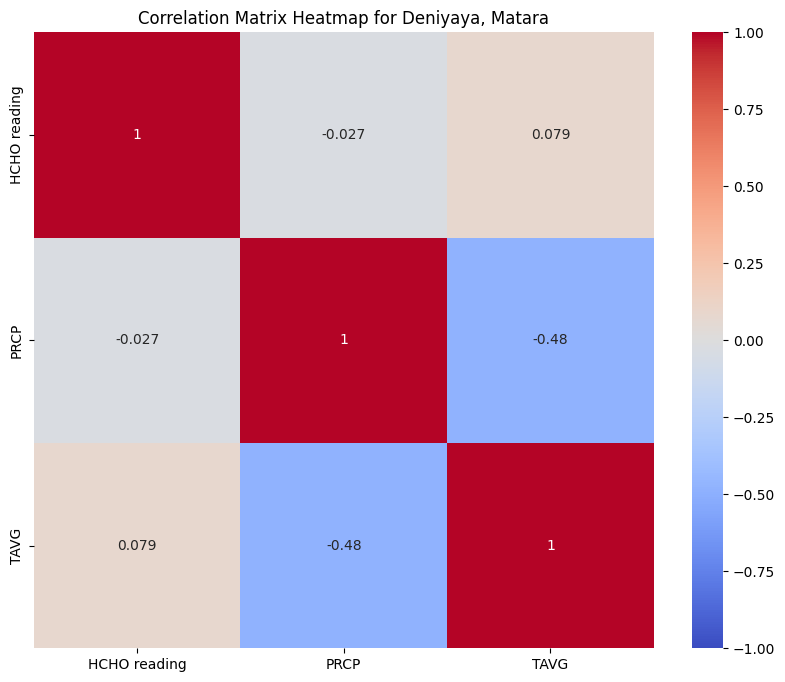

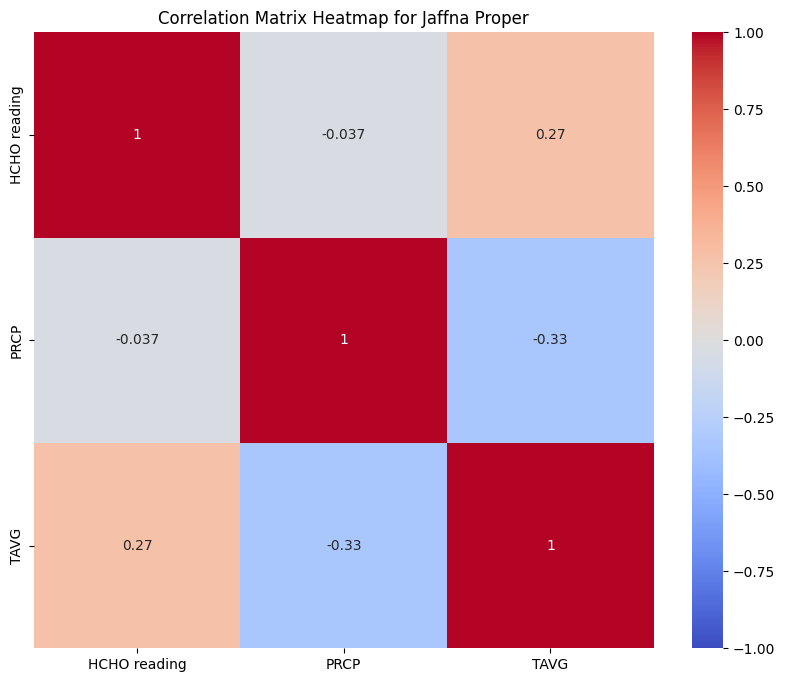

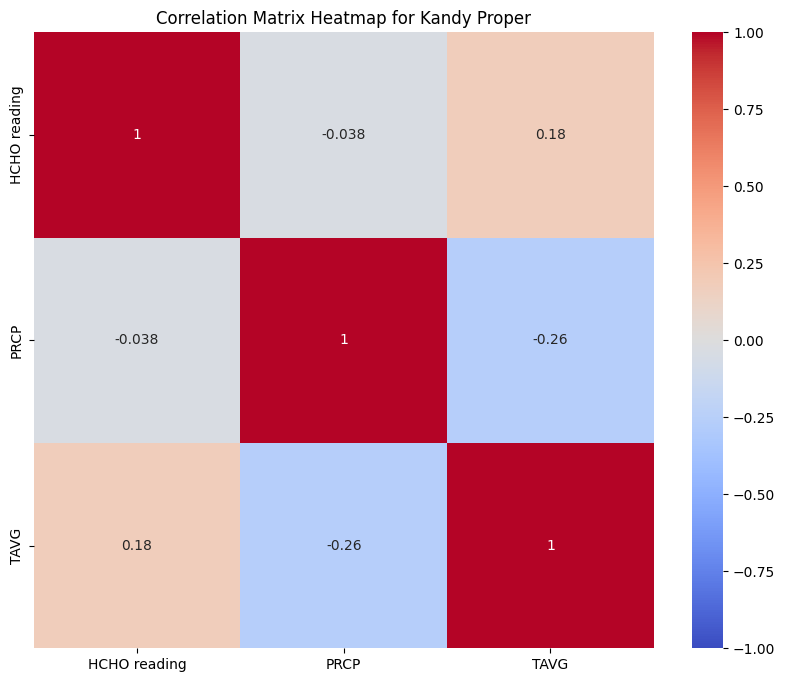

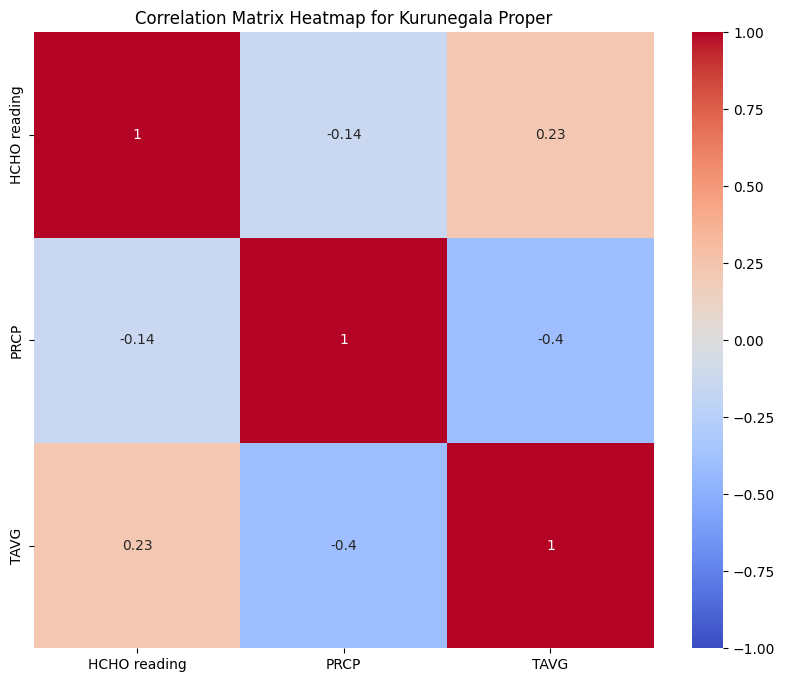

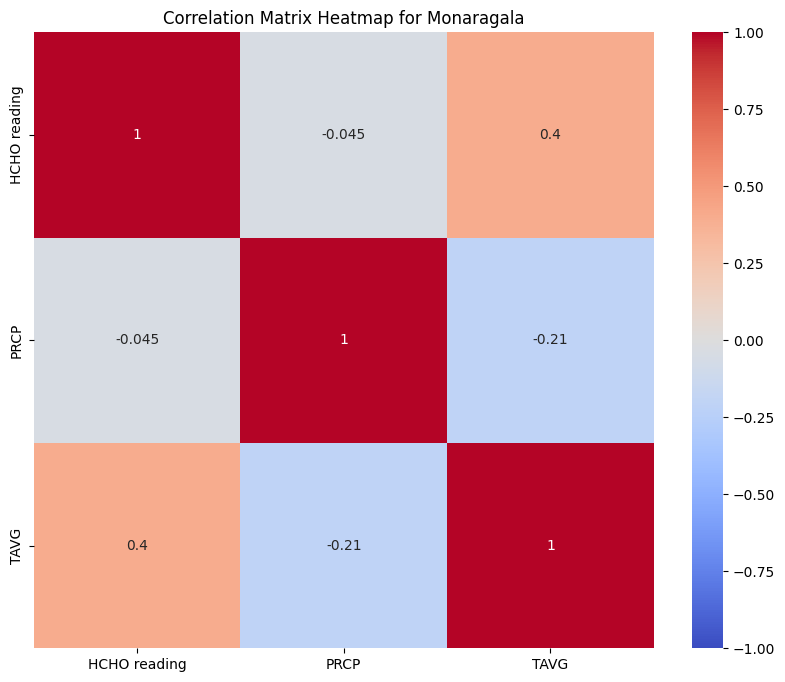

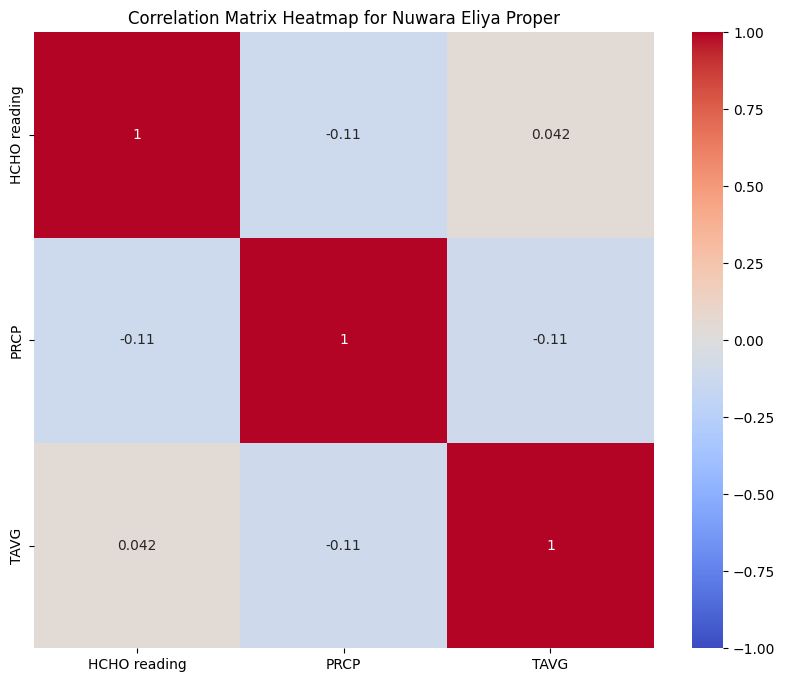

In [ ]:
cor_columns = ['HCHO reading', 'PRCP', 'TAVG']
grouped_cor_df = merged_df.groupby('Location')

for location, group in grouped_cor_df:
    # Calculate the correlation matrix for the specified columns
    correlation_matrix = group[cor_columns].corr()

    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
    plt.title(f'Correlation Matrix Heatmap for {location}')

    # Display the heatmap
    plt.show()

## **Compare spatial patterns:**

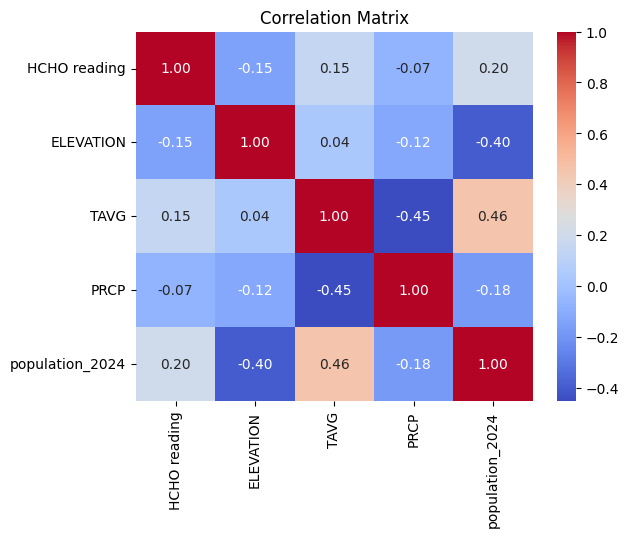

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'merged_df' contains the relevant data with columns: 'HCHO reading', 'Latitude', 'Longitude', 'Elevation', 'Distance to Sea', etc.

# Correlation analysis
correlation_matrix = merged_df[['HCHO reading', 'ELEVATION', 'TAVG', 'PRCP', 'population_2024']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

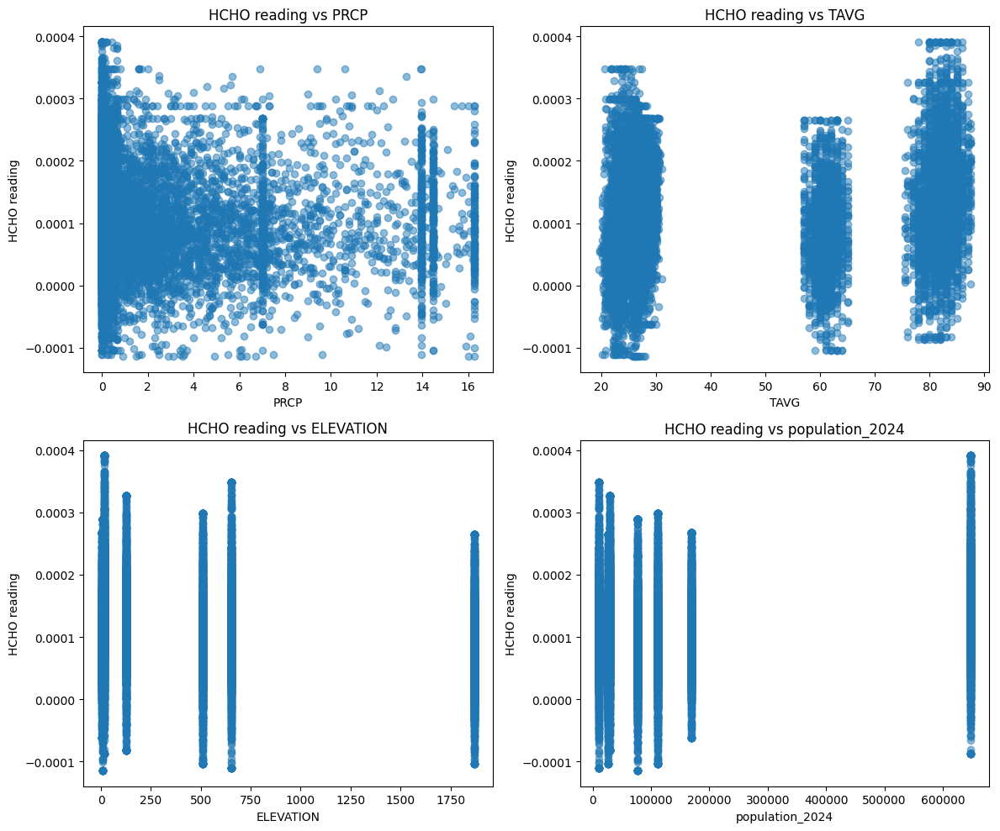

In [ ]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# Scatter plot of HCHO reading vs PRCP
axs[0, 0].scatter(merged_df['PRCP'], merged_df['HCHO reading'], alpha=0.5)
axs[0, 0].set_title('HCHO reading vs PRCP')
axs[0, 0].set_xlabel('PRCP')
axs[0, 0].set_ylabel('HCHO reading')

# Scatter plot of HCHO reading vs TAVG
axs[0, 1].scatter(merged_df['TAVG'], merged_df['HCHO reading'], alpha=0.5)
axs[0, 1].set_title('HCHO reading vs TAVG')
axs[0, 1].set_xlabel('TAVG')
axs[0, 1].set_ylabel('HCHO reading')

# Scatter plot of HCHO reading vs ELEVATION
axs[1, 0].scatter(merged_df['ELEVATION'], merged_df['HCHO reading'], alpha=0.5)
axs[1, 0].set_title('HCHO reading vs ELEVATION')
axs[1, 0].set_xlabel('ELEVATION')
axs[1, 0].set_ylabel('HCHO reading')

# Scatter plot of HCHO reading vs population_2024
axs[1, 1].scatter(merged_df['population_2024'], merged_df['HCHO reading'], alpha=0.5)
axs[1, 1].set_title('HCHO reading vs population_2024')
axs[1, 1].set_xlabel('population_2024')
axs[1, 1].set_ylabel('HCHO reading')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
import folium
from folium.plugins import MarkerCluster

merged_df_new = merged_df.copy()
# Replace "Nuwara Eliya Proper" with "Nuwara Eliya"
merged_df_new['Location'] = merged_df_new['Location'].replace('Nuwara Eliya Proper', 'Nuwara Eliya')

# Filter the DataFrame for relevant columns
scatter_df = merged_df[['Location', 'HCHO reading', 'LATITUDE', 'LONGITUDE', 'PRCP', 'population_2024', 'ELEVATION', 'TAVG']].drop_duplicates()

# Create a base map
map_hcho = folium.Map(location=[scatter_df['LATITUDE'].mean(), scatter_df['LONGITUDE'].mean()], zoom_start=8)

# Create a MarkerCluster layer for better visualization of dense areas
marker_cluster = MarkerCluster().add_to(map_hcho)

# Add markers to the map for each location
for index, row in scatter_df.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=row['HCHO reading'] * 100,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.5,
        tooltip=f"{row['Location']}<br>HCHO Reading: {row['HCHO reading']}"
    ).add_to(marker_cluster)

# Display the map
map_hcho


Understanding the geographical locations of the studied areas is crucial for interpreting elevation data. In Colombo Proper, being coastal, lower elevations may influence air circulation and pollutant dispersion. Conversely, in Jaffna Proper, located in the north, elevation variations affect local weather patterns. Similarly, in Kandy Proper, central highlands may lead to cooler temperatures. In Deniyaya, Matara, elevation differences impact local climate conditions. Kurunegala Proper, in the northwest, experiences diverse elevation levels. Nuwara Eliya Proper, in the central highlands, has significant elevation differences. Lastly, Monaragala, in the southeast, may have lower elevations, influencing local climate and air quality. Understanding these geographic factors aids in interpreting elevation data and its implications for air quality management.

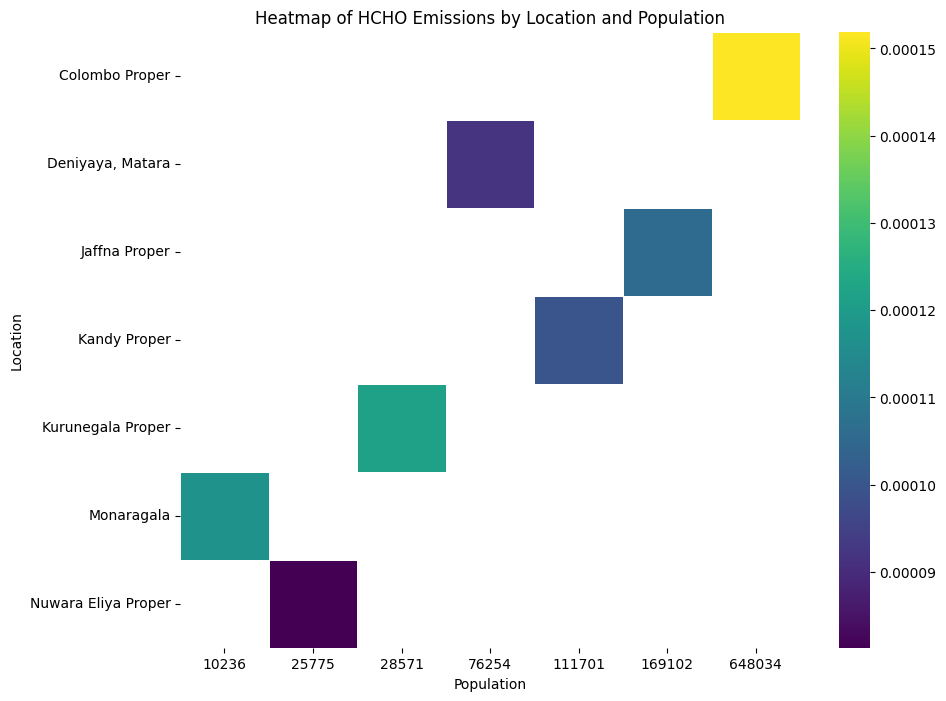

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pivot the DataFrame to create a matrix of HCHO readings indexed by location and population
heatmap_data = merged_df.pivot_table(index='Location', columns='population_2024', values='HCHO reading')

# Create the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, cmap='viridis', linewidths=0.5)

# Set labels and title
plt.xlabel('Population')
plt.ylabel('Location')
plt.title('Heatmap of HCHO Emissions by Location and Population')

# Show plot
plt.show()

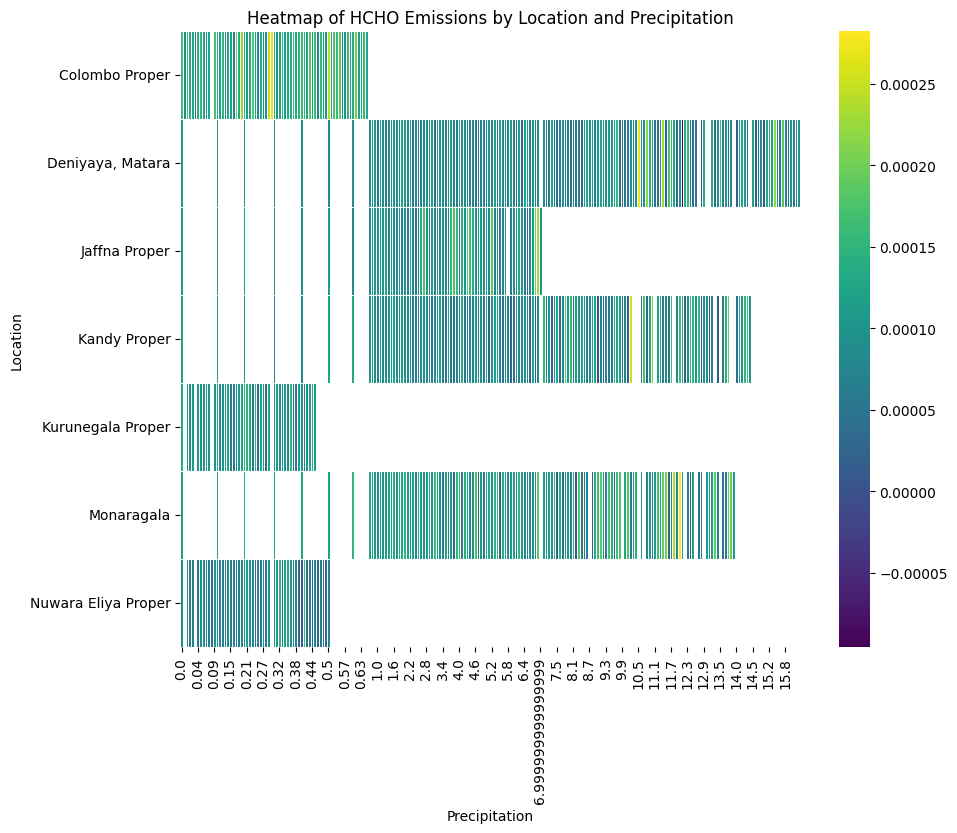

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pivot the DataFrame to create a matrix of HCHO readings indexed by location and population
heatmap_data = merged_df.pivot_table(index='Location', columns='PRCP', values='HCHO reading')

# Create the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, cmap='viridis', linewidths=0.5)

# Set labels and title
plt.xlabel('Precipitation')
plt.ylabel('Location')
plt.title('Heatmap of HCHO Emissions by Location and Precipitation')

# Show plot
plt.show()

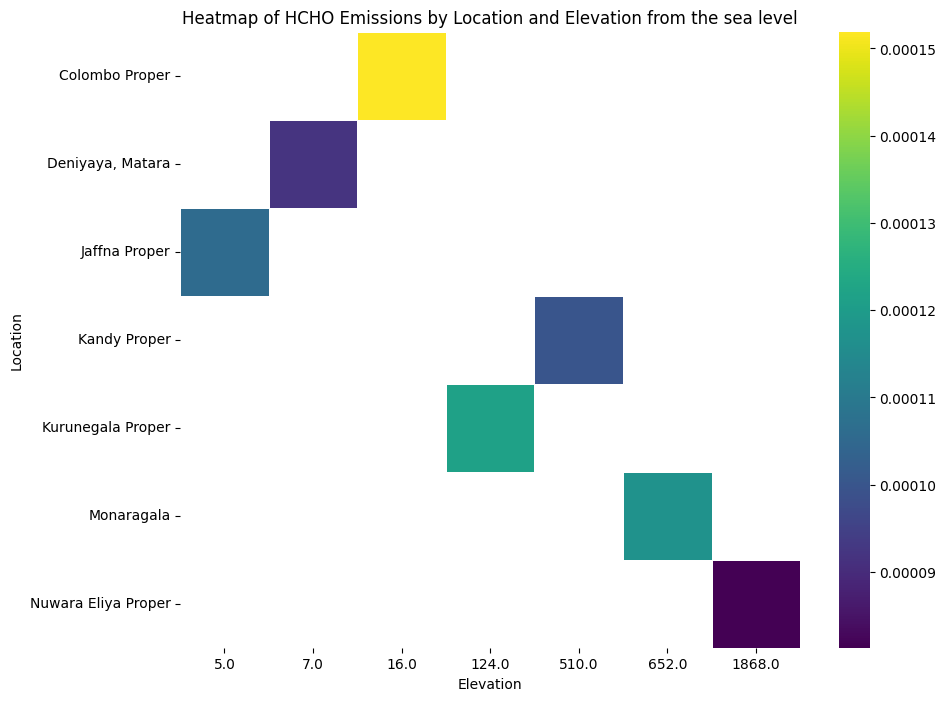

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pivot the DataFrame to create a matrix of HCHO readings indexed by location and population
heatmap_data = merged_df.pivot_table(index='Location', columns='ELEVATION', values='HCHO reading')

# Create the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, cmap='viridis', linewidths=0.5)

# Set labels and title
plt.xlabel('Elevation')
plt.ylabel('Location')
plt.title('Heatmap of HCHO Emissions by Location and Elevation from the sea level')

# Show plot
plt.show()

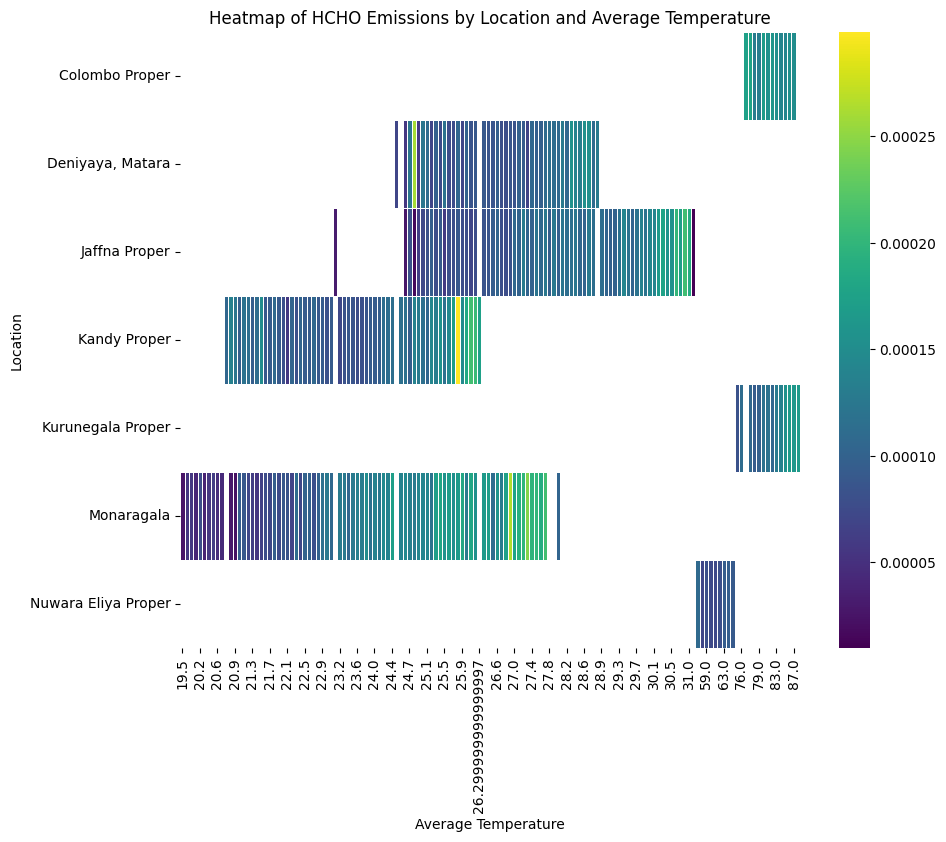

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pivot the DataFrame to create a matrix of HCHO readings indexed by location and population
heatmap_data = merged_df.pivot_table(index='Location', columns='TAVG', values='HCHO reading')

# Create the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(heatmap_data, cmap='viridis', linewidths=0.5)

# Set labels and title
plt.xlabel('Average Temperature')
plt.ylabel('Location')
plt.title('Heatmap of HCHO Emissions by Location and Average Temperature')

# Show plot
plt.show()

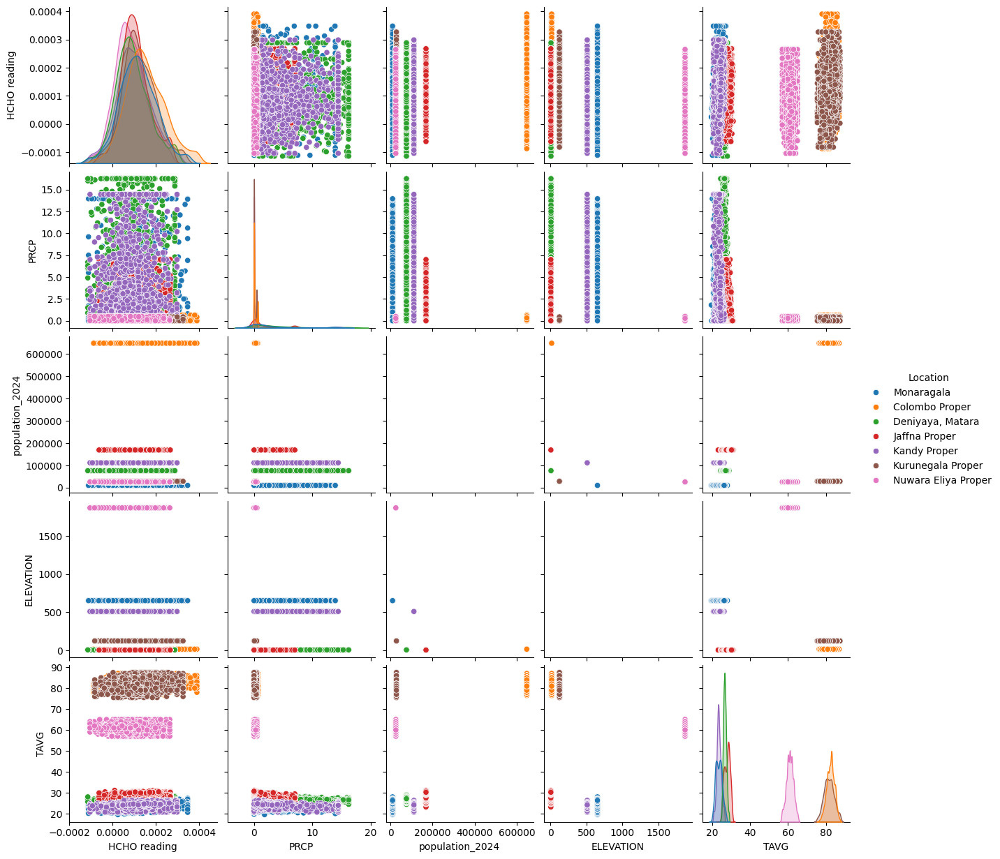

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select the columns for pairplot
columns = ['Location', 'HCHO reading', 'PRCP', 'population_2024', 'ELEVATION', 'TAVG']

# Filter the DataFrame to include only the selected columns
pairplot_data = merged_df[columns]

# Create pairplot
sns.pairplot(pairplot_data, hue='Location')
plt.show()


# **3. Machine Learning**

In [ ]:
!pip install pmdarima

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 9.9 MB/s eta 0:00:00


In [ ]:
import pmdarima
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from pmdarima import auto_arima

In [ ]:
import numpy as np

# Define a function to forecast HCHO readings for each location in 2024
def forecast_hcho_for_2024(df):
    # Create a date range for the year 2024
    forecast_period = pd.date_range(start='2024-01-01', end='2024-12-31', freq='D')

    # Create an empty DataFrame to store forecasts
    forecasts_df = pd.DataFrame({'Current Date': forecast_period})

    # Get a list of unique locations
    locations = df['Location'].unique()

    # Iterate over each location
    for location in locations:
        # Assuming 'com1' is your DataFrame containing the data
        # Historical features
        historical_features = ['Current Date']
        df1 = merged_df[merged_df['Location'] == location]
        X_hist = df1[historical_features]
        y_hist = df1['HCHO reading']

        # External factors features
        external_features = [ 'population_2024', 'PRCP', 'TAVG']
        X_ext = df1[external_features]

        # Split data into training and testing sets for both models
        X_hist_train, X_hist_test, y_hist_train, y_hist_test = train_test_split(X_hist, y_hist, test_size=0.2, random_state=42)
        X_ext_train, X_ext_test, _, _ = train_test_split(X_ext, y_hist, test_size=0.2, random_state=42)  # Using the same split as historical data

        # Automatic parameter tuning for ARIMA model
        autoarima_model = auto_arima(y_hist_train, seasonal=False, trace=True)
        arima_order = autoarima_model.order

        # Train ARIMA model with tuned parameters
        arima_model = ARIMA(y_hist_train, order=arima_order)
        arima_model_fit = arima_model.fit()

        # Make historical predictions
        historical_predictions = arima_model_fit.forecast(steps=len(X_hist_test))

        # Preprocessing for external factors features
        scaler = StandardScaler()
        X_ext_train_scaled = scaler.fit_transform(X_ext_train)
        X_ext_test_scaled = scaler.transform(X_ext_test)

        # Train external factors model (Random Forest)
        external_model = RandomForestRegressor(n_estimators=100, random_state=42)
        external_model.fit(X_ext_train_scaled, y_hist_train)  # Train on external factors and historical readings

        # Make predictions using external factors
        external_predictions = external_model.predict(X_ext_test_scaled)

        # Combine predictions
        combined_predictions = (historical_predictions + external_predictions) / 2  # Simple average

        # Evaluate combined model
        # Calculate Mean Squared Error
        print(f"\nModel evaluation for location {location}:")
        mse_combined = mean_squared_error(y_hist_test, combined_predictions)
        print("\n Combined Model Mean Squared Error:", mse_combined)

        # Calculate R-squared for combined model
        r_squared_combined = r2_score(y_hist_test, combined_predictions)
        print("\n Combined Model R-squared:", r_squared_combined)

        # Calculate Mean Absolute Error for combined model
        mae_combined = mean_absolute_error(y_hist_test, combined_predictions)
        print("\n Combined Model Mean Absolute Error:", mae_combined)
        print("\n")

        # Forecast for the year 2024
        forecasted_values = arima_model_fit.forecast(steps=len(forecast_period))

        # Handle potential NaN values by filling them with a reasonable default value
        forecasted_values = np.nan_to_num(forecasted_values)

        # Add forecasted values to the DataFrame
        forecasts_df[location] = forecasted_values

    return forecasts_df


forecasts_df = forecast_hcho_for_2024(merged_df)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-15229.708, Time=2.32 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19314.835, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-19997.601, Time=0.12 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-19623.231, Time=0.83 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20215.182, Time=0.29 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-20342.323, Time=0.36 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-20428.923, Time=0.47 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-20478.632, Time=0.58 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-20476.773, Time=1.38 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-20426.223, Time=1.34 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-20708.380, Time=2.62 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-20710.354, Time=2.69 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-20712.154, Time=4.12 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-20713.846, Time=2.05 sec
 ARIM

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Monaragala:

 Combined Model Mean Squared Error: 6.786424181037262e-09

 Combined Model R-squared: 0.07764402336490484

 Combined Model Mean Absolute Error: 6.37773275366023e-05


Performing stepwise search to minimize aic


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-22066.727, Time=2.19 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-20352.426, Time=0.53 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-21410.616, Time=0.72 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20735.614, Time=0.96 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-22063.491, Time=1.34 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-21692.232, Time=3.56 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-22065.262, Time=3.86 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-20342.356, Time=2.71 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-16654.838, Time=3.61 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-22073.019, Time=3.02 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-21001.802, Time=1.31 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=-20340.776, Time=2.21 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-20884.733, Time=1.65 sec
 ARIMA(0,0,4)(0,0,0)[0]             : AIC=-21006.639, Time=1.37 sec
 ARIMA(2,0,4)(0,0,0)[0]             : AIC=-21191

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Colombo Proper:

 Combined Model Mean Squared Error: 8.174391125389253e-09

 Combined Model R-squared: 0.011597227104819363

 Combined Model Mean Absolute Error: 7.195958211156675e-05


Performing stepwise search to minimize aic


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-19759.862, Time=1.29 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19767.862, Time=0.14 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-20329.707, Time=0.12 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20051.276, Time=0.52 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20516.447, Time=0.30 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-20598.252, Time=0.36 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-20628.531, Time=1.02 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-20658.224, Time=2.34 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-20653.780, Time=2.84 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-20624.497, Time=1.25 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-20874.804, Time=1.30 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-20876.195, Time=0.99 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-20875.789, Time=0.83 sec
 ARIMA(4,0,1)(0,0,0)[0] intercept   : AIC=-20874.097, Time=1.14 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-20873

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Deniyaya, Matara:

 Combined Model Mean Squared Error: 5.844646310566211e-09

 Combined Model R-squared: -0.07670241384683685

 Combined Model Mean Absolute Error: 6.0634248913905955e-05


Performing stepwise search to minimize aic


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-17768.911, Time=2.34 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19727.921, Time=0.19 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-20671.371, Time=0.51 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20123.174, Time=0.98 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20933.283, Time=1.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-21015.050, Time=0.37 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-21063.049, Time=0.99 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-21113.377, Time=1.41 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-21109.051, Time=1.52 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-21058.284, Time=1.17 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-21340.576, Time=1.23 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-21342.525, Time=1.02 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-21342.774, Time=0.71 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-21343.689, Time=1.99 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-21343

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Jaffna Proper:

 Combined Model Mean Squared Error: 4.306056311723881e-09

 Combined Model R-squared: 0.03627023978431021

 Combined Model Mean Absolute Error: 5.068104805996929e-05


Performing stepwise search to minimize aic


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-17166.767, Time=1.25 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19629.738, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-20249.280, Time=0.26 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-19929.620, Time=0.55 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20454.359, Time=0.29 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-20540.149, Time=0.38 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-20598.969, Time=0.46 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-20648.112, Time=1.29 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-20644.240, Time=1.51 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-20593.791, Time=1.02 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-20845.385, Time=2.28 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-20846.395, Time=1.62 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-20848.375, Time=0.81 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-20850.260, Time=0.65 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-20851

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Kandy Proper:

 Combined Model Mean Squared Error: 6.758302325211871e-09

 Combined Model R-squared: 0.03772330313330452

 Combined Model Mean Absolute Error: 6.482612653247591e-05


Performing stepwise search to minimize aic


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-17202.904, Time=1.30 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-20220.690, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-21100.220, Time=0.30 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20599.573, Time=0.55 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-21360.414, Time=0.73 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-21461.548, Time=2.24 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-21543.294, Time=2.45 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-21594.944, Time=1.80 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-21591.937, Time=1.62 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-21538.829, Time=1.31 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-21850.784, Time=2.33 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-21852.676, Time=2.71 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-21854.583, Time=3.09 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-21853.370, Time=2.94 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-21852

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Kurunegala Proper:

 Combined Model Mean Squared Error: 5.769857057995683e-09

 Combined Model R-squared: 0.024433483537286582

 Combined Model Mean Absolute Error: 6.0458970689391574e-05


Performing stepwise search to minimize aic


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-22667.677, Time=1.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-21684.101, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-22204.340, Time=0.27 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-21943.487, Time=1.07 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-22659.461, Time=2.61 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-17707.280, Time=1.71 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-22665.919, Time=1.33 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-21674.069, Time=1.43 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-18225.259, Time=0.65 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-16450.477, Time=1.01 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-22523.596, Time=0.54 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=-22703.439, Time=1.53 sec
 ARIMA(4,0,3)(0,0,0)[0]             : AIC=-22703.801, Time=1.93 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=-22657.758, Time=2.10 sec
 ARIMA(5,0,3)(0,0,0)[0]             : AIC=-18527

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using


Model evaluation for location Nuwara Eliya Proper:

 Combined Model Mean Squared Error: 5.15538332815383e-09

 Combined Model R-squared: -0.06526400200061944

 Combined Model Mean Absolute Error: 5.499431139459755e-05




/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


In [ ]:
import numpy as np
import pandas as pd
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split
from pmdarima import auto_arima

def forecast_hcho_for_2024(df):
    # Create a date range for the year 2024
    forecast_period = pd.date_range(start='2024-01-01', end='2024-12-31', freq='D')

    # Create an empty DataFrame to store forecasts
    forecasts_df = pd.DataFrame({'Current Date': forecast_period})

    # Get a list of unique locations
    locations = df['Location'].unique()

    # Iterate over each location
    for location in locations:
        # Filter data for the current location
        location_data = df[df['Location'] == location]

        # Extract historical features and target variable
        X_hist = location_data[['Current Date']]
        y_hist = location_data['HCHO reading']

        # Split data into training and testing sets
        X_hist_train, X_hist_test, y_hist_train, y_hist_test = train_test_split(X_hist, y_hist, test_size=0.2, random_state=42)

        # Automatic parameter tuning for ARIMA model
        autoarima_model = auto_arima(y_hist_train, seasonal=False, trace=True)
        arima_order = autoarima_model.order

        # Train ARIMA model with tuned parameters
        arima_model = ARIMA(y_hist_train, order=arima_order)
        arima_model_fit = arima_model.fit()

        # Make historical predictions
        historical_predictions = arima_model_fit.predict(start=0, end=len(y_hist_test)-1)

        # Evaluate the model
        mse = mean_squared_error(y_hist_test, historical_predictions)
        r_squared = r2_score(y_hist_test, historical_predictions)
        mae = mean_absolute_error(y_hist_test, historical_predictions)

        print(f"\nModel evaluation for location {location}:")
        print(f"MSE: {mse}")
        print(f"R-squared: {r_squared}")
        print(f"MAE: {mae}\n")

        # Forecast for the year 2024
        forecasted_values = arima_model_fit.forecast(steps=len(forecast_period))

        # Add forecasted values to the DataFrame
        forecasts_df[location] = forecasted_values

    return forecasts_df

forecasts_df = forecast_hcho_for_2024(merged_df)


Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-15229.708, Time=1.12 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19314.835, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-19997.601, Time=0.12 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-19623.231, Time=0.56 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20215.182, Time=0.27 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-20342.323, Time=0.39 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-20428.923, Time=0.45 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-20478.632, Time=0.57 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-20476.773, Time=0.62 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-20426.223, Time=0.53 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-20708.380, Time=1.29 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-20710.354, Time=1.97 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-20712.154, Time=1.57 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-20713.846, Time=1.21 sec
 ARIM

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Monaragala:
MSE: 7.339300212276106e-09
R-squared: 0.002501577483560502
MAE: 6.801535235470011e-05

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-22066.727, Time=0.76 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-20352.426, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-21410.616, Time=0.18 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20735.614, Time=0.26 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-22063.491, Time=0.39 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-21692.232, Time=1.47 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-22065.262, Time=1.25 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-20342.356, Time=1.27 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-16654.838, Time=1.60 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-22073.019, Time=2.14 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-21001.802, Time=1.01 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=-20340.776, Time=0.99 sec
 ARIMA(0,0,

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Colombo Proper:
MSE: 8.36427741038564e-09
R-squared: -0.011362786399092384
MAE: 7.226382952559754e-05

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-19759.862, Time=1.29 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19767.862, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-20329.707, Time=0.11 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20051.276, Time=0.54 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20516.447, Time=0.38 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-20598.252, Time=0.84 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-20628.531, Time=2.23 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-20658.224, Time=2.00 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-20653.780, Time=1.49 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-20624.497, Time=1.22 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-20874.804, Time=1.29 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-20876.195, Time=0.97 sec
 ARIMA(

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Deniyaya, Matara:
MSE: 5.561892961246731e-09
R-squared: -0.02461351101875975
MAE: 5.9210056731265767e-05

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-17768.911, Time=2.66 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19727.921, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-20671.371, Time=0.27 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20123.174, Time=0.46 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20933.283, Time=0.72 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-21015.050, Time=0.37 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-21063.049, Time=1.69 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-21113.377, Time=3.29 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-21109.051, Time=4.39 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-21058.284, Time=3.62 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-21340.576, Time=2.44 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-21342.525, Time=2.56 sec
 ARI

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Jaffna Proper:
MSE: 4.493511961952328e-09
R-squared: -0.005683830429280334
MAE: 5.2211177683224666e-05

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-17166.767, Time=1.27 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-19629.738, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-20249.280, Time=0.26 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-19929.620, Time=0.51 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-20454.359, Time=0.28 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-20540.149, Time=0.37 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-20598.969, Time=0.44 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-20648.112, Time=1.30 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-20644.240, Time=4.29 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-20593.791, Time=1.53 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-20845.385, Time=2.37 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-20846.395, Time=1.79 sec
 ARIMA

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Kandy Proper:
MSE: 7.025020502572071e-09
R-squared: -0.00025319959682934545
MAE: 6.645949576372609e-05

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-17202.904, Time=1.38 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-20220.690, Time=0.13 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-21100.220, Time=0.28 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-20599.573, Time=0.56 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-21360.414, Time=0.81 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-21461.548, Time=0.99 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-21543.294, Time=1.29 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-21594.944, Time=1.34 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-21591.937, Time=1.58 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-21538.829, Time=1.97 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-21850.784, Time=3.86 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-21852.676, Time=2.81 sec
 ARIMA

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integ


Model evaluation for location Kurunegala Proper:
MSE: 5.9021441702636645e-09
R-squared: 0.0020663995712555394
MAE: 6.148397295186872e-05

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-22667.677, Time=1.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-21684.101, Time=0.14 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-22204.340, Time=0.26 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-21943.487, Time=0.64 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-22659.461, Time=1.30 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-17707.280, Time=1.15 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-22665.919, Time=1.32 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-21674.069, Time=1.42 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-18225.259, Time=1.18 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-16450.477, Time=2.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-22523.596, Time=1.12 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=-22703.439, Time=1.74 sec
 A

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using


Model evaluation for location Nuwara Eliya Proper:
MSE: 4.860123713131681e-09
R-squared: -0.004254098544945517
MAE: 5.3770027376067594e-05



/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


**Mean Squared Error (MSE):**

The MSE is a measure of the average squared difference between the actual and predicted values.
A lower MSE indicates that the model is making predictions closer to the actual values.

**R-squared (R²):**

R-squared is a measure of how well the observed outcomes are replicated by the model's predictions.
It ranges from -∞ to 1, where:
1 means perfect prediction.
0 means the model explains none of the variability of the data.

Negative values indicate that the model performs worse than a simple mean-based model (baseline model).